# Implementing and Training ConvCNPs for Hydrology 

The ConvCNP ([Convolutional Conditional Neural Process](https://openreview.net/forum?id=Skey4eBYPS)) is a recently introduced member of the neural process family that leverages translation equivariance as an inductive bias when performing inference on sets. This repository contains the  necessary classes and scripts to reproduce the 1d experiments using the CAMELS hydrological dataset.

## Import required pakages

In [1]:
import os
import numpy as np
import matplotlib.pyplot as plt
import time, datetime
import pandas as pd
import pdb
import torch
import torch.nn as nn
import pickle

from sklearn import preprocessing
from scipy.special import inv_boxcox
from scipy.stats import boxcox
#import stheno.torch as stheno

#import convcnp.data
import convcnp.data_hydro_2
import convcnp.data_hydro_2_extended
import convcnp.data_365
import convcnp.data_loader_pytorch
import NSE
from metrics import *
#import convcnp.task_preprocessing as tp

from convcnp.experiment import report_loss, RunningAverage
from convcnp.utils import gaussian_logpdf, gamma_logpdf, init_sequential_weights, to_multiple, to_numpy, gamma_stats
from convcnp.plot_utils import *
from convcnp.transformations import *
from convcnp.architectures import SimpleConv, UNet, SeparableConv1d, Conv1d, DepthSepConv1d
from convcnp.convcnp_architectures import DeepSet, ConvDeepSet, FinalLayer, ConvCNP

from numpy import loadtxt

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

os.environ['CUDA_LAUNCH_BLOCKING'] = '1'

print(device)

cuda


## Import data

In [2]:
%%time
filepath = r'../../data/camels_processed/daymet_merged/daymet_data_seed05.csv'
df_raw = pd.read_csv(filepath)

CPU times: user 11.2 s, sys: 1.12 s, total: 12.3 s
Wall time: 12.3 s


In [3]:
basins_file = r'../../../ealstm_regional_modelling/ealstm_regional_modeling/data/basin_list.txt'
selected_basins = loadtxt(basins_file, comments="#", delimiter=",", unpack=False, dtype="int")

In [4]:
%%time

df_raw = df_raw[df_raw['basin'].isin(selected_basins)]
print("Length of dataframe for selected basin: ", len(df_raw))

df_raw.drop(['MOD_RUN'],axis=1,inplace=True)

df_raw.drop_duplicates(inplace=True)
print("Length of dataframe after dropping duplicates: ", len(df_raw))

df_raw = df_raw[df_raw['OBS_RUN']>=0]
print("Length of dataframe after filtering out error values: ", len(df_raw))

df_raw['year'] = df_raw['YR']

Length of dataframe for selected basin:  6521041
Length of dataframe after dropping duplicates:  6520841
Length of dataframe after filtering out error values:  6518953
CPU times: user 14 s, sys: 1.87 s, total: 15.9 s
Wall time: 15.9 s


In [5]:
df = df_raw.copy()

In [6]:
dist='gamma'

transformation = 'log'
trans_fields = [#'OBS_RUN',
                'prcp(mm/day)']

if transformation == 'log':
    for trans_field in trans_fields:
        df[trans_field] = log_transform(df_raw[trans_field], 1)
        print(f"log of {trans_field}")

transformation = 'NOboxcox'
trans_fields = ['prcp(mm/day)']
        
if transformation == 'boxcox':
    for trans_field in trans_fields:
        df[trans_field], lambda_val = boxcox_transform(df_raw[trans_field], 1e-6)
        
        for ch in ['(',')','/']:
            trans_field = trans_field.replace(ch,"_")
        
        exec("lambda_" + trans_field + " = " + str(lambda_val))
        print("lambda_" + trans_field + " = ", lambda_val)


log of prcp(mm/day)


In [7]:
fields = ['OBS_RUN',
          'prcp(mm/day)', 
          'dayl(s)',
          'srad(W/m2)','swe(mm)', 'tmax(C)','tmin(C)', 'vp(Pa)',
          'year'
         ]

for field in fields:
    if field == 'OBS_RUN':
        #df[field], q_min, q_max = normalise(df[field],stats=True)
        df[field], q_mu, q_sigma = standardise(df[field], stats=True)
    else:
        #df[field] = normalise(df[field])
        df[field] = standardise(df[field], stats=False)

In [8]:
if dist=='gamma':
    Q_shift = abs(df['OBS_RUN'].min()) + 1
    df['OBS_RUN'] = df['OBS_RUN'] + Q_shift
    print(f'Shifted by {Q_shift}')
else:
    print('No shift')

Shifted by 1.421597636966045


### Load dict

In [9]:
a_file = open("train_test_splits/k5fold_split.pkl", "rb")
k5fold_dict = pickle.load(a_file)

## Train test sets

In [10]:
tr = k5fold_dict['train_basins_01']
te = k5fold_dict['test_basins_01']

print(f'Train test split random: {len(tr)} train and {len(te)} test locations')

Train test split random: 424 train and 107 test locations


In [11]:
df['OBS_RUN_mean'] = df.groupby('hru08')['OBS_RUN'].transform(lambda x: x.mean())

s_date_tr = '1980-10-01'
e_date_tr = '1995-09-30'

s_date_te = '1995-10-01'
e_date_te = '2010-09-30'

context_channels = ['OBS_RUN',
                    #'dayl(s)',
                    'doy_cos','doy_sin',
                    'prcp(mm/day)', 
                    'srad(W/m2)',  
                    'tmax(C)',
                    'tmin(C)', 
                    'vp(Pa)',
                   ]

target_channels = context_channels
target_val_channel = ['OBS_RUN_mean']

context_mask = [0,1,1,1,1,1,1,1]
target_mask = [0,1,1,1,1,1,1,1]

attributes = [#'gauge_id', 
               'p_mean', 'pet_mean', 'p_seasonality', 'frac_snow',
               'aridity', 'high_prec_freq', 'high_prec_dur', 
                #'high_prec_timing',
               'low_prec_freq', 'low_prec_dur', 
                #'low_prec_timing', 'geol_1st_class', 'glim_1st_class_frac', 'geol_2nd_class', 'glim_2nd_class_frac',
               'carbonate_rocks_frac', #'geol_porostiy', 
                'geol_permeability', 
                #'q_mean','runoff_ratio', 'slope_fdc', 'baseflow_index', 'stream_elas', 'q5',
               #'q95', 'high_q_freq', 'high_q_dur', 'low_q_freq', 'low_q_dur',
               #'zero_q_freq', 'hfd_mean', 'huc_02', 'gauge_name',
               'soil_depth_pelletier', 'soil_depth_statsgo', 'soil_porosity','soil_conductivity', 
                'max_water_content', 'sand_frac', 'silt_frac', 'clay_frac', 
                #'water_frac', 'organic_frac', 'other_frac', 
                #'gauge_lat','gauge_lon', 
                'elev_mean', 'slope_mean', 
                #'area_gages2',
                'area_geospa_fabric', 
                'frac_forest', 'lai_max', 'lai_diff', 'gvf_max','gvf_diff', 
                #'dom_land_cover_frac', 'dom_land_cover', 'root_depth_50','root_depth_99', 'hru08'
                ]

df_train = df[(df['DATE'] >= s_date_tr) & (df['DATE'] <= e_date_tr) & (df['basin'].isin(tr))].copy()
df_test_both = df[(df['DATE'] >= s_date_te) & (df['DATE'] <= e_date_te) & (df['basin'].isin(te))].copy()
df_test_catchment = df[(df['DATE'] >= s_date_tr) & (df['DATE'] <= e_date_tr) & (df['basin'].isin(te))].copy()
df_test_temporal = df[(df['DATE'] >= s_date_te) & (df['DATE'] <= e_date_te) & (df['basin'].isin(tr))].copy()

list_to_drop = ['MNTH','DY','hru02','hru04','RAIM','TAIR','PET','ET','SWE','swe(mm)','PRCP','seed','id_lag','HR']

df_train.drop(list_to_drop,axis=1,inplace=True)
df_test_both.drop(list_to_drop,axis=1,inplace=True)
df_test_catchment.drop(list_to_drop,axis=1,inplace=True)
df_test_temporal.drop(list_to_drop,axis=1,inplace=True)

df_train.reset_index(drop=True,inplace=True)
df_test_temporal.reset_index(drop=True,inplace=True)
df_test_catchment.reset_index(drop=True,inplace=True)
df_test_both.reset_index(drop=True,inplace=True)

In [12]:
observed_at_target_flag = True
feature_embedding_flag = True
feature_embedding_key_flag = True
extrapolate_flag = False

timeslice = 365

min_train_points = 50
max_train_points = 165
min_test_points = 150
max_test_points = 200

## Data Generation

In [13]:
path = '../../data/camels_processed/attibutes.csv'
df_att = pd.read_csv(path)
numeric_attributes = df_att.select_dtypes('float64').columns.tolist()
#from sklearn import preprocessing
#df_att_n = pd.DataFrame()
for att in numeric_attributes:
    df_att[att] = standardise(df_att[att])

#df_att_n['hru08'] = df_att['hru08']
#df_att.describe()

## Model

In [14]:
import importlib
#importlib.reload(convcnp.task_preprocessing)
#importlib.reload(convcnp.data_hydro_2_extended)

In [15]:
importlib.reload(convcnp.convcnp_architectures)
importlib.reload(convcnp.task_preprocessing)
importlib.reload(convcnp.data_hydro_2_extended)
#importlib.reload(convcnp.architectures)
from convcnp.convcnp_architectures import *
from convcnp.architectures import *

In [16]:
%%capture

# Define parameters
dynamic_embedding_dims = 10
static_embedding_dims = 5

concat_static_features = False
static_feature_embedding = True

static_embedding_location = "after_encoder"
static_feature_missing_data = True
static_masking_rate=0.25

encoder_out_channels = 8

rho_in_channels = encoder_out_channels if static_embedding_location != "after_encoder" else 8 + static_embedding_dims
static_embedding_in_channels = 2 if static_feature_missing_data else len(attributes)

# Instantiate ConvCNP
model = ConvCNP(in_channels = len(context_channels),
                #rho=SimpleConv(),
                rho=UNet(),
                #rho=DepthSepConv1d(in_channels=rho_in_channels, conv_channels=64, num_layers=7, kernel_size=15),
                points_per_unit=64*8,
                dynamic_embedding_dims=dynamic_embedding_dims,
                static_embedding_dims=static_embedding_dims,
                static_feature_embedding=static_feature_embedding,
                static_embedding_in_channels=static_embedding_in_channels,
                static_feature_missing_data=static_feature_missing_data,
                static_embedding_location=static_embedding_location,
                distribution=dist)

# Assign model to device
model.to(device)

In [17]:
model.num_params

51378

## Training Data Generation

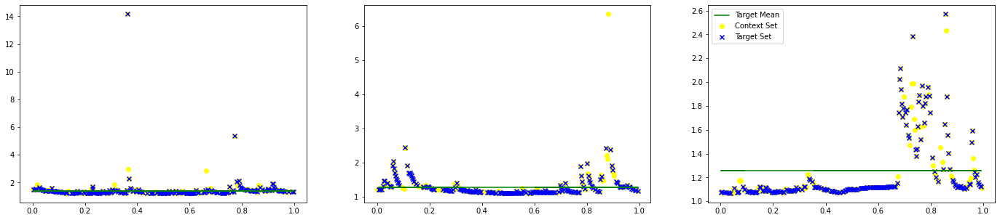

In [18]:
gen = convcnp.data_hydro_2_extended.HydroGenerator(
                                            dataframe=df_train,
                                            df_att = df_att,
                                            batch_size = 16*2,
                                            num_tasks = 256,
                                            channels_c = context_channels,
                                            channels_t = target_channels,
                                            channels_att = attributes,
                                            channels_t_val = target_val_channel,
                                            context_mask = context_mask,
                                            target_mask = target_mask,
                                            extrapolate = extrapolate_flag,
                                            timeslice = timeslice,
                                            dropout_rate = 0.3,
                                            concat_static_features = concat_static_features,
                                            min_train_points=min_train_points,
                                            min_test_points=min_test_points,
                                            max_train_points=max_train_points,
                                            max_test_points=max_test_points,
                                            device='cpu',
                                            )
        

task = gen.generate_task()
fig = plt.figure(figsize=(24, 5))
for i in range(3):
    plt.subplot(1, 3, i + 1)
    plot_task(task, i, legend=i==2)
plt.show()

## Training Methods

With our model in place, let's next define a training procedure. The `train` function below performs one training epoch (as defined by the number of tasks in an epoch from our data generator) as follows:
1. Iterate over the tasks in the epoch
2. For every task, condition on the context set, and make (Gaussian) predictions at the target locations.
3. Compute the log-likelihood of the predictions under the target set.
4. Backpropagate the error from the (negative) log-likelihood to the model parameters 

The `RunningAverage` average object will maintain a running average of the negative log-likelihood. In addition, we provide a plotting function so as to visually monitor the progress of the training procedure.

In [19]:
import importlib
importlib.reload(convcnp.transformations)
from convcnp.transformations import *

In [20]:
def rev_transform(x,a=0,b=0):
    #return x
    #return rev_log_transform(x-1,e=1)
    #return rev_normalise(x-1,q_min,q_max)
    return rev_standardise(x-Q_shift,q_mu,q_sigma)
    #return rev_log_transform(x,e=1)
    #return rev_normalise(rev_log_transform(x-1,e=1), q_min, q_max)
    #return rev_log_transform(x+Q_shift-1,e=1)
    #return rev_boxcox_transform(x,ld=lambda_OBS_RUN)

def rev_transform_tensor(x,a=0,b=0):
    #return x
    #return torch.exp(x-1)-1
    #return torch.exp(x)-1
    #return rev_normalise(x-1,q_min,q_max)
    return rev_standardise(torch.exp(x)-Q_shift,q_mu,q_sigma)
    #return rev_standardise(x-1,q_mu,q_sigma)
    #return torch.exp(x+Q_shift-1)-1
    #return rev_normalise(torch.exp(x-1)-1, q_min, q_max)
    #return rev_boxcox_transform_tensor(x,ld=lambda_OBS_RUN)

In [21]:
def task_to_device(task,device='cuda'):
    for k in task.keys():
        task[k] = task[k].to(device)
    return task

def loaded_task(task, device='cuda'):
    if len(task['x'].shape)==4:
        for k in task.keys():
            if task[k].device==device:
                task[k] = task[k].reshape(task[k].shape[1:])
            else:
                task[k] = task[k].reshape(task[k].shape[1:]).to(device)
    else:
        for k in task.keys():
            if task[k].device==device:
                pass
            else:
                task[k] = task[k].to(device)
    return task

def try_to_delete(var_list):
    for var in var_list:
        if var in globals():
            print(f"{var} deleted")
            del var
        else:
            print(f"{var} does not exist")

In [22]:
import scipy.stats

def train(data, model, opt, dist='gaussian'):
    #Perform a training epoch.
    ravg = RunningAverage()
    ravg_nse = RunningAverage() 
    model.train()
    start_1 = time.time()
    task_obj_list = []
    
    for step, task in enumerate(data):
        
        torch.cuda.empty_cache()
        task = loaded_task(task)
        
        y_loc, y_scale = model(task['x_context'], task['y_context'], task['x_target'], task['y_att'], 
                               task['feature'], task['m'], 
                               static_masking_rate=static_masking_rate, 
                               embedding=feature_embedding_flag)  
        
        if dist == 'gaussian':
            y_mean, y_std = y_loc, y_scale
            obj = -gaussian_logpdf(task['y_target'], y_loc, y_scale, 'batched_mean')
        elif dist == 'gamma':
            y_mean, y_std = gamma_stats(y_loc, y_scale)
            obj = -gamma_logpdf(task['y_target'], y_loc, y_scale, 'batched_mean')
        
        obj.backward()
        opt.step()
        opt.zero_grad()
              
        obj_nse = NSE.nse_tensor(rev_transform_tensor(task['y_target']),rev_transform_tensor(task['y_target_val']),rev_transform_tensor(y_mean))
        task_obj_list.append(obj)
        ravg.update(obj.item(), data.batch_size)
        ravg_nse.update(obj_nse.item(), data.batch_size)
        
        if step % 100 == 0:
            print("step %s -- avg training loss is %.3f" % (step, ravg.avg)) 
            
    plt.plot(task_obj_list)
    plt.show
        
    return ravg.avg, ravg_nse.avg

In [23]:
# Create a fixed set of outputs to predict at when plotting.
x_test = torch.linspace(0., 1.,timeslice)[None, :, None].to(device)


def plot_model_task(model, task, timeslice, idx, legend, dist='gaussian', feature_embedding_flag=True):
    num_functions = task['x_context'].shape[0]
    x_test = torch.linspace(0., 1.,timeslice)[None, :, None].to(device)
    
    # Make predictions with the model.
    model.eval()
    with torch.no_grad():
        y_loc, y_scale = model(task['x_context'], 
                               task['y_context'], 
                               x_test.repeat(num_functions, 1, 1), 
                               task['y_att'], 
                               task['feature'],
                               task['m'],
                               embedding=feature_embedding_flag)
        
        #y_loc_NSE, y_scale_NSE = model(task['x_context'], task['y_context'], task['x_target'], task['y_att'], task['feature'], task['m'], embedding=feature_embedding_flag)

    # Plot the task and the model predictions.
    x_context, y_context = to_numpy(task['x_context'][idx]), to_numpy(task['y_context'][idx][:,0])
    x_target, y_target = to_numpy(task['x_target'][idx]), to_numpy(task['y_target'][idx][:,0])
    #y_mean_NSE, y_std_NSE = to_numpy(y_mean_NSE[idx][:,0]), to_numpy(y_std_NSE[idx][:,0])
    y_target_val = to_numpy(task['y_target_val'][idx][:,0])
    
    if dist == 'gaussian':
        y_mean, y_std = y_loc, y_scale
        y_mean, y_std = to_numpy(y_mean[idx][:,0]), to_numpy(y_std[idx][:,0])
        p05, p95 = y_mean + 2 * y_std, y_mean - 2 * y_std
        #y_mean_NSE, y_std_NSE = y_loc_NSE, y_scale_NSE
    elif dist == 'gamma':
        y_mean, y_std = gamma_stats(y_loc, y_scale)
        y_mean, y_std = to_numpy(y_mean[idx][:,0]), to_numpy(y_std[idx][:,0])
        y_loc, y_scale = to_numpy(y_loc[idx][:,0]), to_numpy(y_scale[idx][:,0])        
        p05 = scipy.stats.gamma.ppf(0.05, y_loc, 0, 1/y_scale)
        p95 = scipy.stats.gamma.ppf(0.95, y_loc, 0, 1/y_scale)
        #y_mean_NSE, y_std_NSE = gamma_stats(y_loc_NSE, y_scale_NSE)

    #nse = NSE.nse(rev_transform(y_target), rev_transform(y_target_val), rev_transform(y_mean_NSE))
    #log_nse = NSE.nse(y_mean_NSE, y_target_val, y_target)
    
    x_context = x_context*timeslice
    x_target = x_target*timeslice
    x_test = to_numpy(x_test[0,:,0])*timeslice
    
    plt.scatter(x_context, rev_transform(y_context), label='Context Set', color='black')
    plt.scatter(x_target, rev_transform(y_target), label='Target Set', color='red')
    #plt.scatter(x_target, rev_transform(y_mean_NSE), label='Target Predictions', color='orange')
    plt.plot(x_target, rev_transform(y_target_val), label='Target Mean', color='green')

    # Plot model predictions.
    plt.plot(x_test, rev_transform(y_mean), label='Model Output', color='blue')
    plt.fill_between(x_test,
                     rev_transform(p95),
                     rev_transform(p05),
                     color='tab:blue', alpha=0.2)
        
    #plt.title("NSE(1): %.3f " % nse)
    #plt.xlabel("Q")
    #plt.ylabel("y-label")
        
    if legend:
        plt.legend()

In [24]:
# Instantiate data generator for testing.
NUM_TEST_TASKS = 128
gen_test = convcnp.data_hydro_2_extended.HydroGenerator(
                                            dataframe=df_test_both,
                                            df_att = df_att,
                                            batch_size = 16*2,
                                            num_tasks = NUM_TEST_TASKS,
                                            channels_c = context_channels,
                                            channels_t = target_channels,
                                            channels_att = attributes,
                                            channels_t_val = target_val_channel,
                                            context_mask = context_mask,
                                            target_mask = target_mask,
                                            extrapolate = False,
                                            concat_static_features=concat_static_features,
                                            timeslice = timeslice,
                                            min_train_points=min_train_points,
                                            min_test_points=min_test_points,
                                            max_train_points=max_train_points,
                                            max_test_points=max_test_points,
                                            device = 'cpu'
                                            )

In [25]:
# Instantiate data generator for validation.
NUM_TEST_TASKS = 128
gen_val = convcnp.data_hydro_2_extended.HydroGenerator(
                                            dataframe=df_test_catchment,
                                            df_att = df_att,
                                            batch_size = 16*2,
                                            num_tasks = NUM_TEST_TASKS,
                                            channels_c = context_channels,
                                            channels_t = target_channels,
                                            channels_att = attributes,
                                            channels_t_val = target_val_channel,
                                            context_mask = context_mask,
                                            target_mask = target_mask,
                                            extrapolate = False,
                                            concat_static_features=concat_static_features,
                                            timeslice = timeslice,
                                            min_train_points=min_train_points,
                                            min_test_points=min_test_points,
                                            max_train_points=max_train_points,
                                            max_test_points=max_test_points,
                                            device = 'cpu'
                                            )

In [26]:
def get_batch_size(x):
    if x.__class__ == 'torch.utils.data.dataloader.DataLoader':
        return x.dataset.gen.batch_size
    else:
        return x.batch_size

In [27]:
def test(gen_test,model,dist='gaussian',fig_flag=False):
    # Compute average task log-likelihood.
    ravg = RunningAverage()
    ravg_nse = RunningAverage()
    
    model.eval()
    start = time.time()
    
    with torch.no_grad():
        for step, task in enumerate(gen_test):
            torch.cuda.empty_cache()
            task = loaded_task(task)
            y_loc, y_scale = model(task['x_context'], task['y_context'], task['x_target'], task['y_att'], 
                                   task['feature'], task['m'], 
                                   static_masking_rate = static_masking_rate,
                                   embedding=feature_embedding_flag)        
            if dist == 'gaussian':
                y_mean, y_std = y_loc, y_scale
                obj = -gaussian_logpdf(task['y_target'], y_loc, y_scale, 'batched_mean')
            elif dist == 'gamma':
                y_mean, y_std = gamma_stats(y_loc, y_scale)
                obj = -gamma_logpdf(task['y_target'], y_loc, y_scale, 'batched_mean')
            
            batch_size = get_batch_size(gen_test)
            
            obj_nse = NSE.nse_tensor(rev_transform_tensor(task['y_target']),rev_transform_tensor(task['y_target_val']),rev_transform_tensor(y_mean))        
            ravg.update(obj.item(), batch_size)
            #print(batch_size)
            ravg_nse.update(obj_nse.item(), batch_size)

    if fig_flag:
        fig = plt.figure(figsize=(24, 15))
        for i in range(3):
            plt.subplot(3, 1, i + 1)
            plot_model_task(model, task, timeslice, idx=i, legend=i==2, dist=dist)
        plt.show()

        elapsed = time.time() - start        
        print('Test NLL: %.3f -- NSE: %.3f -- time: %.3f' % (ravg.avg, ravg_nse.avg, elapsed))
    
    return ravg.avg


## Training loop for the model

Now we can write a standard PyTorch optimization loop. First, we instantiate an optimizer (here we use an Adam optimizer). Then, we simply iterate for as many epochs as necessary to train the model. Every so often we will print the training error (since the data are generated on the fly, this is also a reasonable estimator for the held out error), and produce a plot demonstrating the model performance. Note that the next block of code will train the model for 100 epochs. This may take some time, and it is highly recommended to do so with a GPU!

In [28]:
importlib.reload(convcnp.convcnp_architectures)
from convcnp.convcnp_architectures import *

importlib.reload(convcnp.plot_utils)
from convcnp.plot_utils import *

from IPython import display
from convcnp.experiment import *

In [29]:
change_folder = True

if change_folder:
    experiment_name = 'k5fold_01_gamma_staticfs_after-encoder_Unet'
    wd = WorkingDirectory(generate_root(experiment_name))

Root: _experiments/2020-08-02_10-52-54_k5fold-01-gamma-staticfs-after-encoder-unet


In [30]:
load_model = True
load_dict = True

load_root = '_experiments/2020-08-01_22-10-37_k5fold-01-gamma-staticfs-after-encoder-unet'

if load_model:
    PATH = f'{load_root}/model_best.pth.tar'
    #PATH = f'{load_root}/e_61_loss_151.753.pth.tar'
    model.load_state_dict(torch.load(PATH))
    
if load_dict:
    a_file = open(os.path.join(load_root,"loss_dict.pkl"), "rb")
    loss_dict = pickle.load(a_file)
    a_file.close()
    
    epoch_list = loss_dict['epochs']
    train_obj_list = loss_dict['training_loss'] 
    train_nse_list = loss_dict['training_nse'] 
    test_obj_list = loss_dict['test_loss'] 

In [36]:
reset_epochs = True

if reset_epochs:
    train_obj_list, train_nse_list, test_obj_list, epoch_list = [], [], [], []

In [37]:
torch.cuda.empty_cache()
try_to_delete(['task','minitask'])

task deleted
minitask does not exist


In [38]:
importlib.reload(convcnp.data_loader_pytorch)
from convcnp.data_loader_pytorch import *

gen.batch_size = 16*2
gen_val.batch_size = 16*2
gen_test.batch_size = 16*2

gen.dropout_rate = 0
gen_val.dropout_rate = 0
gen_test.dropout_rate = 0
static_masking_rate = 0

train_dataloader = DataLoader(dataset=HydroDataset(gen,num_tasks_epoch=256), batch_size=1, num_workers=8, shuffle=False, pin_memory=True)
test_dataloader = DataLoader(dataset=HydroDataset(gen_test,num_tasks_epoch=256), batch_size=1, num_workers=8, shuffle=False, pin_memory=True)
val_dataloader = DataLoader(dataset=HydroDataset(gen_val,num_tasks_epoch=256), batch_size=1, num_workers=8, shuffle=False, pin_memory=True)

In [39]:
load_best = False
if load_best:
    model.load_state_dict(torch.load(os.path.join(wd.root,'model_best.pth.tar')))

Traceback (most recent call last):
  File "/home/donal/miniconda3/lib/python3.7/multiprocessing/queues.py", line 232, in _feed
    close()
  File "/home/donal/miniconda3/lib/python3.7/multiprocessing/connection.py", line 177, in close
    self._close()
  File "/home/donal/miniconda3/lib/python3.7/multiprocessing/connection.py", line 361, in _close
    _close(self._handle)
OSError: [Errno 9] Bad file descriptor


step 0 -- avg training loss is -152.608
step 100 -- avg training loss is -93.673
step 200 -- avg training loss is -89.827
Epoch 102 ¦ train NLL: -87.895 ¦ test NLL: -95.741 ¦ train NSE: nan ¦ time: 363.688
Epoch 102 ¦ train NLL: -87.895 ¦ test NLL: -95.741 ¦ train NSE: nan ¦ time: 363.688


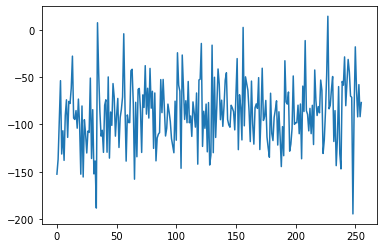

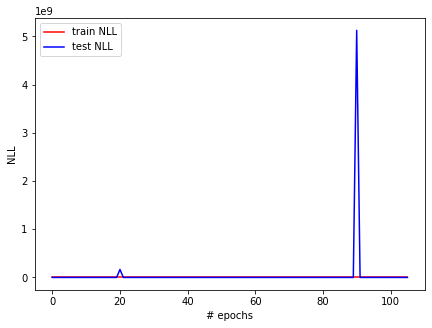

step 0 -- avg training loss is -96.449
step 100 -- avg training loss is -90.841
step 200 -- avg training loss is -85.903
Epoch 103 ¦ train NLL: -87.562 ¦ test NLL: -98.920 ¦ train NSE: nan ¦ time: 361.578
Epoch 103 ¦ train NLL: -87.562 ¦ test NLL: -98.920 ¦ train NSE: nan ¦ time: 361.578


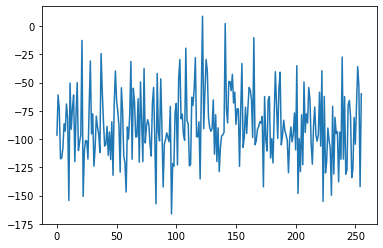

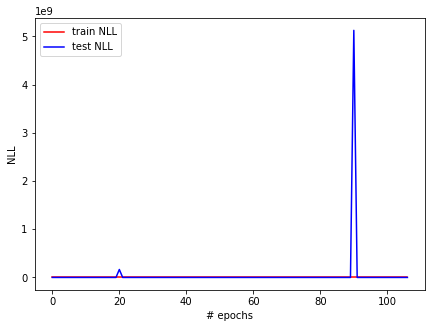

step 0 -- avg training loss is -64.957
step 100 -- avg training loss is -85.861


KeyboardInterrupt: 

In [66]:
torch.autograd.set_detect_anomaly(False)

# Some training hyper-parameters:
LEARNING_RATE = 1e-3
NUM_EPOCHS = 500
PLOT_FREQ = 1

plot_model = False

if len(epoch_list)>0:
    last_epoch = epoch_list[-1]
else:
    last_epoch = 0

# Initialize optimizer
opt = torch.optim.Adam(model.parameters(), lr=LEARNING_RATE)

# Run the training loop.
for epoch in range(NUM_EPOCHS):
    # Compute training objective.
    start_time = time.time()
    train_obj, train_nse = train(gen, model, opt, dist=dist)

    epoch_list.append(epoch+last_epoch)
    train_obj_list.append(train_obj)
    train_nse_list.append(train_nse)
    
    torch.cuda.empty_cache()
    test_obj = test(gen_val,model,dist=dist)
    torch.cuda.empty_cache()
    test_obj_list.append(test_obj)
    
    elapsed = time.time() - start_time
    
    print('Epoch %s ¦ train NLL: %.3f ¦ test NLL: %.3f ¦ train NSE: %.3f ¦ time: %.3f' % (epoch+last_epoch, train_obj, test_obj, train_nse, elapsed))

    # Plot model behaviour every now and again.
    if (epoch % PLOT_FREQ == 0) and plot_model:
        task = task_to_device(gen_val.generate_task())
        fig = plt.figure(figsize=(24, 5))
        for i in range(1):
            plt.subplot(1, 1, i + 1)
            plot_model_task(model, task, timeslice=timeslice, idx=i, legend=i==2, dist=dist)
        plt.title('Test set')
        display.clear_output(wait=True)
        #display.display(plt.gcf())
        #plot training loss

    print('Epoch %s ¦ train NLL: %.3f ¦ test NLL: %.3f ¦ train NSE: %.3f ¦ time: %.3f' % (epoch + last_epoch, train_obj, test_obj, train_nse, elapsed))
    torch.cuda.empty_cache()
    plot_training_loss(train_obj_list, test_obj_list)
    plt.show()
    
    save_as_best = True if test_obj == min(test_obj_list) else False
    save_checkpoint(wd,model.state_dict(),is_best=save_as_best)
    
    PATH = os.path.join(wd.root,'e_%s_loss_%.3f.pth.tar' % (epoch + last_epoch, test_obj))
    torch.save(model.state_dict(), PATH)

In [67]:
save_dict = True

if save_dict:
    model_hyperparams={}
    model_hyperparams['lr'] = LEARNING_RATE
    model_hyperparams['distribution'] = dist
    model_hyperparams['train_batch_size'] = gen.batch_size
    model_hyperparams['batches_per_epoch'] = train_dataloader.dataset.num_tasks_epoch
    model_hyperparams['static_masking_rate'] = static_masking_rate
    model_hyperparams['dynamic masking rate'] = gen.dropout_rate
    model_hyperparams['static_embedding_dims'] = static_embedding_dims
    model_hyperparams['dynamic_embedding_dims'] = dynamic_embedding_dims

    a_file = open(os.path.join(wd.root,"model_hyperparams.pkl"), "wb")
    pickle.dump(model_hyperparams, a_file)
    a_file.close()
    print('Saved successfuly')


Saved successfuly


In [68]:
save_dict = True

if save_dict:
    loss_dict={}
    loss_dict['epochs'] = epoch_list
    loss_dict['training_loss'] = train_obj_list
    loss_dict['training_nse'] = train_nse_list
    loss_dict['test_loss'] = test_obj_list

    a_file = open(os.path.join(wd.root,"loss_dict.pkl"), "wb")
    pickle.dump(loss_dict, a_file)
    a_file.close()
    print('Saved successfuly')
    

Saved successfuly


(-100.0, 100.0)

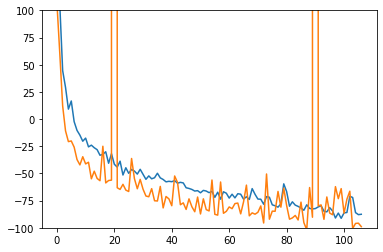

In [69]:
plt.plot(train_obj_list)
plt.plot(test_obj_list)
plt.ylim([-100,100])

## Test model

In [46]:
#ROOT_PATH = '_experiments/2020-07-30_11-26-34_k5fold-01-gaussian-log-staticfs-after-encoder-unet'
#model.load_state_dict(torch.load(os.path.join(ROOT_PATH, 'model_best.pth.tar')))

In [70]:
torch.cuda.empty_cache()
try_to_delete(['task'])

task deleted


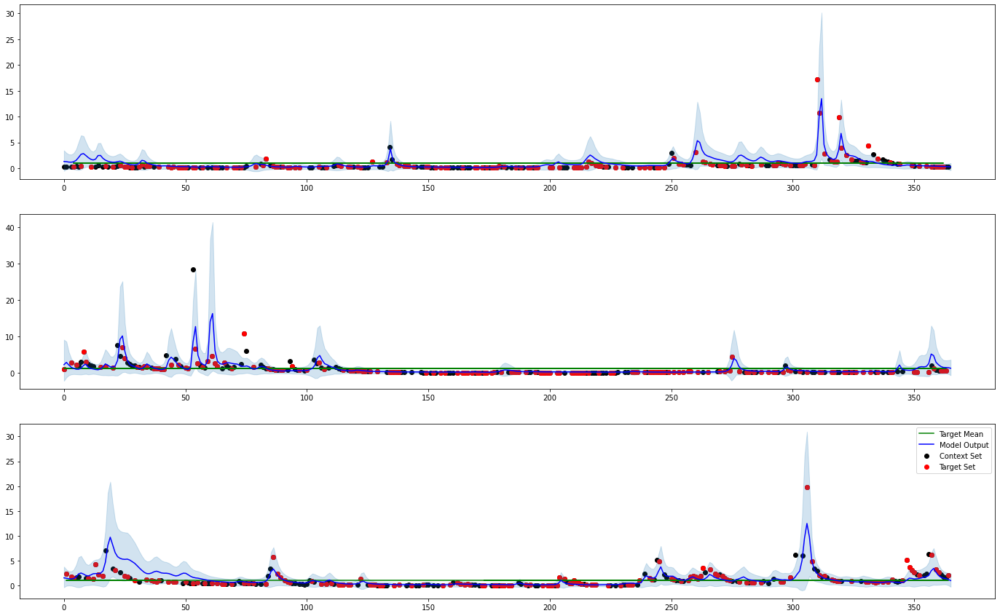

Test NLL: -28.074 -- NSE: nan -- time: 4.956


-28.073926240205765

In [53]:
gen_for_test = convcnp.data_hydro_2_extended.HydroGenerator(
                                            dataframe=df_test_both,
                                            df_att = df_att,
                                            batch_size = 16,
                                            num_tasks = 32,
                                            channels_c = context_channels,
                                            channels_t = target_channels,
                                            channels_att = attributes,
                                            channels_t_val = target_val_channel,
                                            context_mask = context_mask,
                                            target_mask = target_mask,
                                            extrapolate = extrapolate_flag,
                                            timeslice = timeslice,
                                            dropout_rate = 0,
                                            concat_static_features = False,
                                            min_train_points=min_train_points,
                                            min_test_points=min_test_points,
                                            max_train_points=max_train_points,
                                            max_test_points=max_test_points,
                                            device='cpu',
                                            )
        

tester = DataLoader(dataset=HydroDataset(gen_for_test,num_tasks_epoch=64), batch_size=1, shuffle=False, num_workers=8, pin_memory=False)
test(tester,model,dist=dist,fig_flag=True)

## Evaluation 

We can also evaluate the trained model to get better estimates of its performance. To do so, we will first introduce an additional data generator that will generate far more tasks for us. Then, we will loop over many tasks, and compute (and print) the average log-likelihood.

In [ ]:
"""%%capture
#load model
##model = TheModelClass(*args, **kwargs)
PATH = '../../saved_models/model_022.pt'
model.load_state_dict(torch.load(PATH))
model.eval()"""

In [ ]:
"""model_number = 23
save_model_name = f'model_{model_number}_{dist}_static-features_{static_embedding_location}_{s_date_tr}_to_{e_date_tr}'
save_model_name"""

In [ ]:
"""PATH = r'..\..\saved_models\model_022.pt'
torch.save(model.state_dict(),PATH)"""

In [40]:
ROOT_PATH = '_experiments/2020-08-02_00-31-53_k5fold-01-gamma-staticfs-after-encoder-unet/'
PATH = f'{ROOT_PATH}/model_best.pth.tar'
model.load_state_dict(torch.load(PATH))

<All keys matched successfully>

## Test NSE performance at 365/1-day ahead task

In [60]:
importlib.reload(convcnp.data_hydro_2_extended)
from convcnp.data_hydro_2_extended import *
importlib.reload(NSE)
from metrics import *
import scipy.stats
df_test = df_test_temporal
importlib.reload(convcnp.data_loader_pytorch)
from convcnp.data_loader_pytorch import *
torch.cuda.empty_cache()

In [140]:
var_list = ['minitask','task']
try_to_delete(var_list)

minitask deleted
task deleted


424


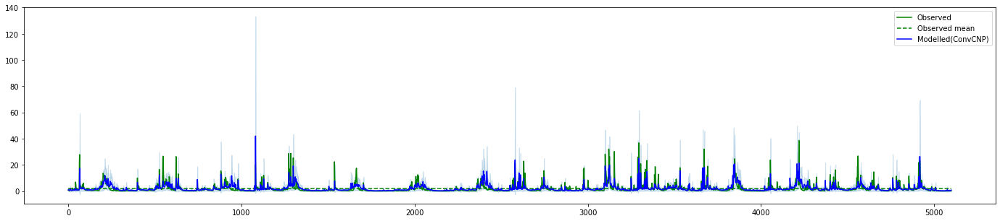

1. Basin hru_01031500 (period: 1996-2010): LL=0.002 -- NSE=0.237 -- time=20.112


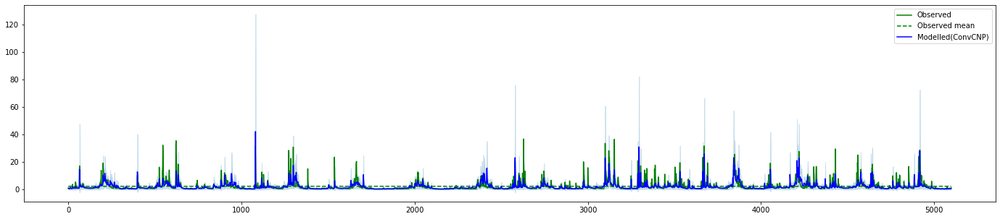

2. Basin hru_01047000 (period: 1996-2010): LL=0.002 -- NSE=0.199 -- time=20.111


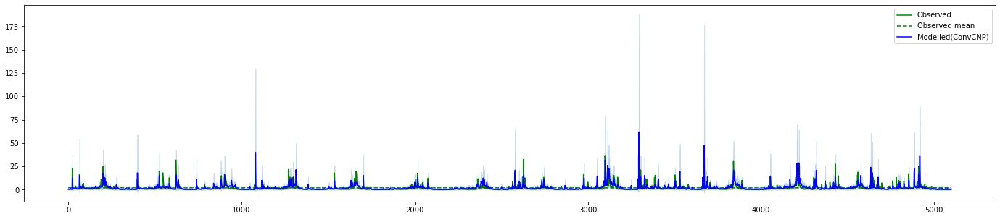

3. Basin hru_01057000 (period: 1996-2010): LL=0.003 -- NSE=0.295 -- time=20.142


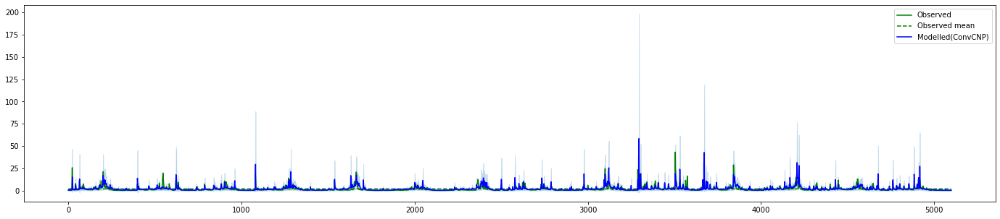

4. Basin hru_01078000 (period: 1996-2010): LL=0.005 -- NSE=0.314 -- time=20.219


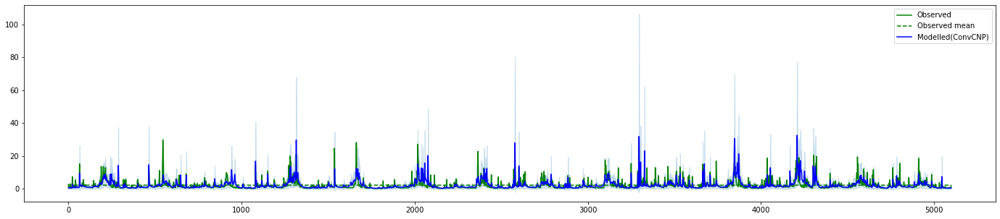

5. Basin hru_01134500 (period: 1996-2010): LL=0.001 -- NSE=0.248 -- time=20.092


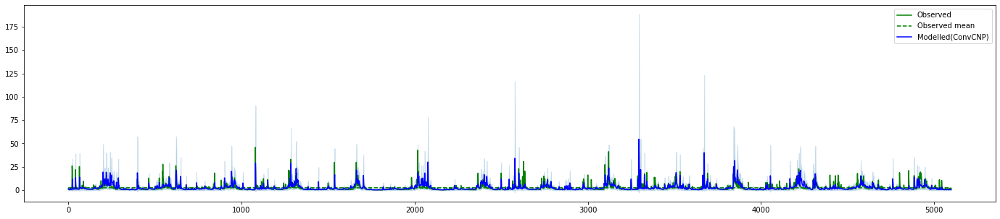

6. Basin hru_01137500 (period: 1996-2010): LL=-0.004 -- NSE=0.219 -- time=20.040


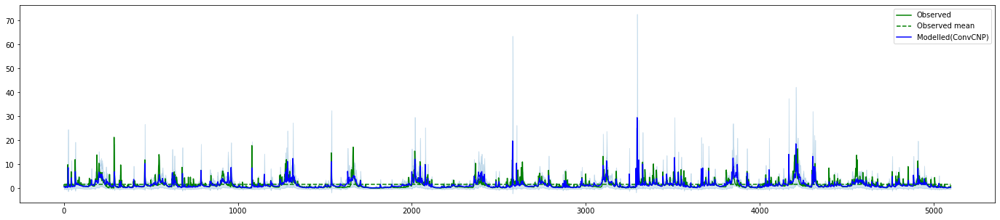

7. Basin hru_01139000 (period: 1996-2010): LL=0.006 -- NSE=0.261 -- time=20.752


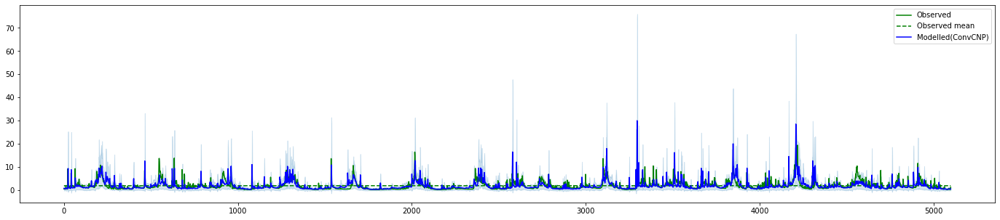

8. Basin hru_01139800 (period: 1996-2010): LL=0.001 -- NSE=0.258 -- time=19.911


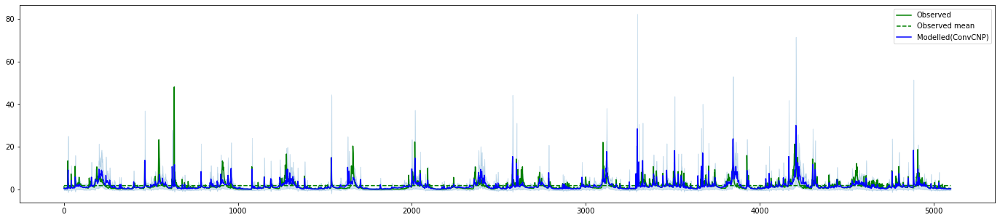

9. Basin hru_01142500 (period: 1996-2010): LL=0.003 -- NSE=0.213 -- time=20.046


/home/donal/miniconda3/lib/python3.7/site-packages/scipy/stats/_distn_infrastructure.py:881: RuntimeWarning: invalid value encountered in greater
  cond = logical_and(cond, (asarray(arg) > 0))
/home/donal/miniconda3/lib/python3.7/site-packages/scipy/stats/_distn_infrastructure.py:2016: RuntimeWarning: invalid value encountered in greater
  cond0 = self._argcheck(*args) & (scale > 0) & (loc == loc)


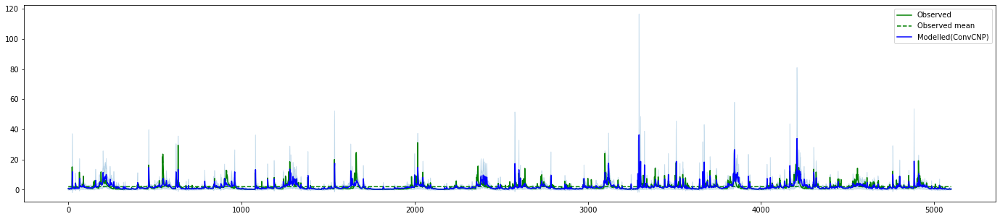

10. Basin hru_01144000 (period: 1996-2010): LL=nan -- NSE=nan -- time=20.074


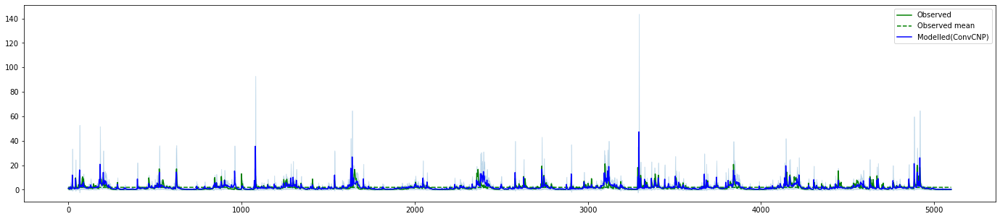

11. Basin hru_01162500 (period: 1996-2010): LL=0.003 -- NSE=0.286 -- time=20.486


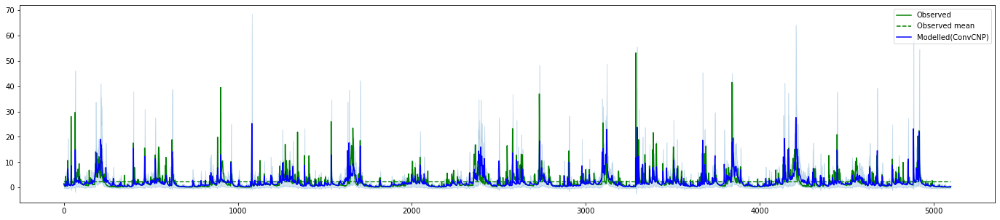

12. Basin hru_01170100 (period: 1996-2010): LL=-0.004 -- NSE=0.165 -- time=20.300


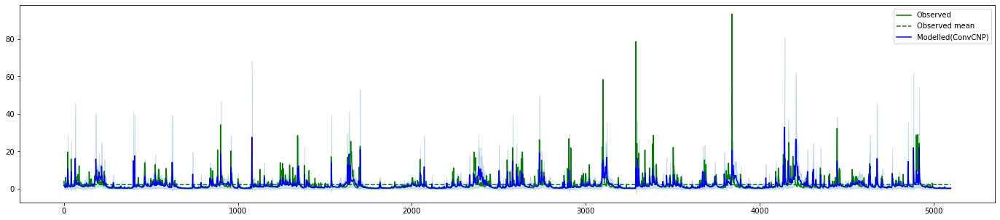

13. Basin hru_01181000 (period: 1996-2010): LL=-0.002 -- NSE=0.139 -- time=20.145


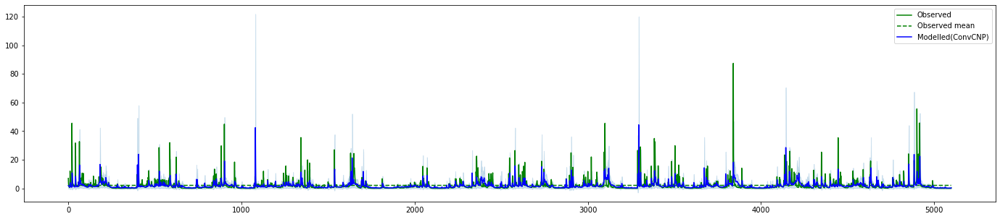

14. Basin hru_01187300 (period: 1996-2010): LL=-0.003 -- NSE=0.141 -- time=20.174


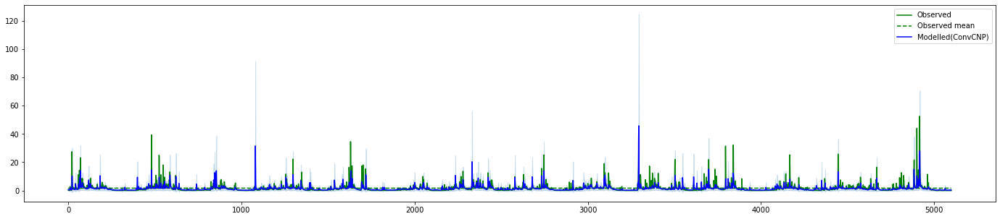

15. Basin hru_01195100 (period: 1996-2010): LL=0.005 -- NSE=0.228 -- time=19.749


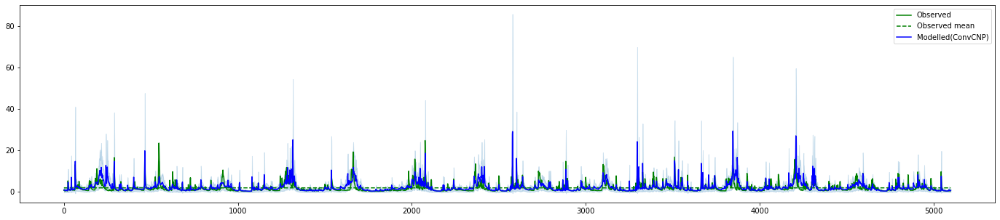

16. Basin hru_04296000 (period: 1996-2010): LL=0.003 -- NSE=0.295 -- time=20.144


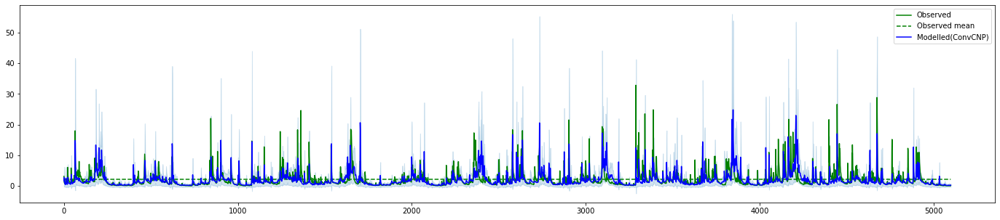

17. Basin hru_01333000 (period: 1996-2010): LL=-0.004 -- NSE=0.160 -- time=19.797


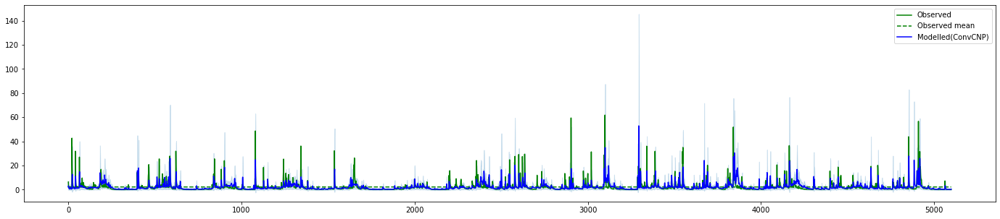

18. Basin hru_01350000 (period: 1996-2010): LL=-0.005 -- NSE=0.167 -- time=20.041


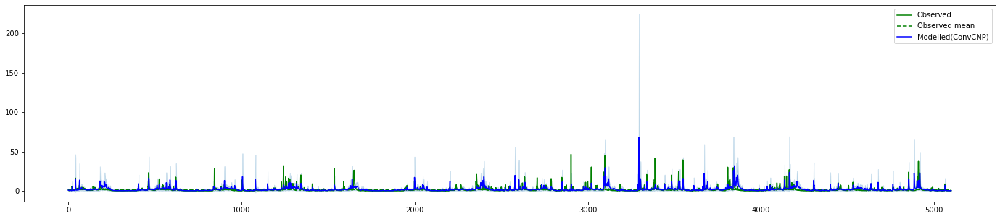

19. Basin hru_01350140 (period: 1996-2010): LL=-0.003 -- NSE=0.172 -- time=20.104


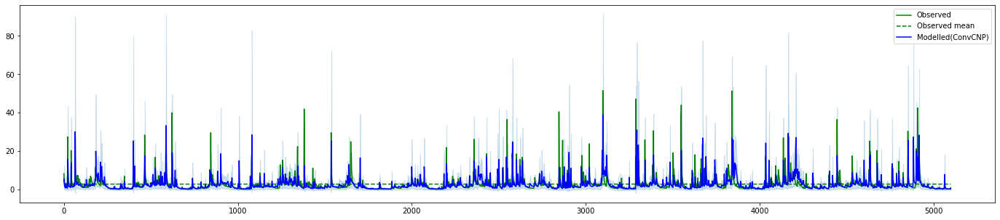

20. Basin hru_01365000 (period: 1996-2010): LL=-0.009 -- NSE=0.146 -- time=19.829


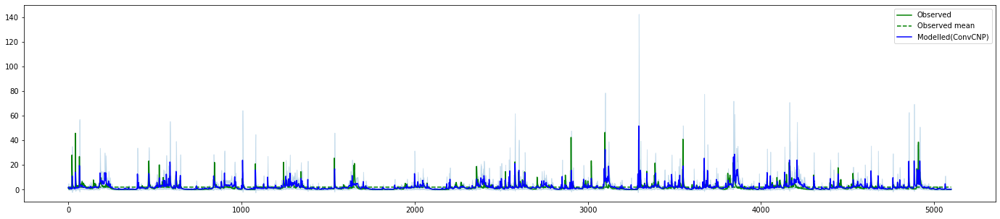

21. Basin hru_01413500 (period: 1996-2010): LL=0.000 -- NSE=0.237 -- time=20.085


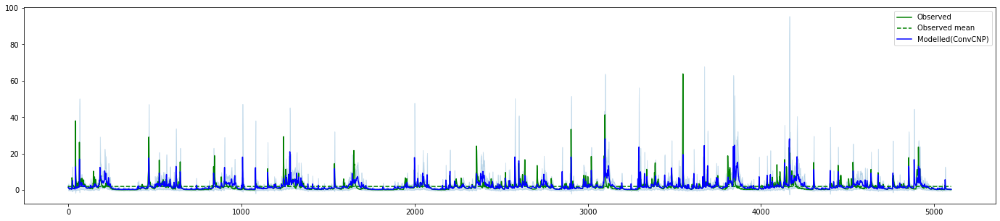

22. Basin hru_01423000 (period: 1996-2010): LL=0.001 -- NSE=0.238 -- time=20.158


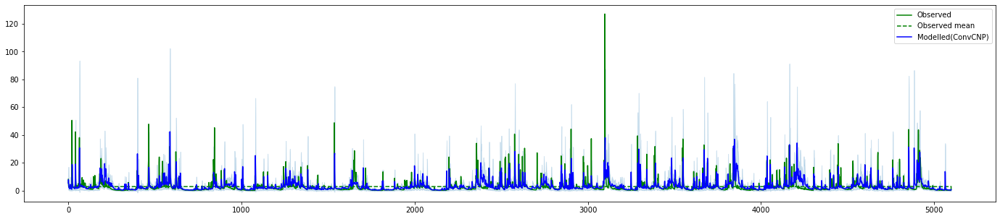

23. Basin hru_01434025 (period: 1996-2010): LL=-0.012 -- NSE=0.126 -- time=20.378


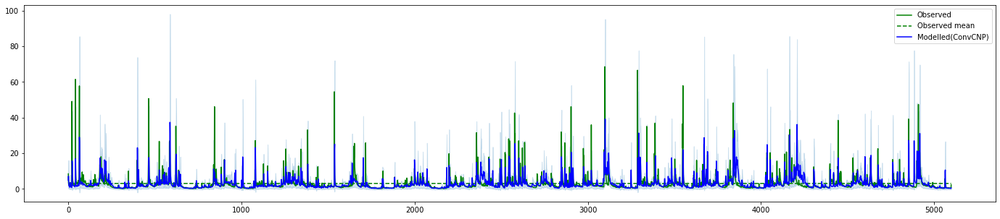

24. Basin hru_01435000 (period: 1996-2010): LL=-0.009 -- NSE=0.109 -- time=20.360


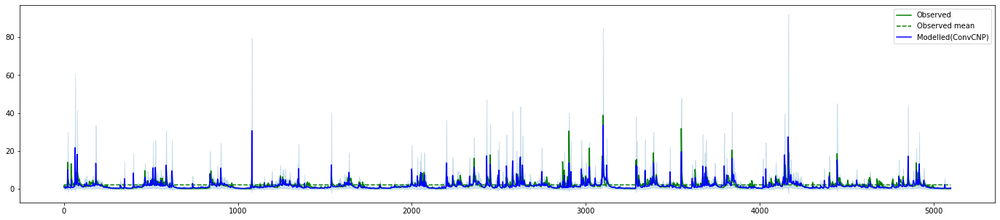

25. Basin hru_01439500 (period: 1996-2010): LL=0.000 -- NSE=0.242 -- time=20.173


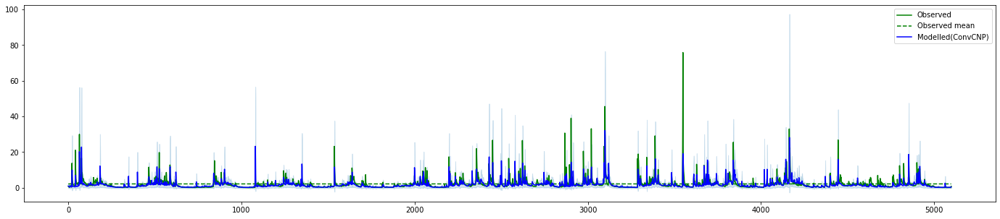

26. Basin hru_01440400 (period: 1996-2010): LL=-0.000 -- NSE=0.182 -- time=20.304


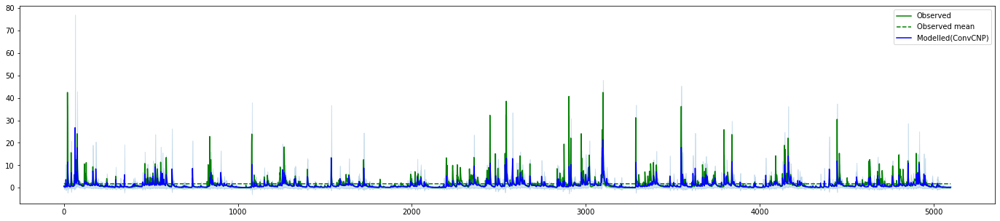

27. Basin hru_01451800 (period: 1996-2010): LL=0.001 -- NSE=0.170 -- time=20.134


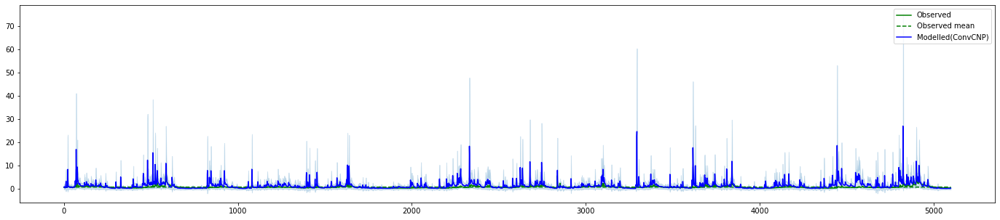

28. Basin hru_01466500 (period: 1996-2010): LL=0.011 -- NSE=-1.168 -- time=20.053


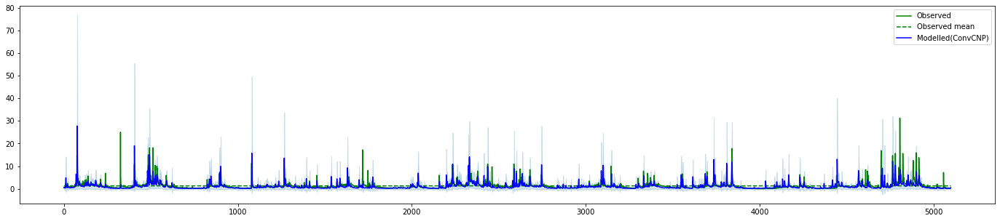

29. Basin hru_01484100 (period: 1996-2010): LL=0.008 -- NSE=0.268 -- time=20.240


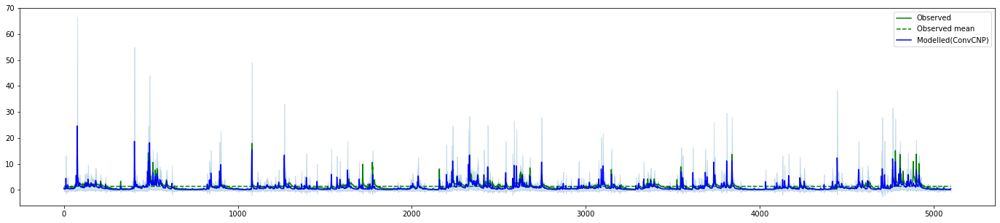

30. Basin hru_01487000 (period: 1996-2010): LL=0.006 -- NSE=0.355 -- time=20.163


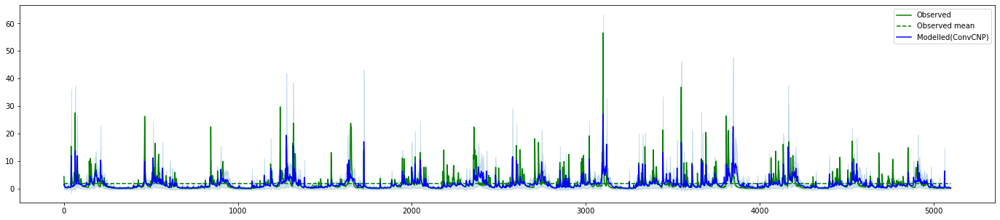

31. Basin hru_01510000 (period: 1996-2010): LL=0.001 -- NSE=0.175 -- time=20.207


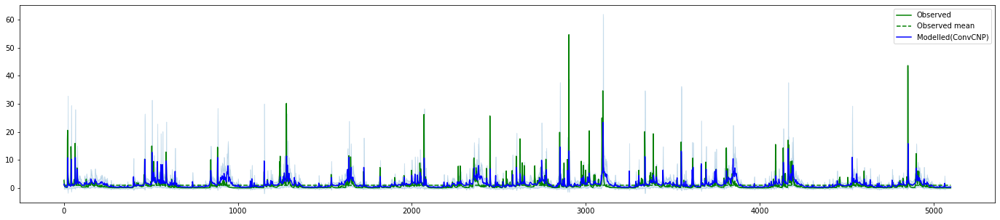

32. Basin hru_01516500 (period: 1996-2010): LL=0.002 -- NSE=0.126 -- time=20.102


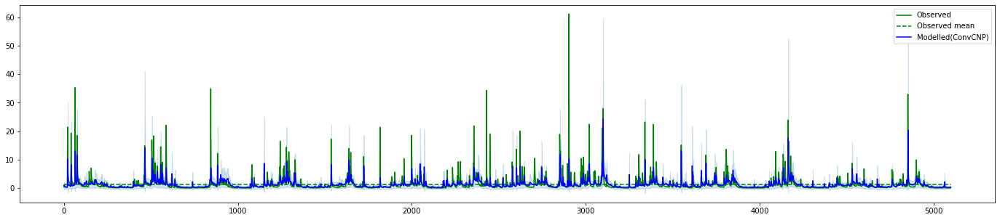

33. Basin hru_01532000 (period: 1996-2010): LL=0.005 -- NSE=0.163 -- time=20.115


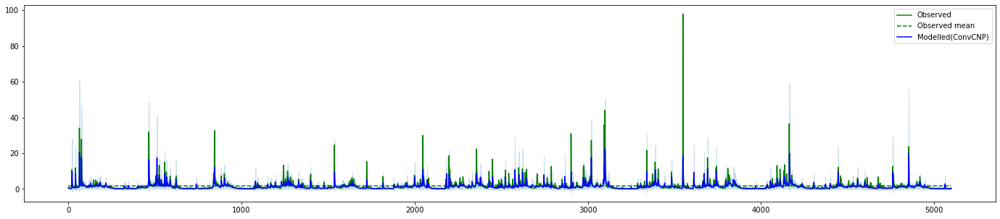

34. Basin hru_01539000 (period: 1996-2010): LL=0.007 -- NSE=0.192 -- time=20.100


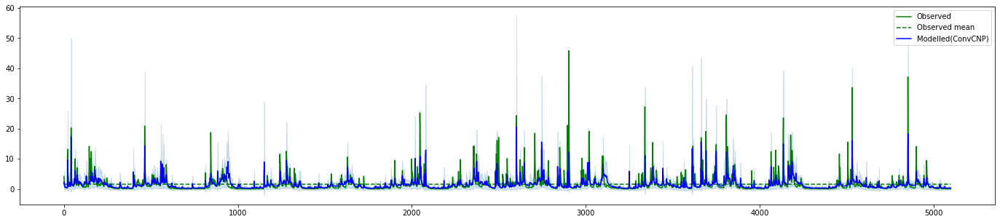

35. Basin hru_01543000 (period: 1996-2010): LL=0.005 -- NSE=0.217 -- time=20.478


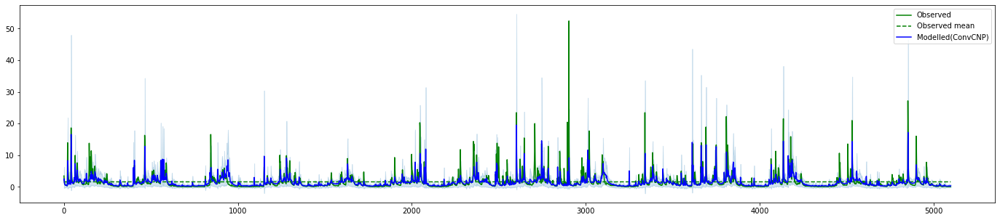

36. Basin hru_01543500 (period: 1996-2010): LL=0.006 -- NSE=0.223 -- time=19.989


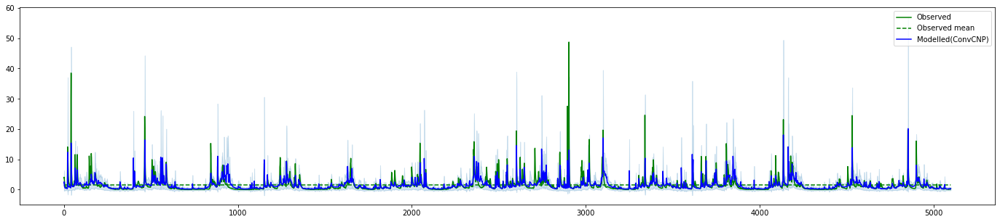

37. Basin hru_01544500 (period: 1996-2010): LL=0.006 -- NSE=0.231 -- time=19.793


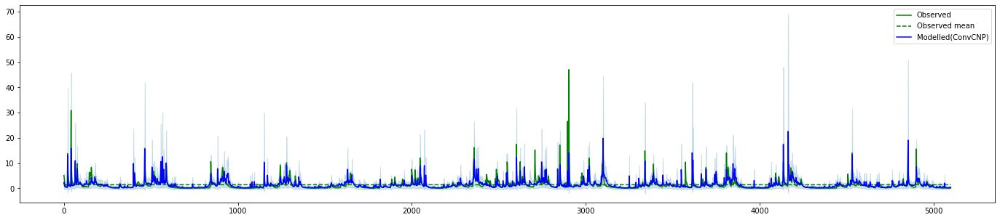

38. Basin hru_01545600 (period: 1996-2010): LL=0.007 -- NSE=0.271 -- time=20.112


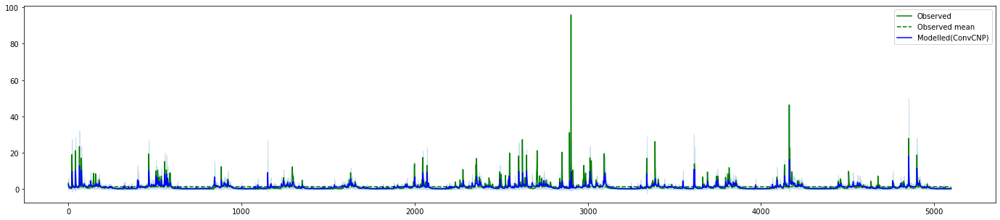

39. Basin hru_01547700 (period: 1996-2010): LL=0.007 -- NSE=0.145 -- time=20.155


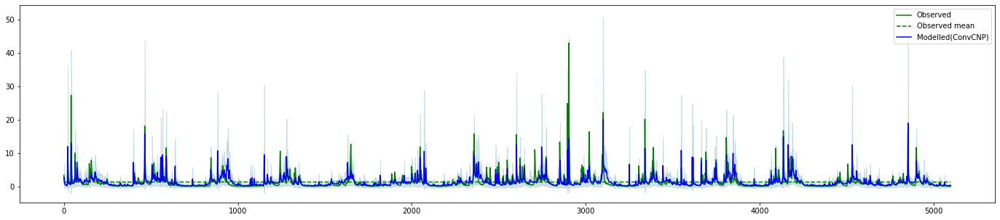

40. Basin hru_01548500 (period: 1996-2010): LL=0.009 -- NSE=0.269 -- time=20.030


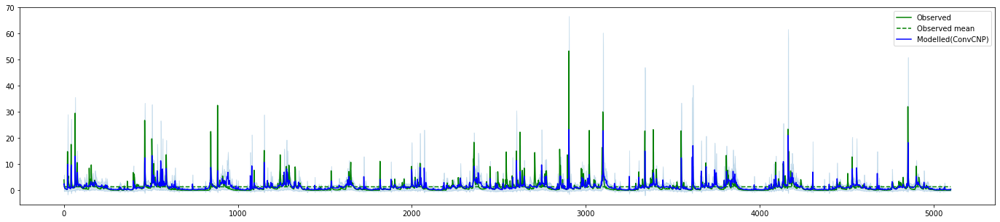

41. Basin hru_01549500 (period: 1996-2010): LL=0.005 -- NSE=0.225 -- time=20.223


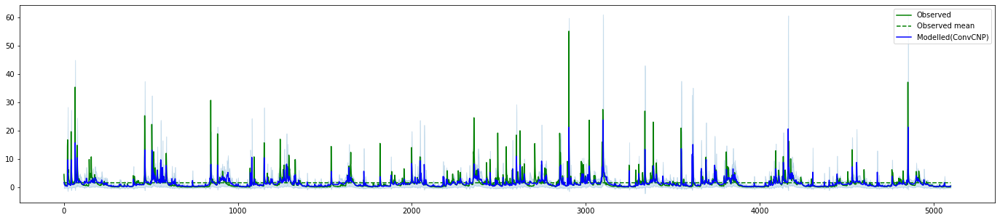

42. Basin hru_01550000 (period: 1996-2010): LL=0.006 -- NSE=0.212 -- time=20.266


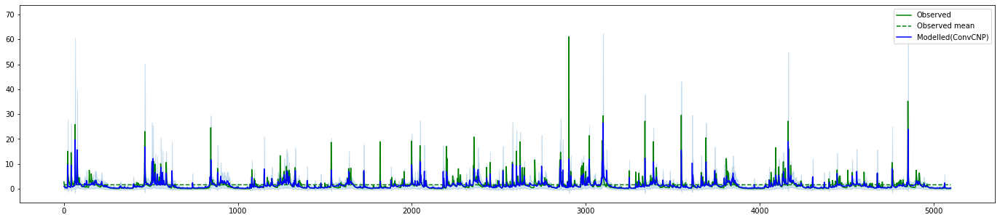

43. Basin hru_01552000 (period: 1996-2010): LL=0.007 -- NSE=0.232 -- time=20.249


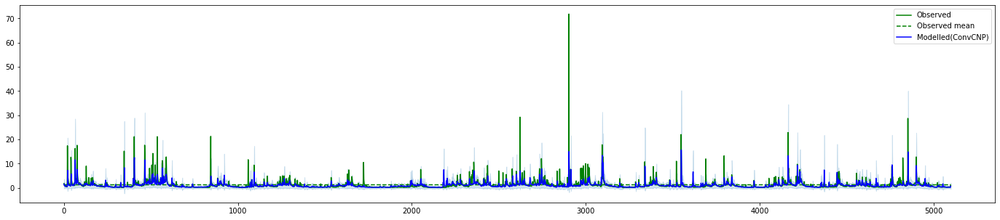

44. Basin hru_01567500 (period: 1996-2010): LL=0.008 -- NSE=0.175 -- time=20.296


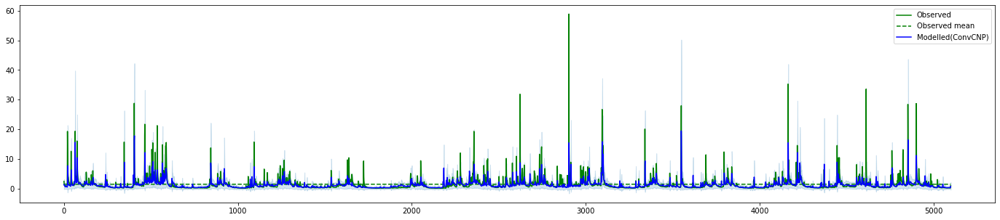

45. Basin hru_01568000 (period: 1996-2010): LL=0.009 -- NSE=0.208 -- time=20.261


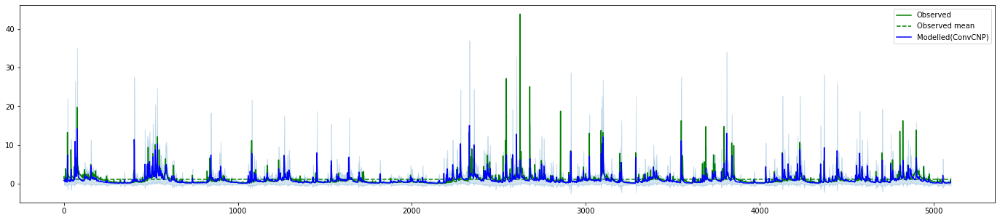

46. Basin hru_01586610 (period: 1996-2010): LL=0.012 -- NSE=0.198 -- time=20.130


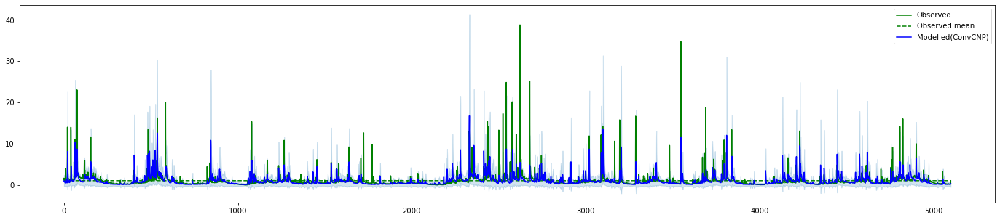

47. Basin hru_01591400 (period: 1996-2010): LL=0.011 -- NSE=0.150 -- time=20.255


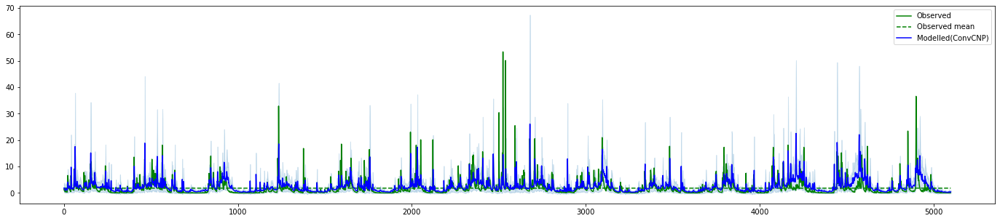

48. Basin hru_01594950 (period: 1996-2010): LL=-0.003 -- NSE=0.230 -- time=20.084


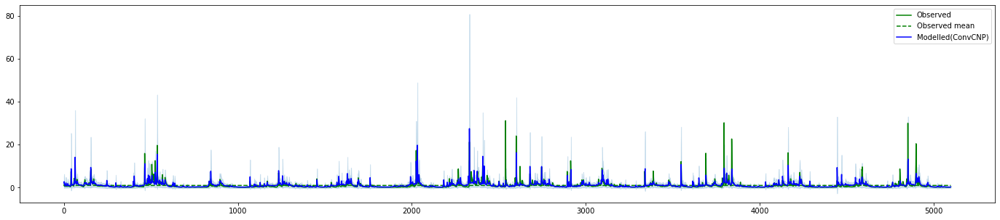

49. Basin hru_01605500 (period: 1996-2010): LL=0.014 -- NSE=0.233 -- time=20.331


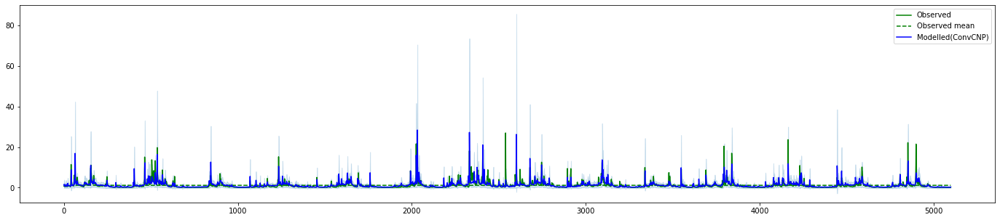

50. Basin hru_01606500 (period: 1996-2010): LL=0.012 -- NSE=0.316 -- time=20.311


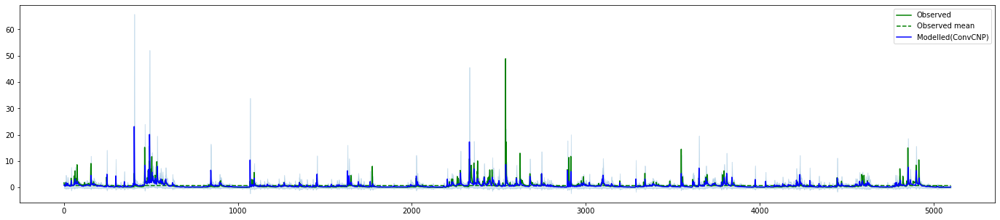

51. Basin hru_01632900 (period: 1996-2010): LL=0.019 -- NSE=0.066 -- time=20.171


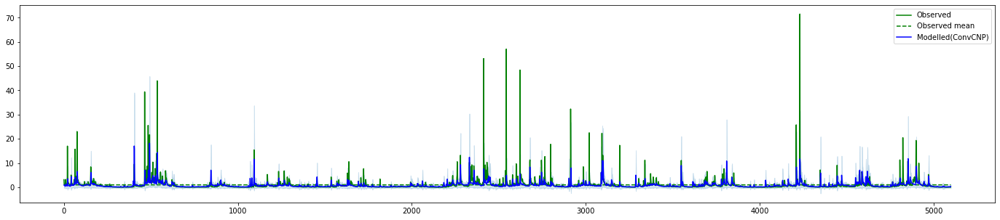

52. Basin hru_01638480 (period: 1996-2010): LL=0.011 -- NSE=0.110 -- time=20.149


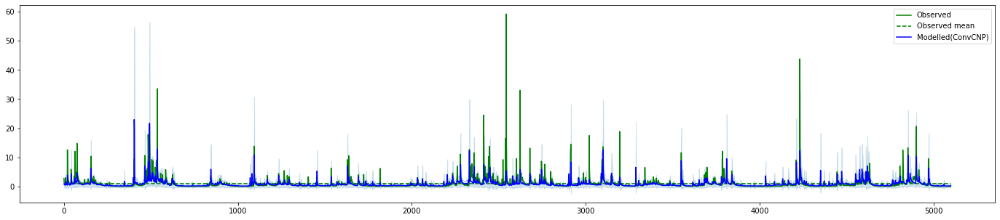

53. Basin hru_01644000 (period: 1996-2010): LL=0.014 -- NSE=0.162 -- time=20.147


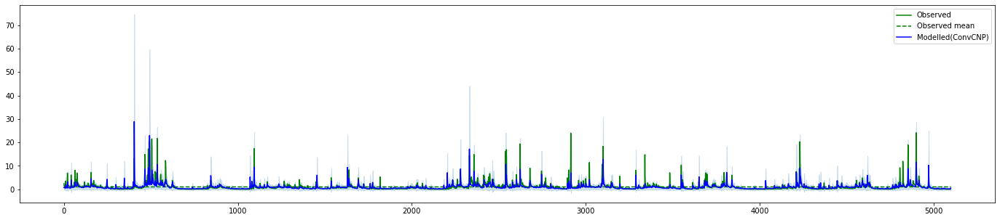

54. Basin hru_01664000 (period: 1996-2010): LL=0.015 -- NSE=0.235 -- time=20.192


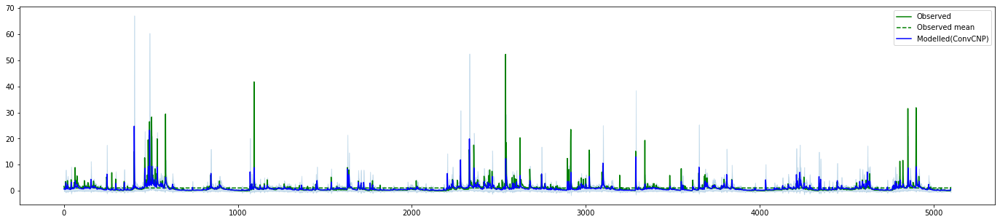

55. Basin hru_01666500 (period: 1996-2010): LL=0.013 -- NSE=0.159 -- time=20.266


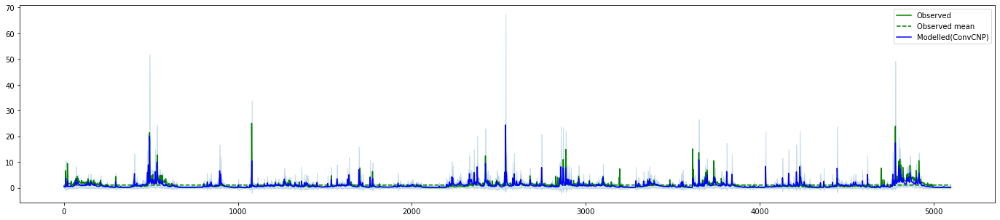

56. Basin hru_01669000 (period: 1996-2010): LL=0.014 -- NSE=0.287 -- time=20.185


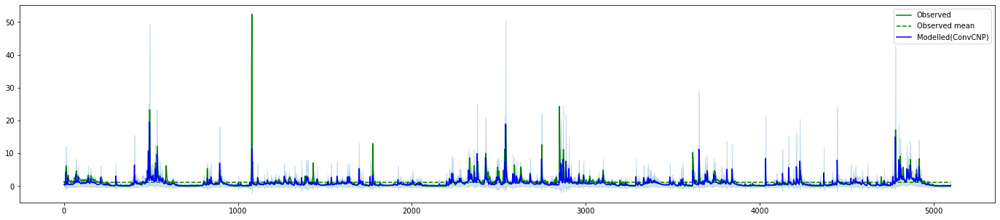

57. Basin hru_01669520 (period: 1996-2010): LL=0.011 -- NSE=0.195 -- time=20.211


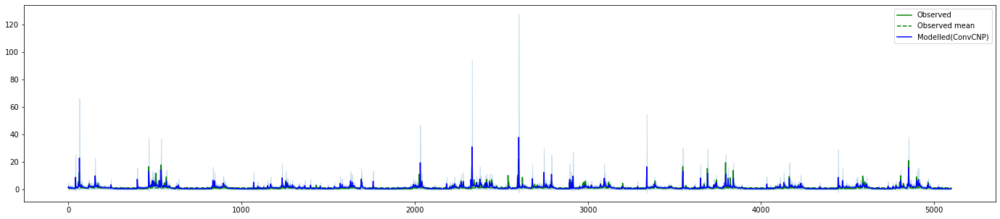

58. Basin hru_02011400 (period: 1996-2010): LL=0.014 -- NSE=0.281 -- time=20.510


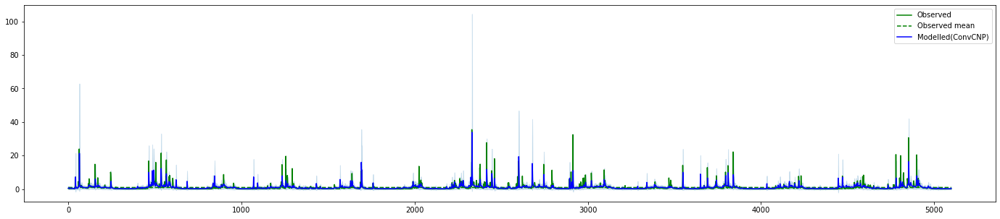

59. Basin hru_02013000 (period: 1996-2010): LL=0.011 -- NSE=0.184 -- time=20.848


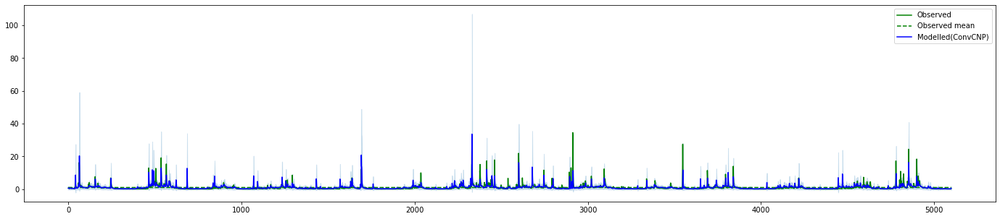

60. Basin hru_02014000 (period: 1996-2010): LL=0.014 -- NSE=0.237 -- time=20.204


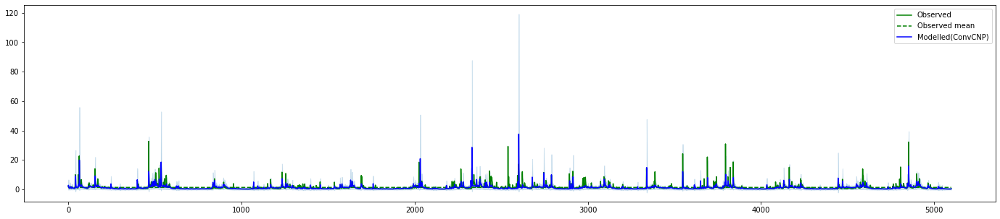

61. Basin hru_02015700 (period: 1996-2010): LL=0.011 -- NSE=0.225 -- time=20.005


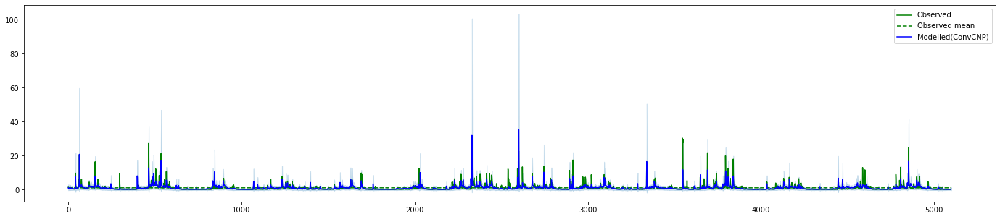

62. Basin hru_02016000 (period: 1996-2010): LL=0.014 -- NSE=0.263 -- time=20.181


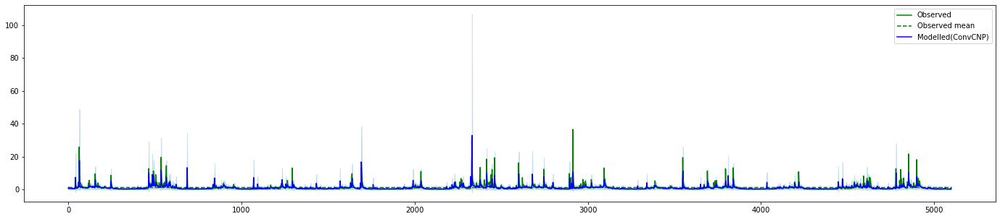

63. Basin hru_02017500 (period: 1996-2010): LL=0.013 -- NSE=0.216 -- time=20.267


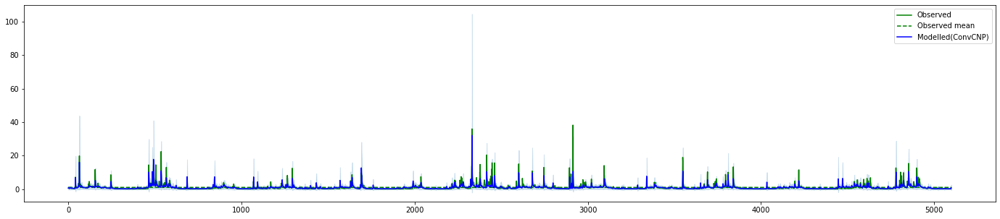

64. Basin hru_02018000 (period: 1996-2010): LL=0.015 -- NSE=0.247 -- time=20.260


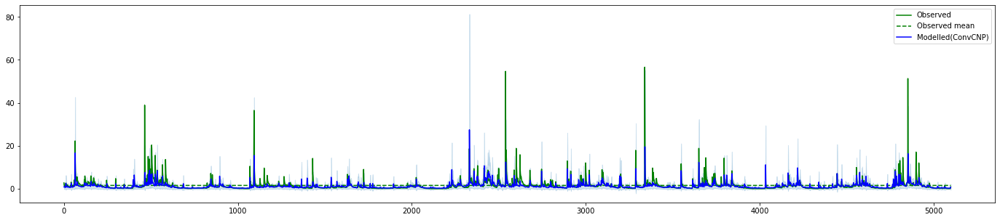

65. Basin hru_02027000 (period: 1996-2010): LL=0.005 -- NSE=0.165 -- time=20.144


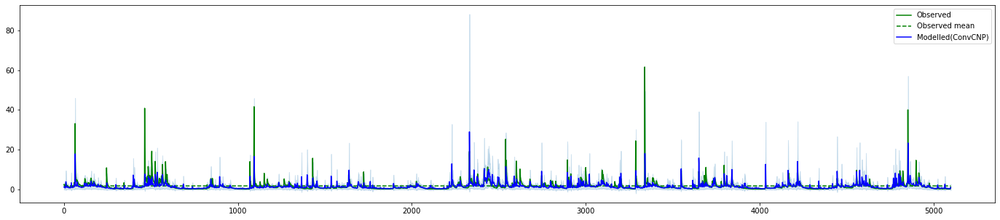

66. Basin hru_02027500 (period: 1996-2010): LL=0.004 -- NSE=0.184 -- time=20.045


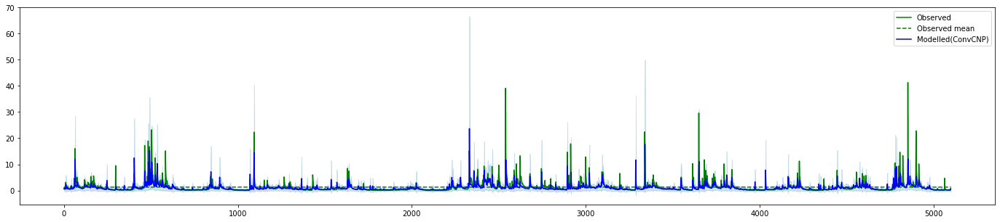

67. Basin hru_02028500 (period: 1996-2010): LL=0.009 -- NSE=0.201 -- time=20.460


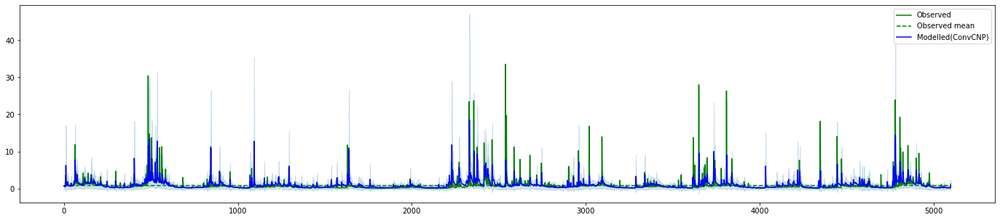

68. Basin hru_02038850 (period: 1996-2010): LL=0.012 -- NSE=0.072 -- time=20.843


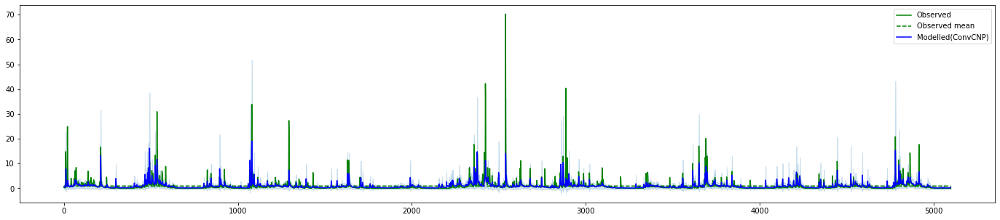

69. Basin hru_02046000 (period: 1996-2010): LL=0.013 -- NSE=0.173 -- time=20.610


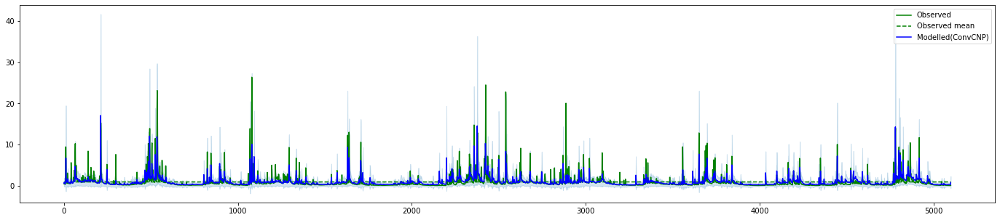

70. Basin hru_02051500 (period: 1996-2010): LL=0.016 -- NSE=0.187 -- time=20.302


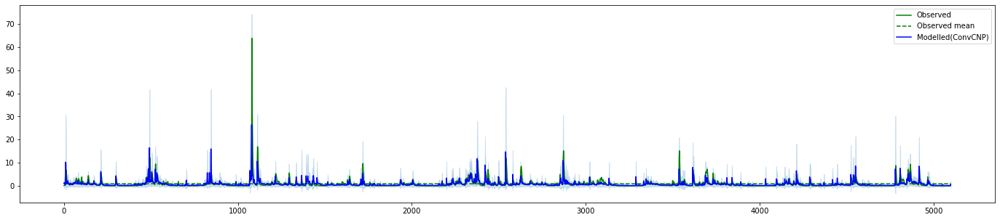

71. Basin hru_02053200 (period: 1996-2010): LL=0.013 -- NSE=0.171 -- time=20.133


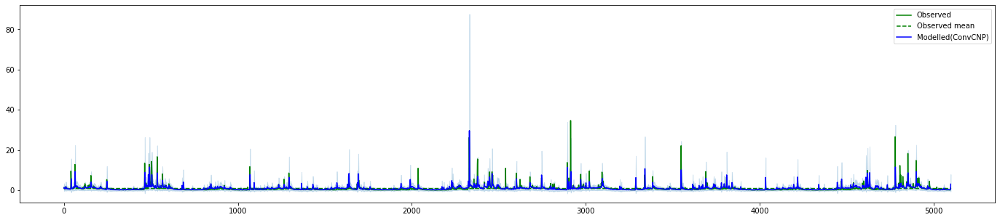

72. Basin hru_02053800 (period: 1996-2010): LL=0.014 -- NSE=0.157 -- time=20.321


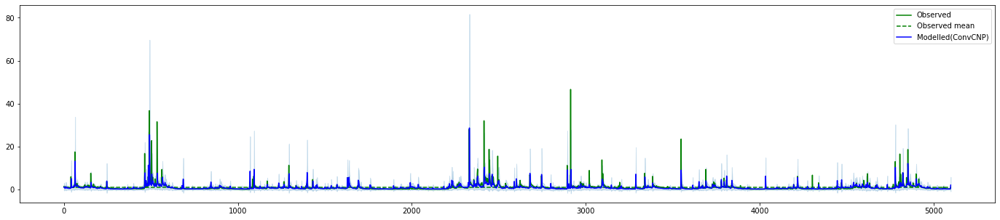

73. Basin hru_02055100 (period: 1996-2010): LL=0.015 -- NSE=0.152 -- time=20.114


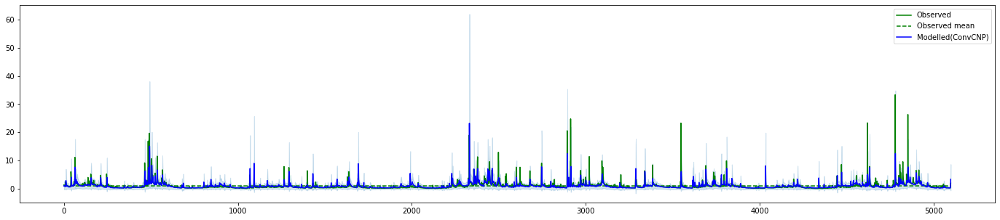

74. Basin hru_02056900 (period: 1996-2010): LL=0.016 -- NSE=0.166 -- time=20.081


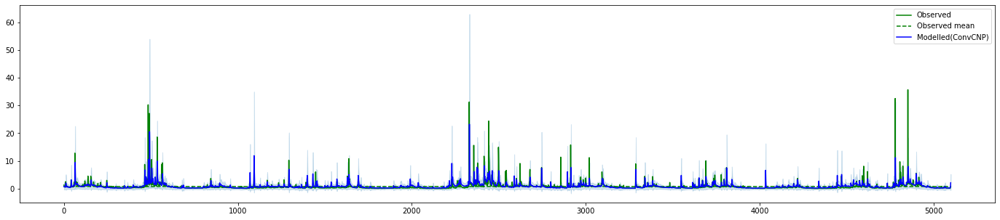

75. Basin hru_02059500 (period: 1996-2010): LL=0.017 -- NSE=0.093 -- time=20.268


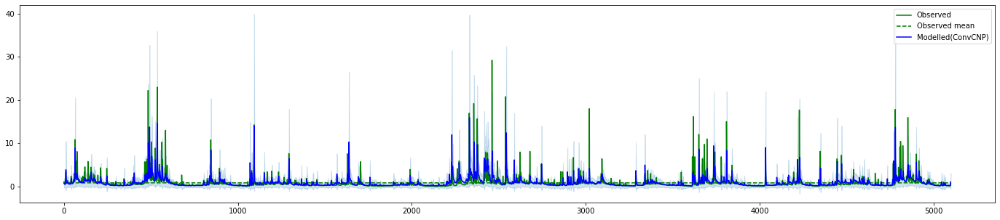

76. Basin hru_02064000 (period: 1996-2010): LL=0.016 -- NSE=0.146 -- time=20.095


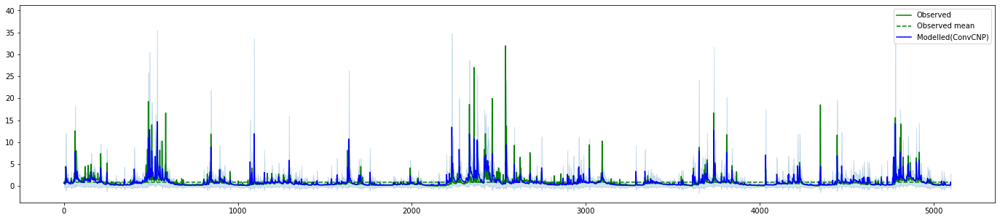

77. Basin hru_02065500 (period: 1996-2010): LL=0.017 -- NSE=0.208 -- time=20.280


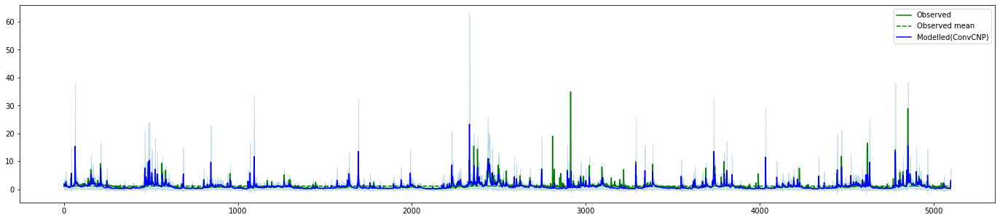

78. Basin hru_02069700 (period: 1996-2010): LL=0.011 -- NSE=0.253 -- time=20.325


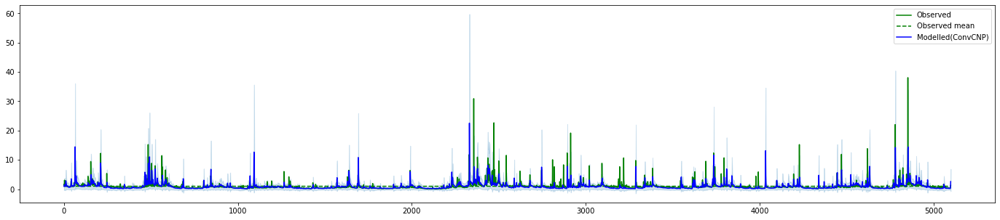

79. Basin hru_02070000 (period: 1996-2010): LL=0.014 -- NSE=0.180 -- time=20.540


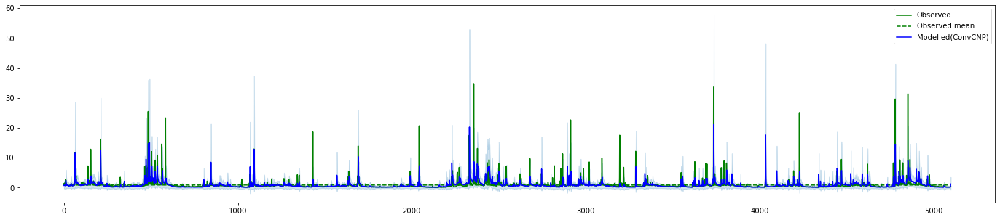

80. Basin hru_02074500 (period: 1996-2010): LL=0.015 -- NSE=0.129 -- time=20.405


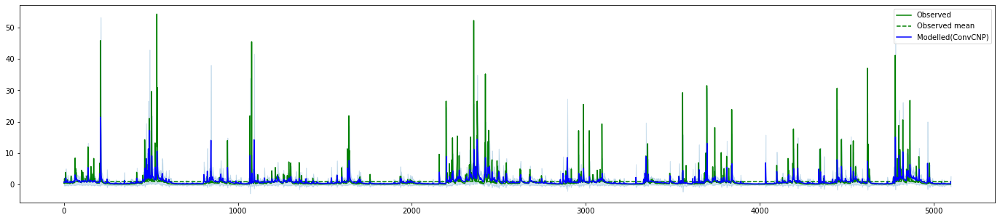

81. Basin hru_02077200 (period: 1996-2010): LL=0.013 -- NSE=0.115 -- time=20.183


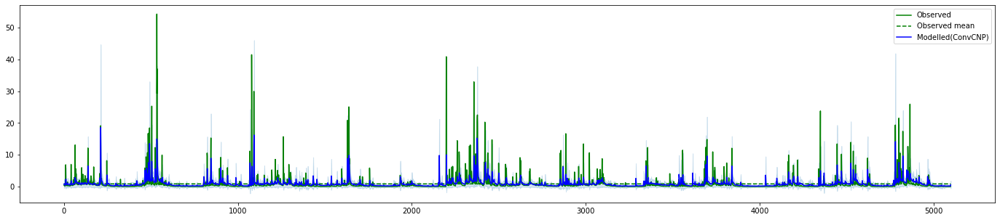

82. Basin hru_02081500 (period: 1996-2010): LL=0.012 -- NSE=0.138 -- time=20.288


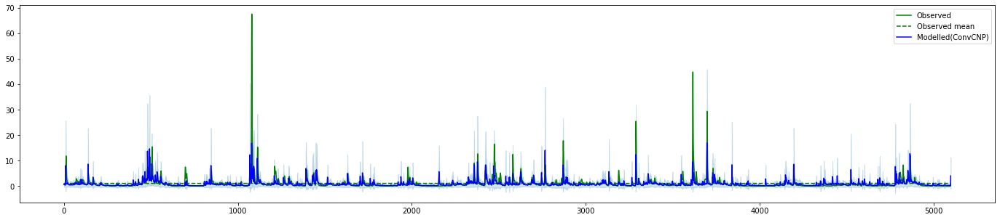

83. Basin hru_02092500 (period: 1996-2010): LL=0.010 -- NSE=0.141 -- time=20.214


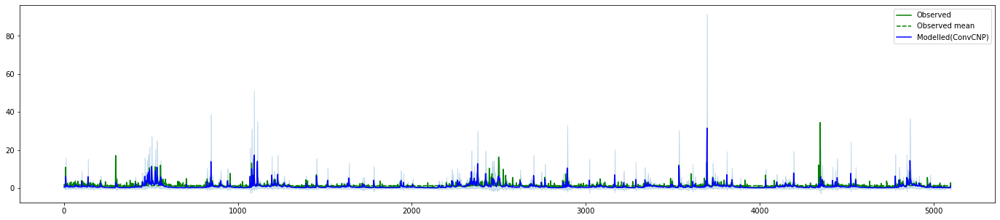

84. Basin hru_02102908 (period: 1996-2010): LL=-0.002 -- NSE=0.255 -- time=22.037


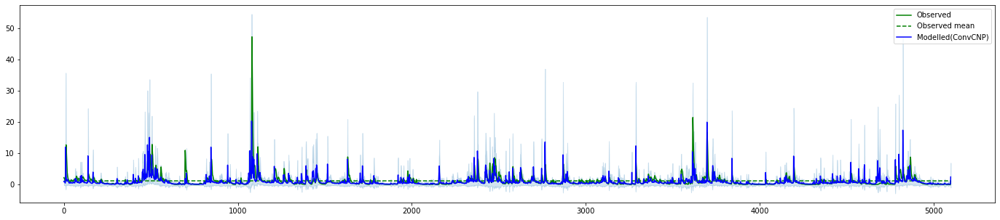

85. Basin hru_02108000 (period: 1996-2010): LL=0.008 -- NSE=0.179 -- time=20.937


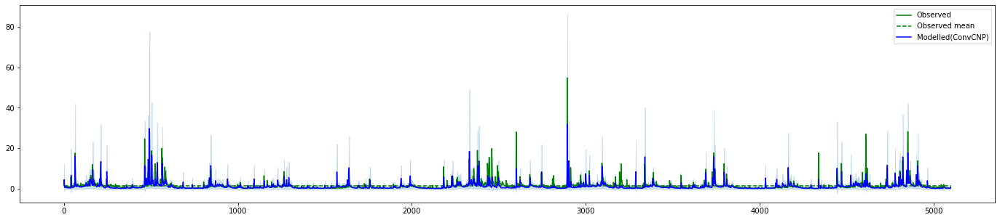

86. Basin hru_02111180 (period: 1996-2010): LL=0.005 -- NSE=0.230 -- time=20.377


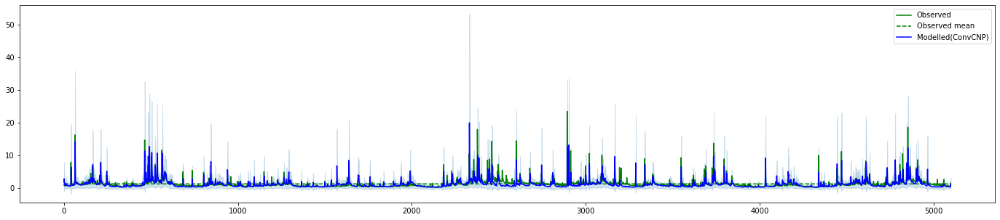

87. Basin hru_02111500 (period: 1996-2010): LL=0.009 -- NSE=0.267 -- time=20.034


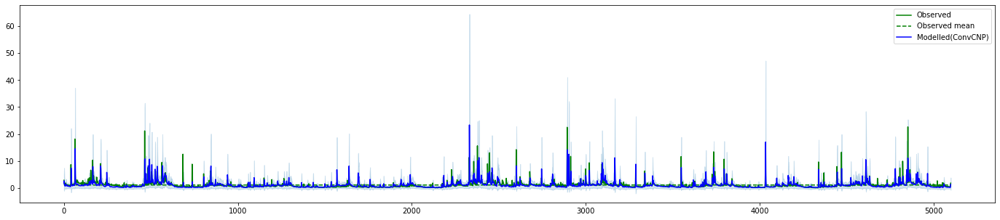

88. Basin hru_02112120 (period: 1996-2010): LL=0.011 -- NSE=0.257 -- time=20.131


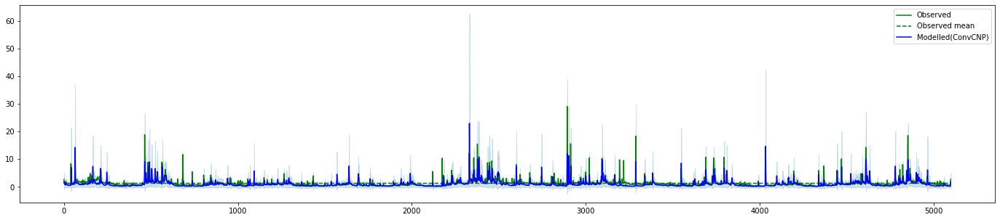

89. Basin hru_02112360 (period: 1996-2010): LL=0.006 -- NSE=0.247 -- time=20.083


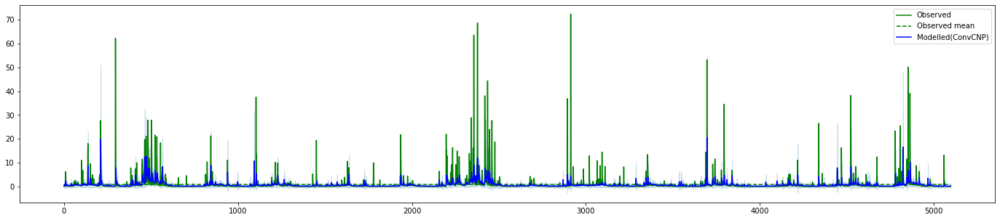

90. Basin hru_02125000 (period: 1996-2010): LL=0.006 -- NSE=0.064 -- time=20.206


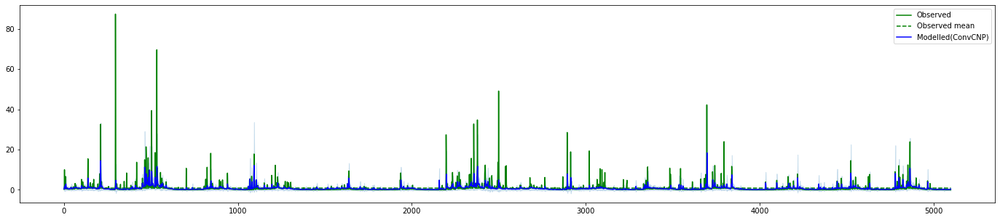

91. Basin hru_02128000 (period: 1996-2010): LL=0.006 -- NSE=0.076 -- time=20.424


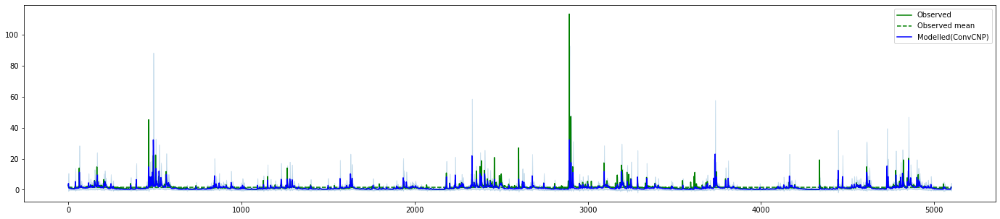

92. Basin hru_02137727 (period: 1996-2010): LL=0.006 -- NSE=0.193 -- time=19.830


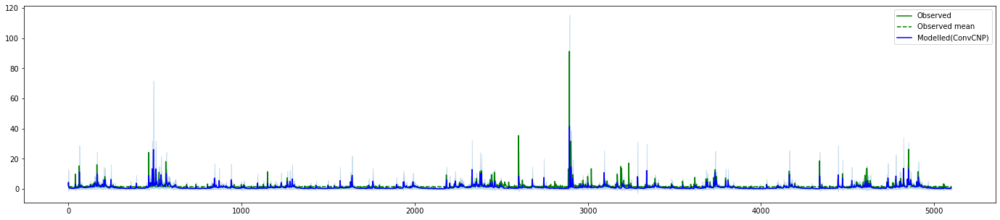

93. Basin hru_02140991 (period: 1996-2010): LL=0.004 -- NSE=0.180 -- time=20.258


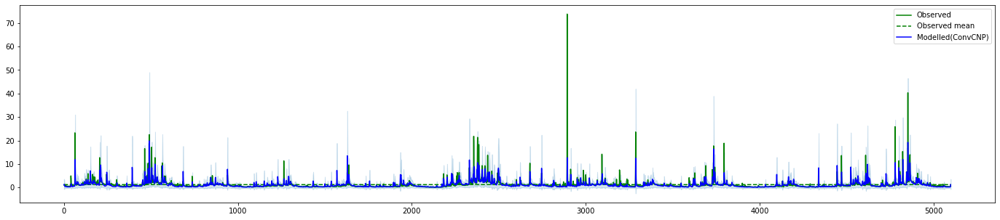

94. Basin hru_02143000 (period: 1996-2010): LL=0.012 -- NSE=0.227 -- time=20.203


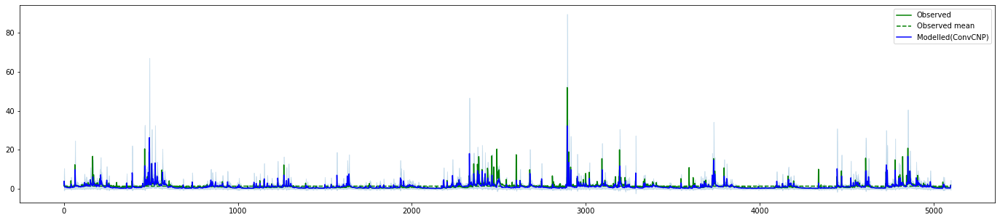

95. Basin hru_02149000 (period: 1996-2010): LL=0.009 -- NSE=0.286 -- time=20.292


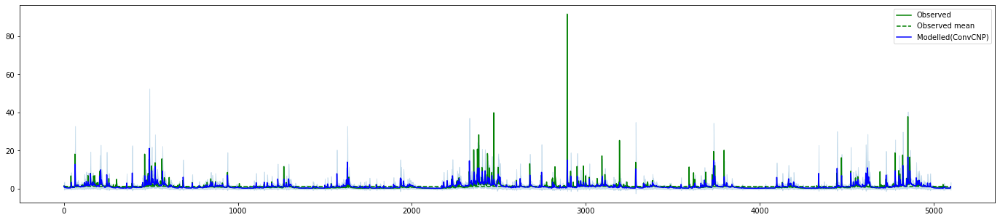

96. Basin hru_02152100 (period: 1996-2010): LL=0.010 -- NSE=0.160 -- time=20.341


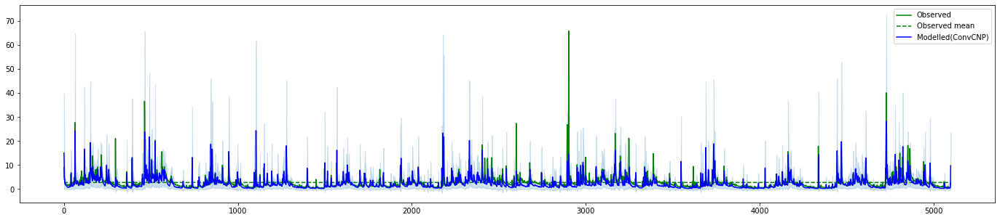

97. Basin hru_02178400 (period: 1996-2010): LL=-0.007 -- NSE=0.096 -- time=20.285


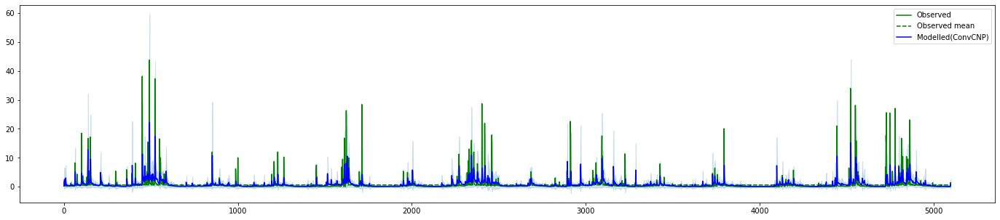

98. Basin hru_02193340 (period: 1996-2010): LL=0.011 -- NSE=0.053 -- time=20.199


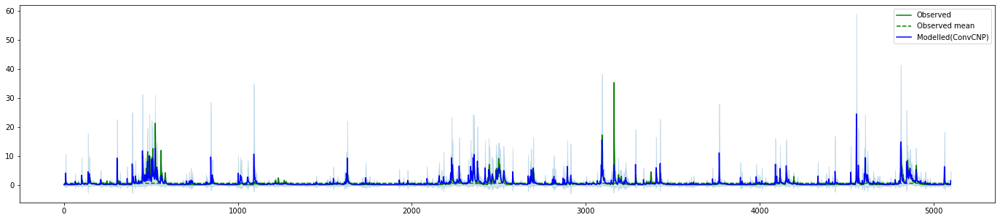

99. Basin hru_02202600 (period: 1996-2010): LL=0.020 -- NSE=0.030 -- time=20.270


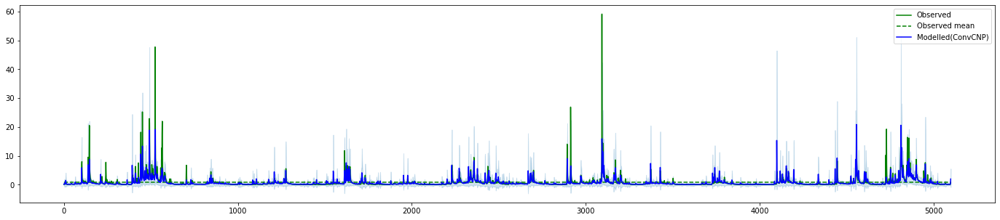

100. Basin hru_02215100 (period: 1996-2010): LL=0.019 -- NSE=0.227 -- time=20.275


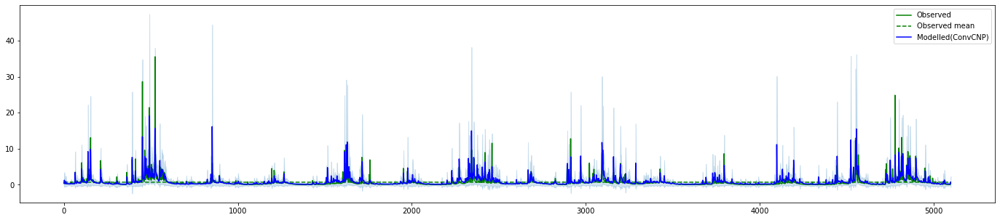

101. Basin hru_02221525 (period: 1996-2010): LL=0.019 -- NSE=0.211 -- time=20.408


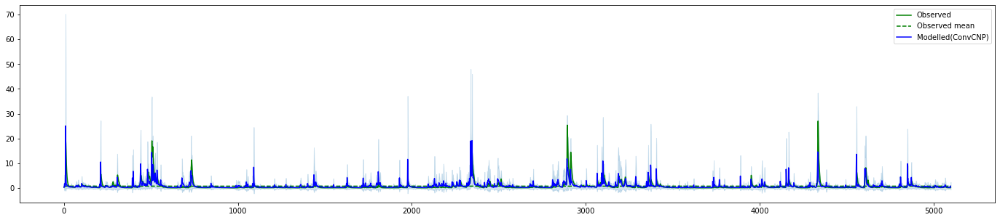

102. Basin hru_02231000 (period: 1996-2010): LL=0.017 -- NSE=0.170 -- time=20.263


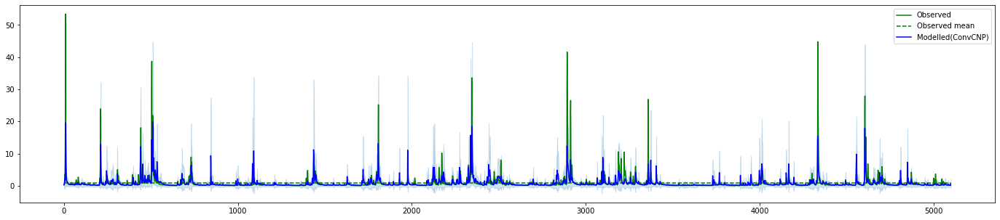

103. Basin hru_02246000 (period: 1996-2010): LL=0.019 -- NSE=0.205 -- time=20.427


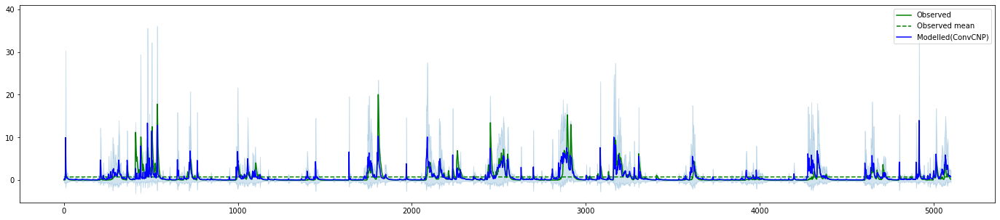

104. Basin hru_02296500 (period: 1996-2010): LL=0.017 -- NSE=0.183 -- time=20.239


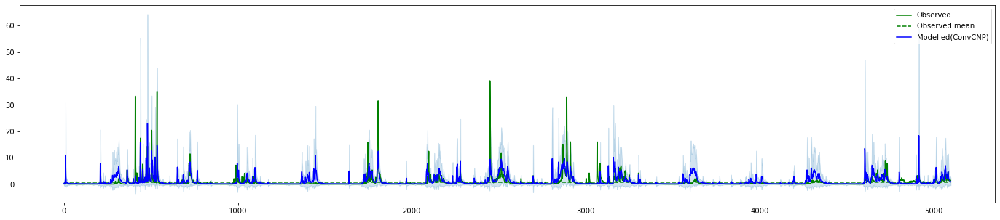

105. Basin hru_02297155 (period: 1996-2010): LL=0.016 -- NSE=0.151 -- time=19.886


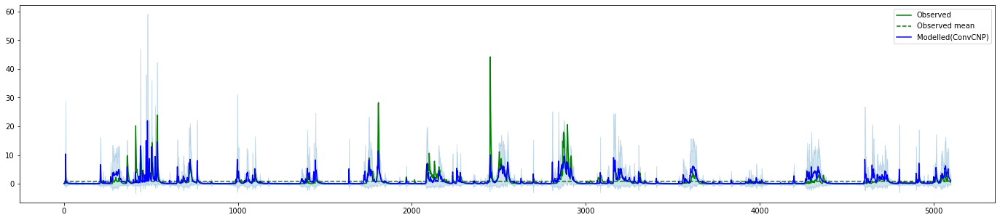

106. Basin hru_02297310 (period: 1996-2010): LL=0.017 -- NSE=0.191 -- time=20.320


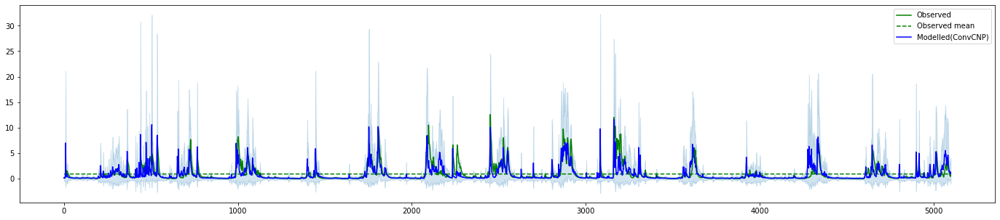

107. Basin hru_02298123 (period: 1996-2010): LL=0.019 -- NSE=0.251 -- time=20.415


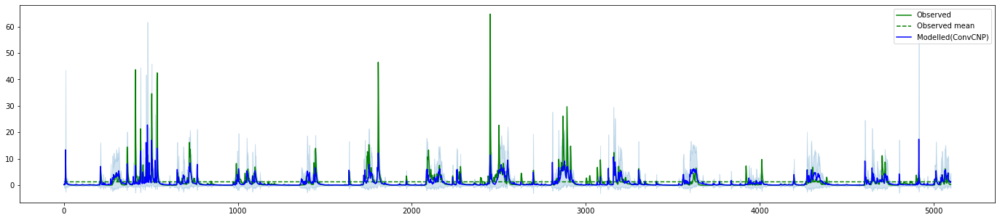

108. Basin hru_02298608 (period: 1996-2010): LL=0.011 -- NSE=0.169 -- time=20.240


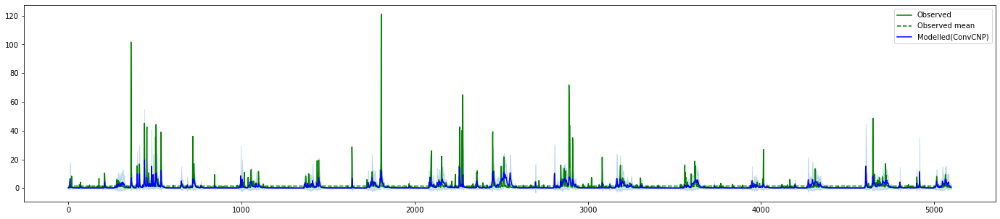

109. Basin hru_02300700 (period: 1996-2010): LL=0.002 -- NSE=0.098 -- time=20.330


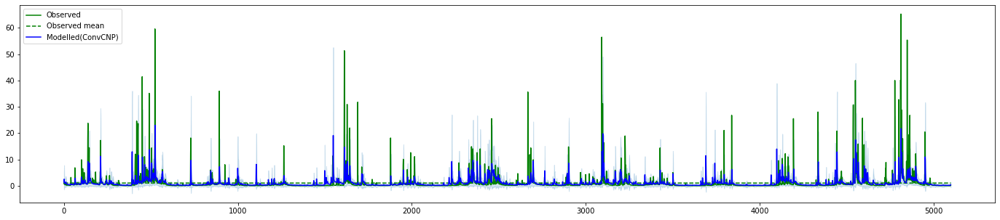

110. Basin hru_02342933 (period: 1996-2010): LL=0.007 -- NSE=0.120 -- time=20.176


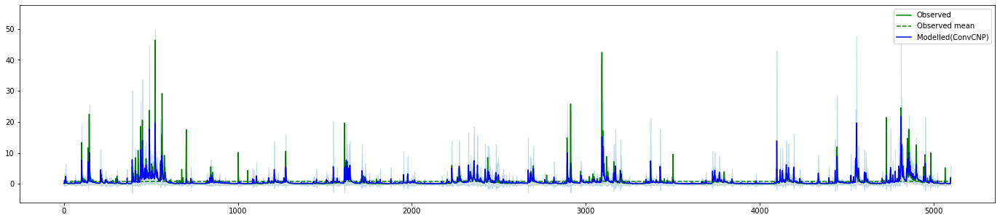

111. Basin hru_02349900 (period: 1996-2010): LL=0.019 -- NSE=0.213 -- time=20.284


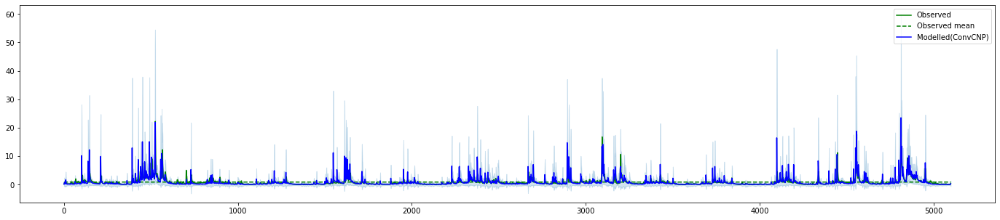

112. Basin hru_02350900 (period: 1996-2010): LL=0.016 -- NSE=0.338 -- time=20.378


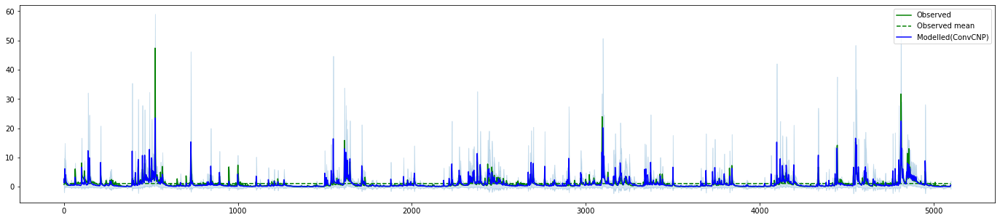

113. Basin hru_02361000 (period: 1996-2010): LL=0.014 -- NSE=0.337 -- time=20.266


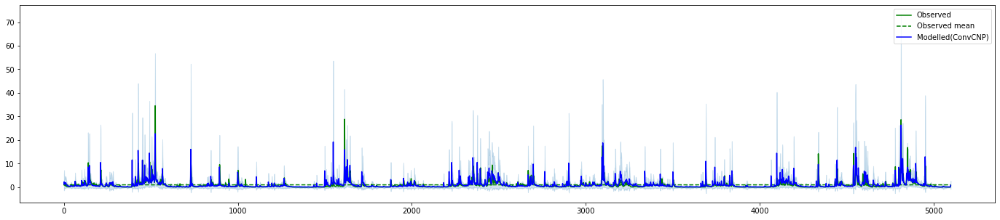

114. Basin hru_02363000 (period: 1996-2010): LL=0.014 -- NSE=0.294 -- time=19.999


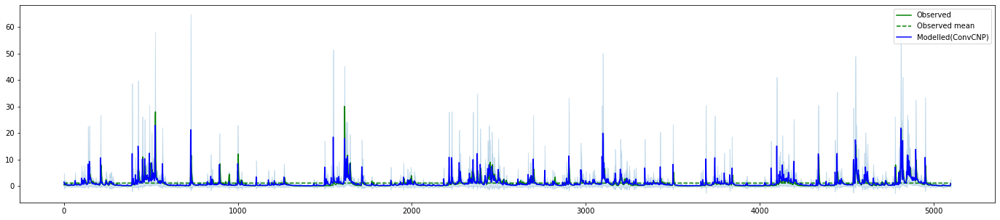

115. Basin hru_02371500 (period: 1996-2010): LL=0.012 -- NSE=0.285 -- time=20.181


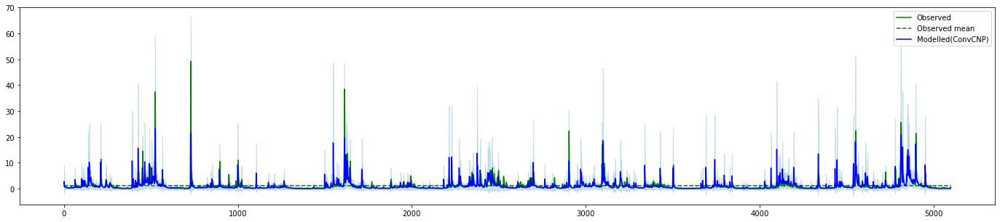

116. Basin hru_02372250 (period: 1996-2010): LL=0.012 -- NSE=0.261 -- time=20.320


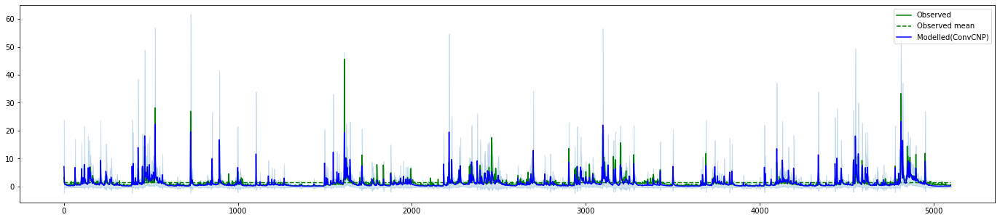

117. Basin hru_02374500 (period: 1996-2010): LL=0.008 -- NSE=0.378 -- time=20.632


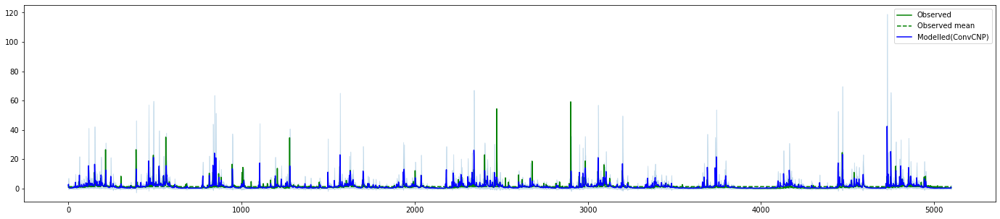

118. Basin hru_02381600 (period: 1996-2010): LL=0.002 -- NSE=0.194 -- time=20.162


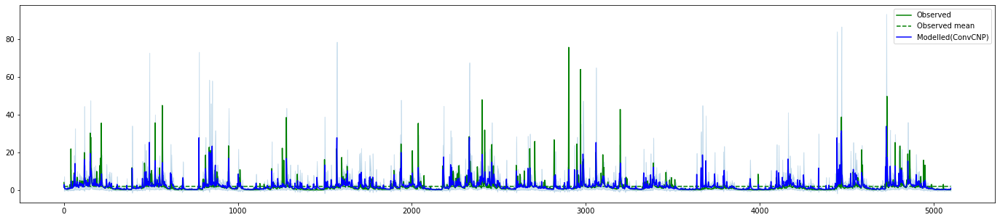

119. Basin hru_02384540 (period: 1996-2010): LL=0.000 -- NSE=0.204 -- time=20.398


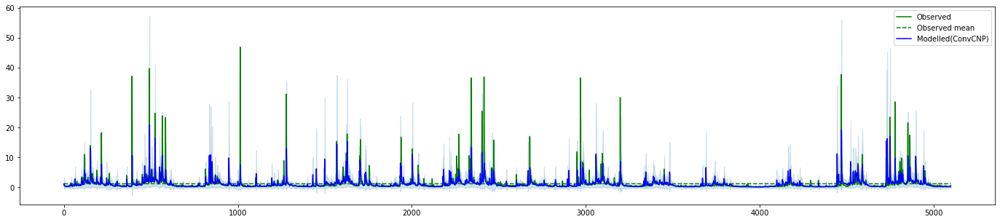

120. Basin hru_02395120 (period: 1996-2010): LL=0.013 -- NSE=0.186 -- time=20.414


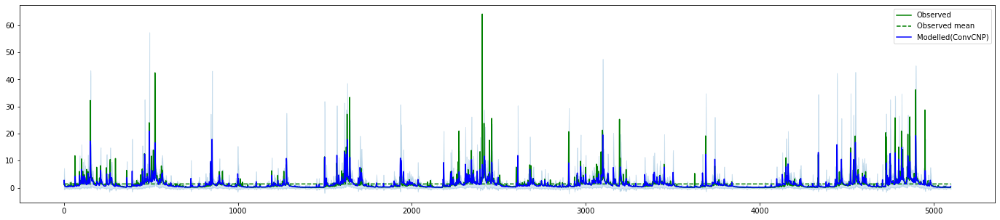

121. Basin hru_02415000 (period: 1996-2010): LL=0.010 -- NSE=0.230 -- time=19.884


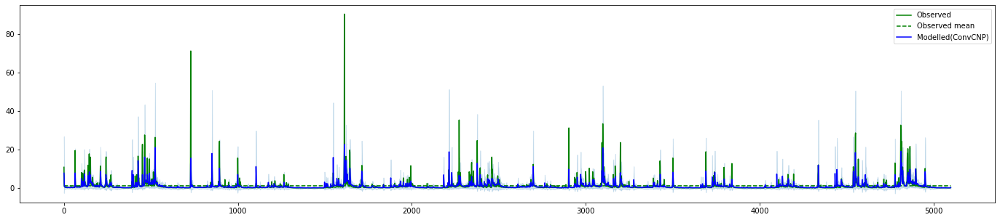

122. Basin hru_02427250 (period: 1996-2010): LL=0.014 -- NSE=0.203 -- time=20.269


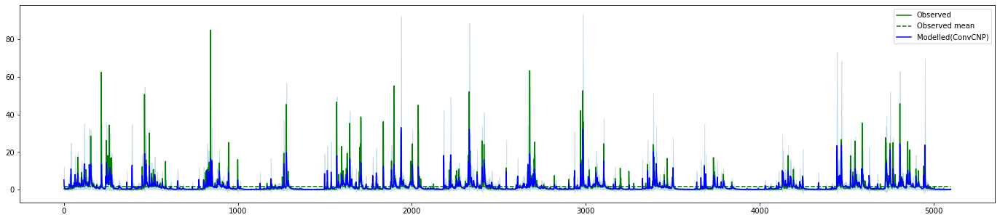

123. Basin hru_02450250 (period: 1996-2010): LL=0.008 -- NSE=0.219 -- time=20.350


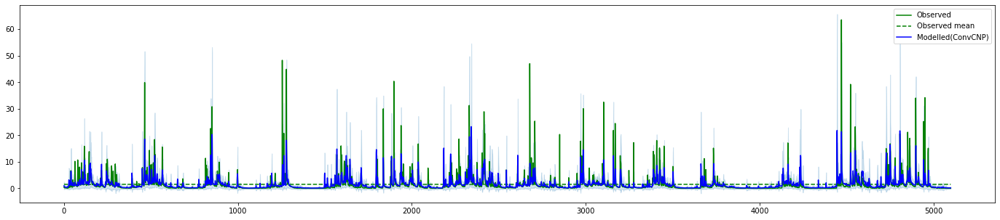

124. Basin hru_02464000 (period: 1996-2010): LL=0.007 -- NSE=0.220 -- time=20.329


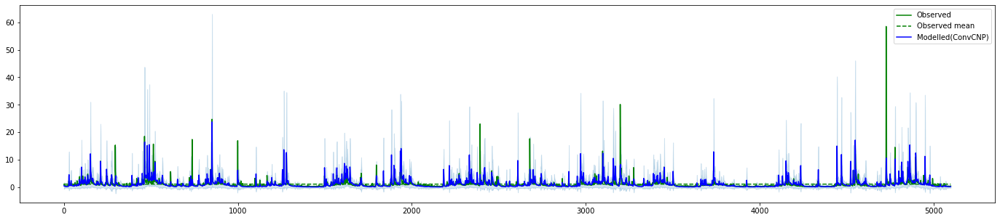

125. Basin hru_02465493 (period: 1996-2010): LL=0.010 -- NSE=0.268 -- time=20.169


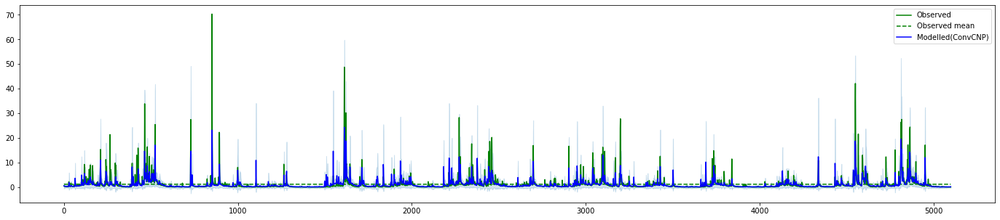

126. Basin hru_02469800 (period: 1996-2010): LL=0.013 -- NSE=0.247 -- time=20.405


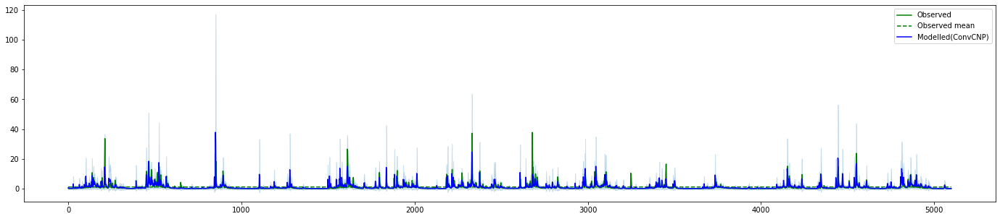

127. Basin hru_02472000 (period: 1996-2010): LL=0.013 -- NSE=0.250 -- time=20.300


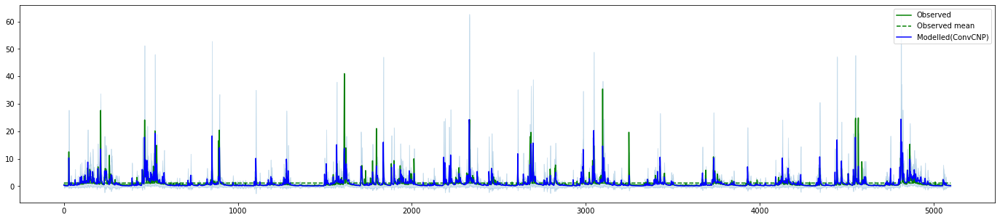

128. Basin hru_02472500 (period: 1996-2010): LL=0.012 -- NSE=0.291 -- time=20.297


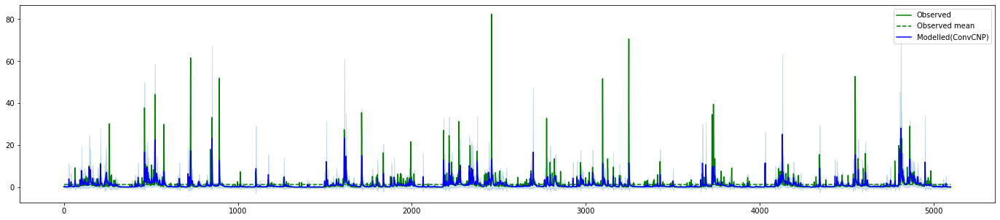

129. Basin hru_02479155 (period: 1996-2010): LL=0.008 -- NSE=0.182 -- time=19.943


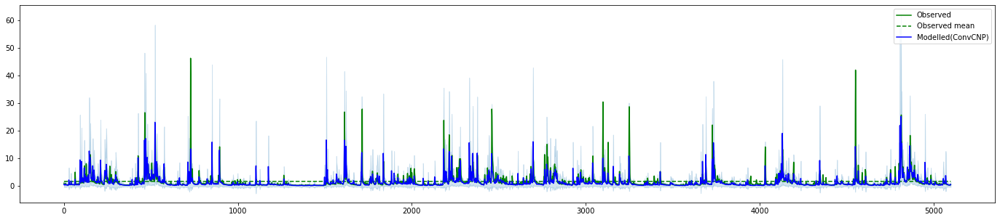

130. Basin hru_02479300 (period: 1996-2010): LL=0.008 -- NSE=0.220 -- time=20.417


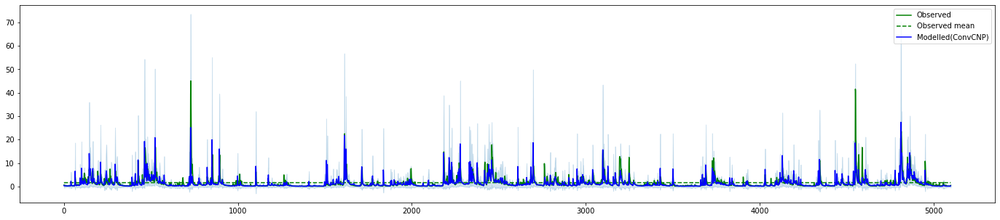

131. Basin hru_02479560 (period: 1996-2010): LL=0.008 -- NSE=0.247 -- time=20.250


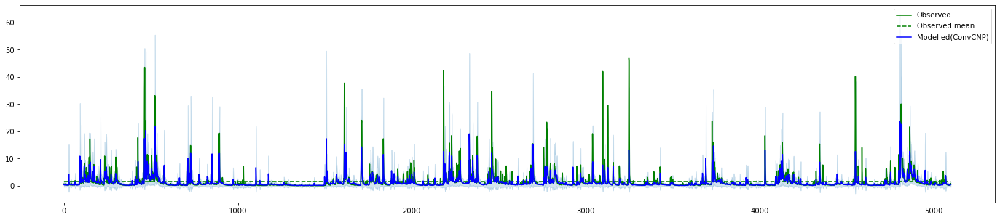

132. Basin hru_02481510 (period: 1996-2010): LL=0.010 -- NSE=0.213 -- time=20.300


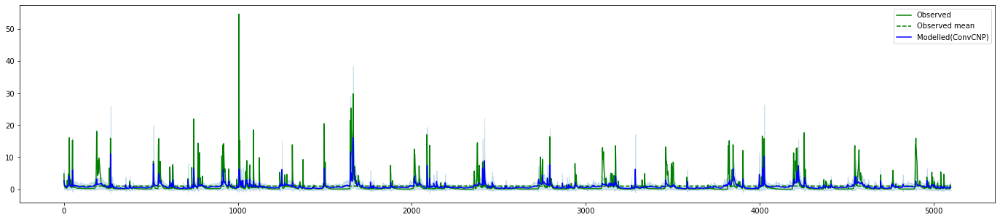

133. Basin hru_04015330 (period: 1996-2010): LL=0.006 -- NSE=0.111 -- time=20.199


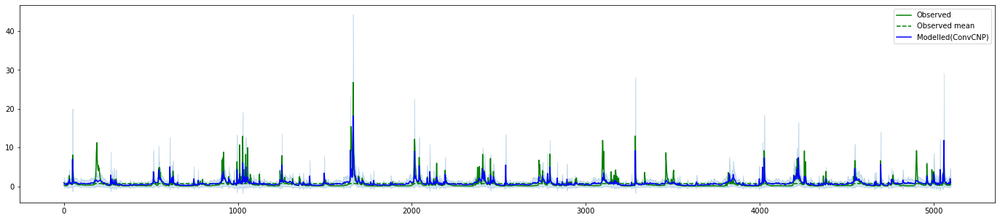

134. Basin hru_04024430 (period: 1996-2010): LL=0.015 -- NSE=0.091 -- time=20.326


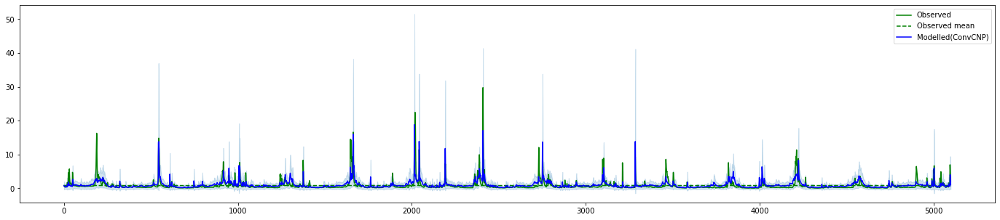

135. Basin hru_04027000 (period: 1996-2010): LL=0.014 -- NSE=0.179 -- time=20.299


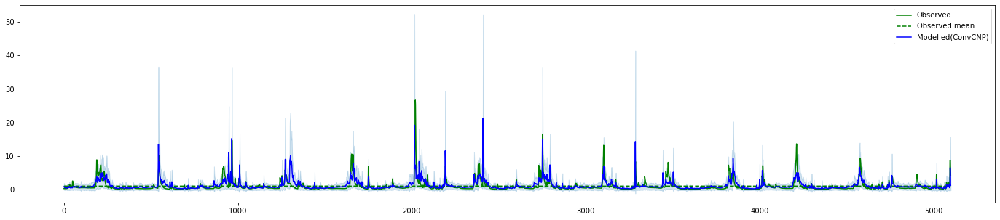

136. Basin hru_04040500 (period: 1996-2010): LL=0.014 -- NSE=0.226 -- time=20.248


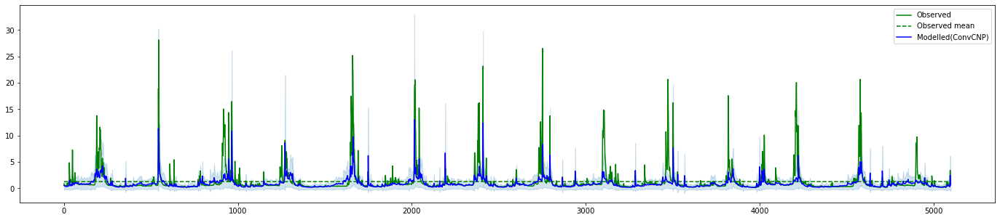

137. Basin hru_04043050 (period: 1996-2010): LL=0.010 -- NSE=0.141 -- time=20.215


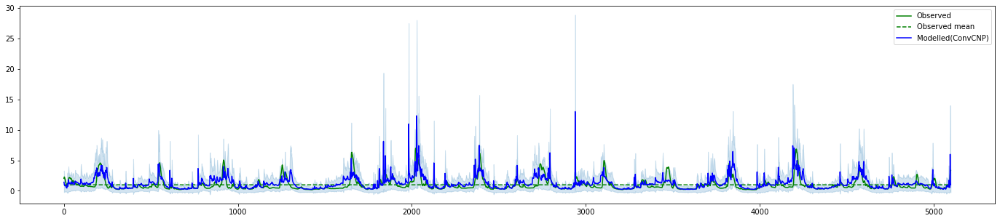

138. Basin hru_04045500 (period: 1996-2010): LL=0.013 -- NSE=0.159 -- time=20.321


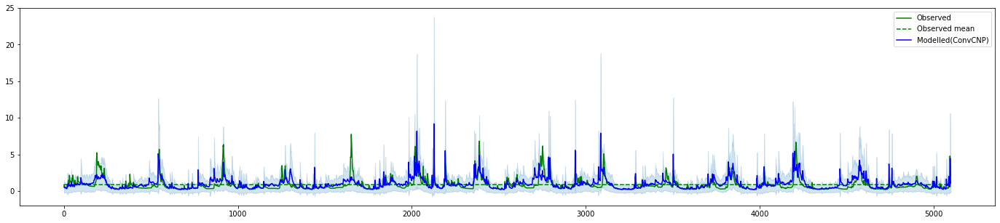

139. Basin hru_04057510 (period: 1996-2010): LL=0.016 -- NSE=0.041 -- time=20.435


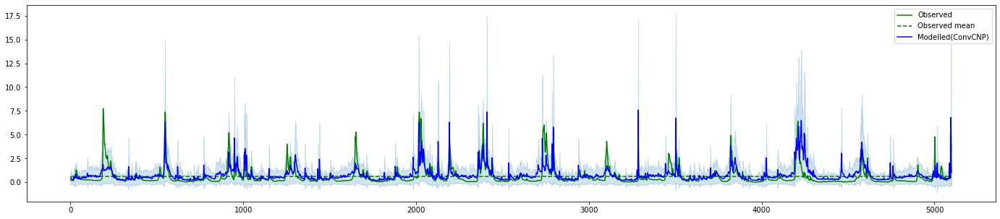

140. Basin hru_04059500 (period: 1996-2010): LL=0.017 -- NSE=-0.154 -- time=20.398


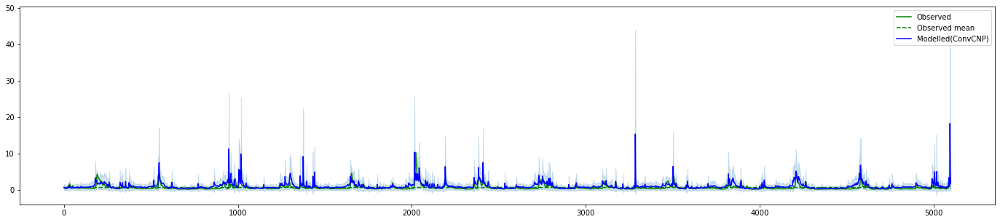

141. Basin hru_04063700 (period: 1996-2010): LL=0.016 -- NSE=-0.569 -- time=20.346


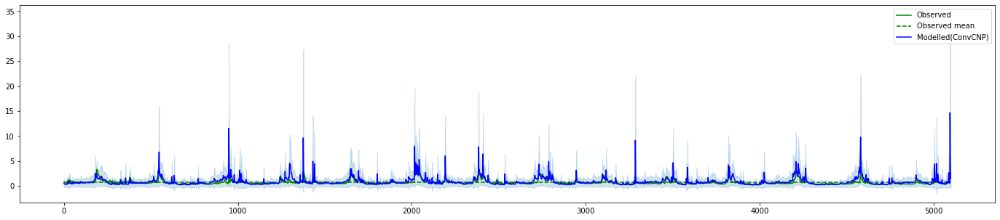

142. Basin hru_04074950 (period: 1996-2010): LL=0.019 -- NSE=-0.810 -- time=20.344


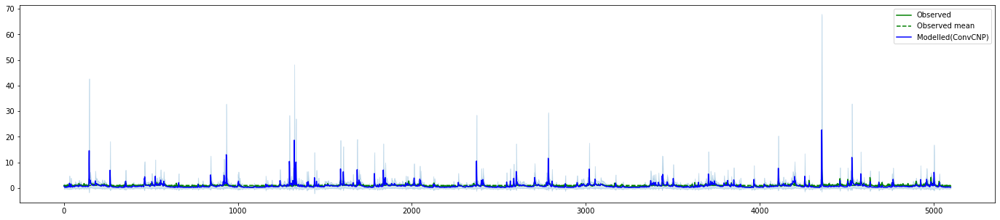

143. Basin hru_04105700 (period: 1996-2010): LL=0.013 -- NSE=0.253 -- time=20.308


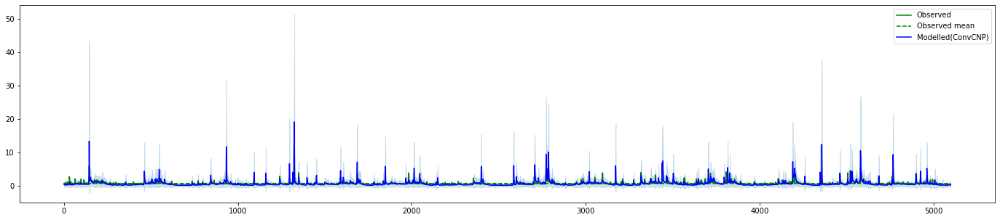

144. Basin hru_04115265 (period: 1996-2010): LL=0.020 -- NSE=-0.429 -- time=20.351


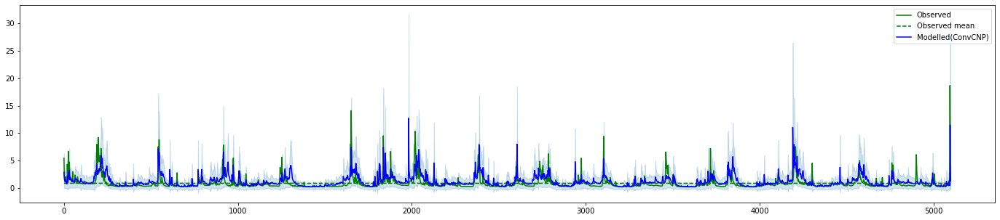

145. Basin hru_04127918 (period: 1996-2010): LL=0.014 -- NSE=0.113 -- time=20.364


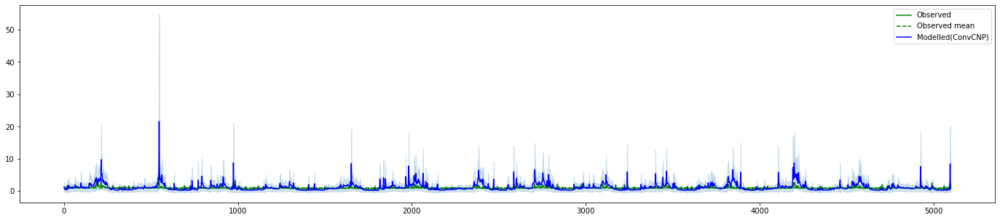

146. Basin hru_04127997 (period: 1996-2010): LL=0.010 -- NSE=-0.772 -- time=20.411


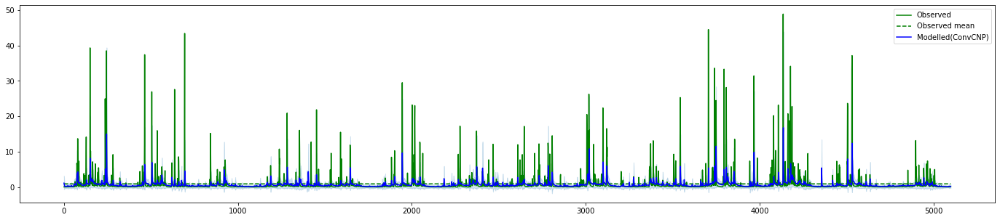

147. Basin hru_04197170 (period: 1996-2010): LL=0.001 -- NSE=0.083 -- time=22.011


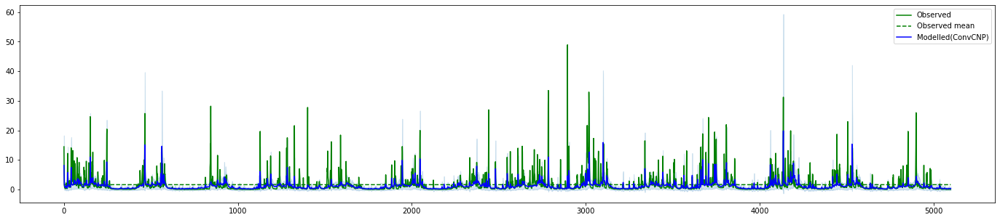

148. Basin hru_04213000 (period: 1996-2010): LL=-0.002 -- NSE=0.136 -- time=20.164


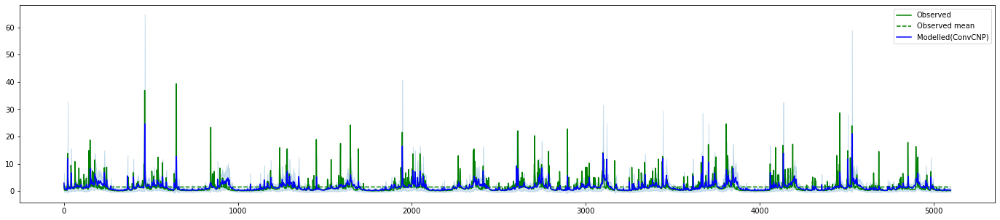

149. Basin hru_04216418 (period: 1996-2010): LL=-0.000 -- NSE=0.163 -- time=20.225


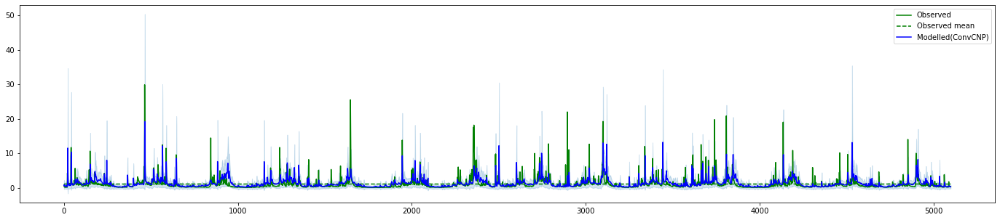

150. Basin hru_04224775 (period: 1996-2010): LL=0.007 -- NSE=0.179 -- time=20.014


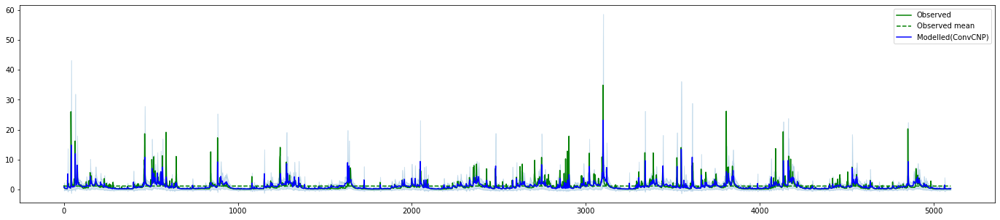

151. Basin hru_04233000 (period: 1996-2010): LL=0.009 -- NSE=0.208 -- time=20.527


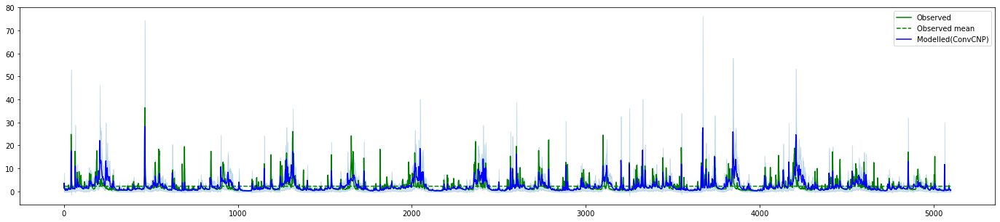

152. Basin hru_04256000 (period: 1996-2010): LL=-0.001 -- NSE=0.185 -- time=20.370


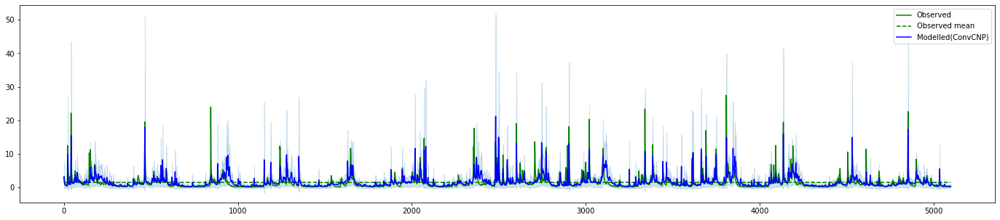

153. Basin hru_03010655 (period: 1996-2010): LL=0.007 -- NSE=0.271 -- time=20.079


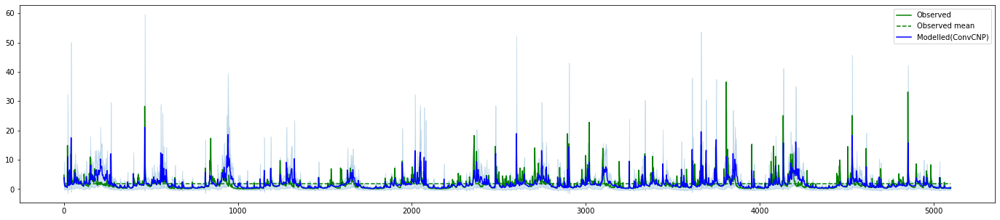

154. Basin hru_03011800 (period: 1996-2010): LL=0.001 -- NSE=0.220 -- time=20.192


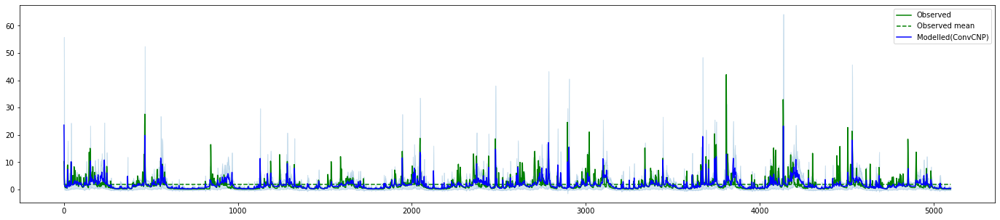

155. Basin hru_03015500 (period: 1996-2010): LL=0.000 -- NSE=0.195 -- time=20.173


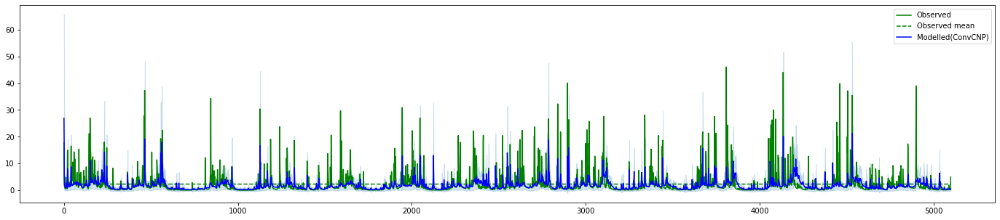

156. Basin hru_03021350 (period: 1996-2010): LL=-0.017 -- NSE=0.077 -- time=20.471


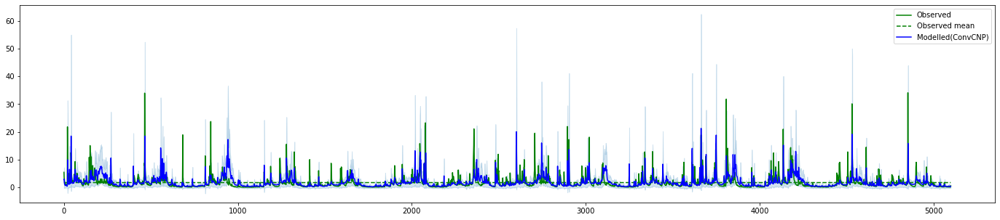

157. Basin hru_03026500 (period: 1996-2010): LL=0.001 -- NSE=0.216 -- time=20.136


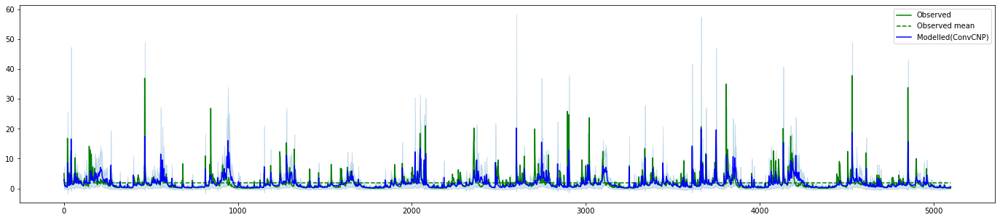

158. Basin hru_03028000 (period: 1996-2010): LL=0.001 -- NSE=0.191 -- time=20.348


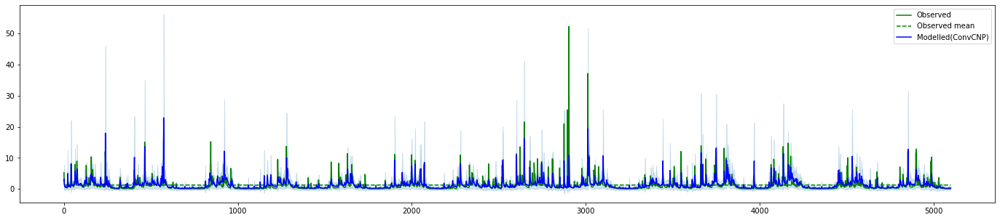

159. Basin hru_03049000 (period: 1996-2010): LL=0.007 -- NSE=0.229 -- time=20.317


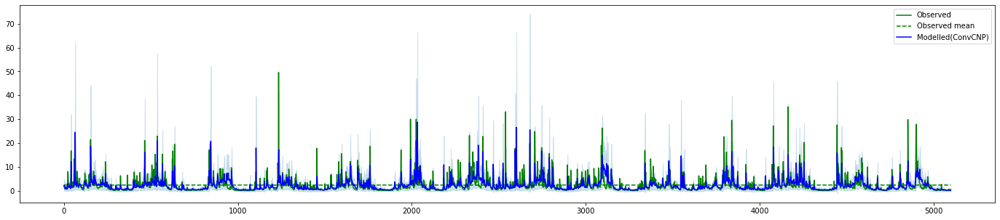

160. Basin hru_03069500 (period: 1996-2010): LL=-0.001 -- NSE=0.202 -- time=20.401


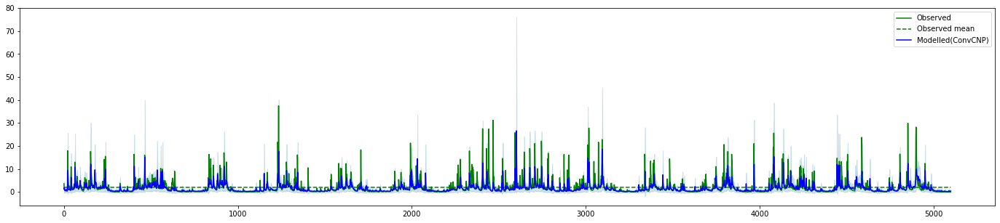

161. Basin hru_03070500 (period: 1996-2010): LL=0.002 -- NSE=0.170 -- time=20.348


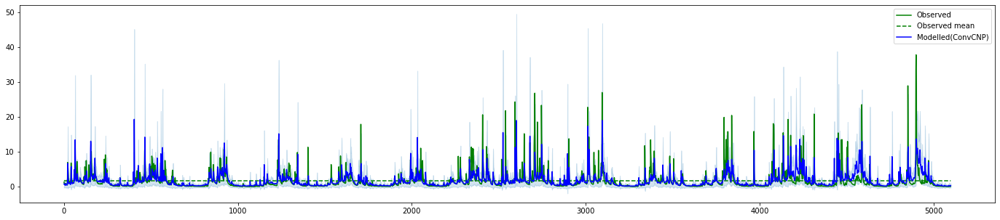

162. Basin hru_03076600 (period: 1996-2010): LL=0.005 -- NSE=0.228 -- time=21.014


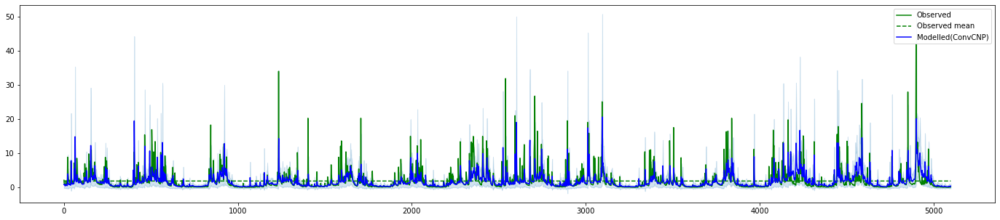

163. Basin hru_03078000 (period: 1996-2010): LL=0.001 -- NSE=0.202 -- time=20.411


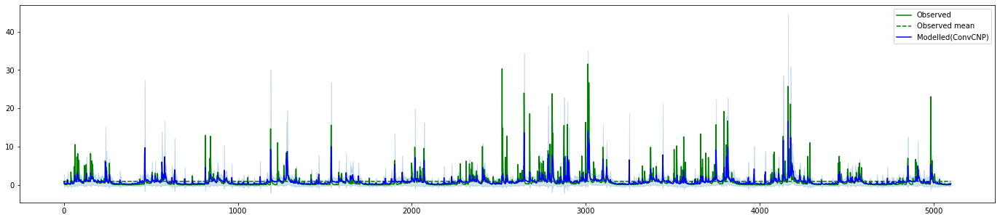

164. Basin hru_03140000 (period: 1996-2010): LL=0.011 -- NSE=0.158 -- time=20.390


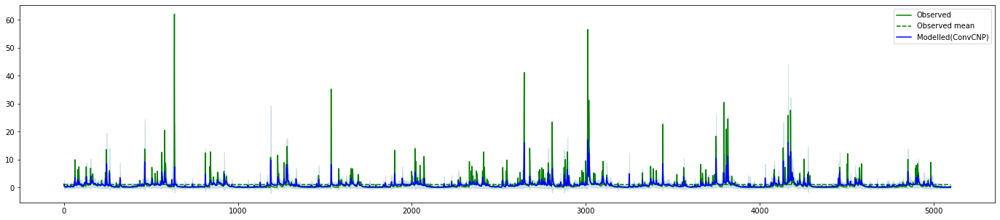

165. Basin hru_03144000 (period: 1996-2010): LL=0.011 -- NSE=0.151 -- time=20.409


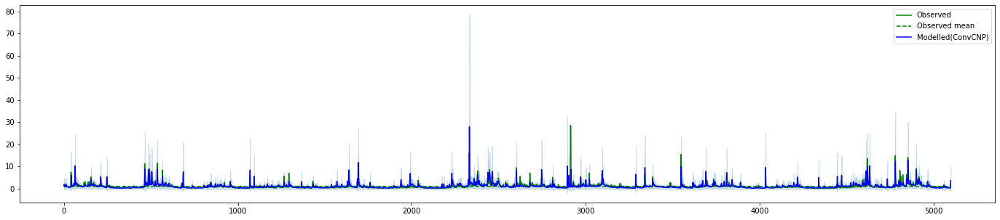

166. Basin hru_03170000 (period: 1996-2010): LL=0.015 -- NSE=0.253 -- time=20.421


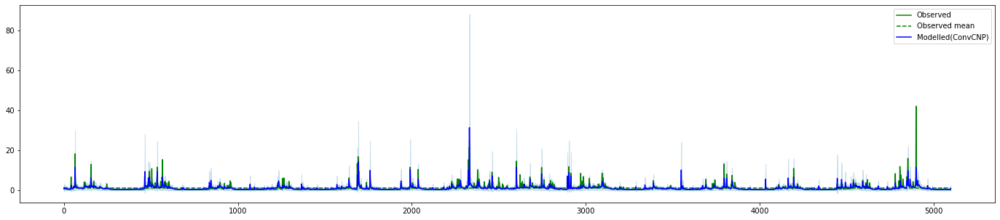

167. Basin hru_03173000 (period: 1996-2010): LL=0.016 -- NSE=0.226 -- time=20.453


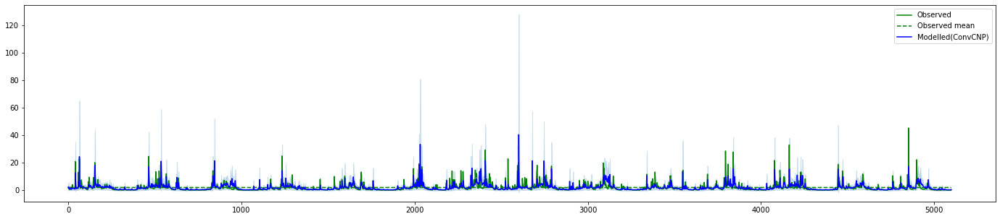

168. Basin hru_03180500 (period: 1996-2010): LL=0.003 -- NSE=0.256 -- time=20.325


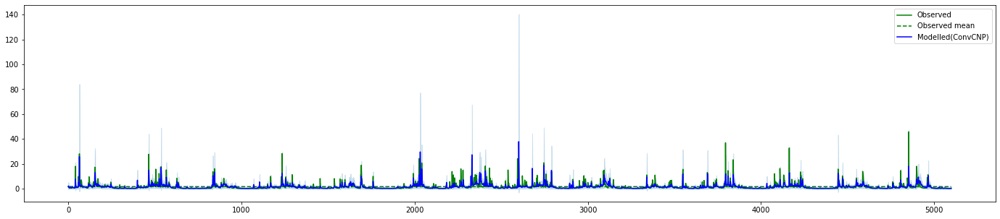

169. Basin hru_03182500 (period: 1996-2010): LL=0.008 -- NSE=0.257 -- time=20.302


/home/donal/miniconda3/lib/python3.7/site-packages/scipy/stats/_distn_infrastructure.py:881: RuntimeWarning: invalid value encountered in greater
  cond = logical_and(cond, (asarray(arg) > 0))
/home/donal/miniconda3/lib/python3.7/site-packages/scipy/stats/_distn_infrastructure.py:2016: RuntimeWarning: invalid value encountered in greater
  cond0 = self._argcheck(*args) & (scale > 0) & (loc == loc)


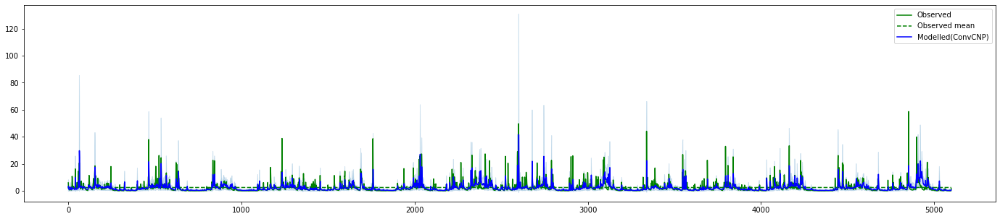

170. Basin hru_03186500 (period: 1996-2010): LL=nan -- NSE=nan -- time=20.306


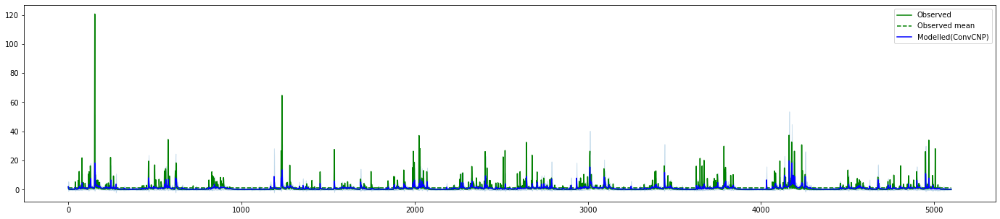

171. Basin hru_03237500 (period: 1996-2010): LL=-0.002 -- NSE=0.100 -- time=20.278


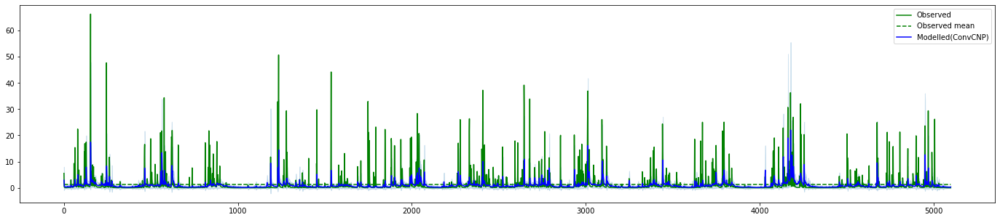

172. Basin hru_03238500 (period: 1996-2010): LL=-0.010 -- NSE=0.093 -- time=20.367


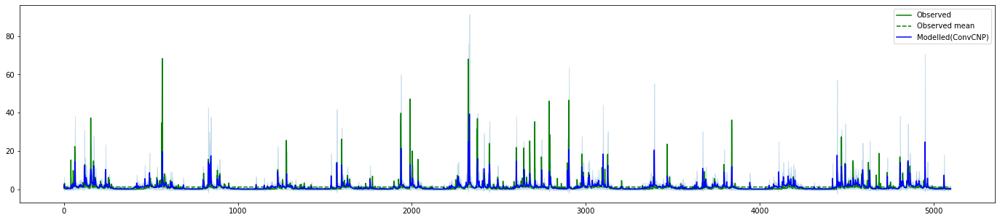

173. Basin hru_03280700 (period: 1996-2010): LL=0.004 -- NSE=0.175 -- time=20.333


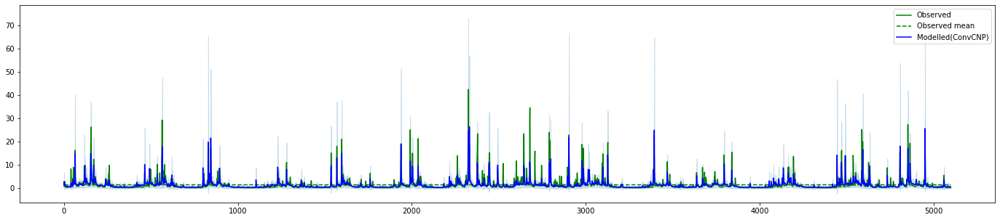

174. Basin hru_03281500 (period: 1996-2010): LL=0.011 -- NSE=0.278 -- time=20.144


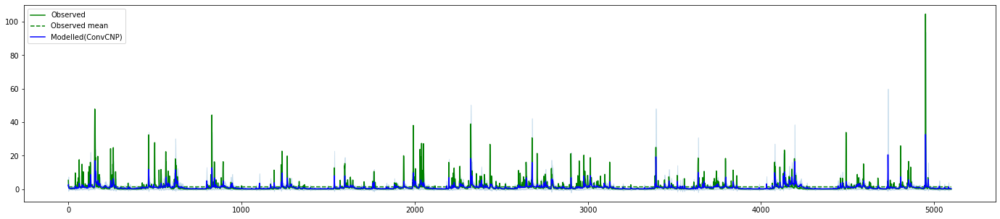

175. Basin hru_03285000 (period: 1996-2010): LL=0.007 -- NSE=0.168 -- time=20.097


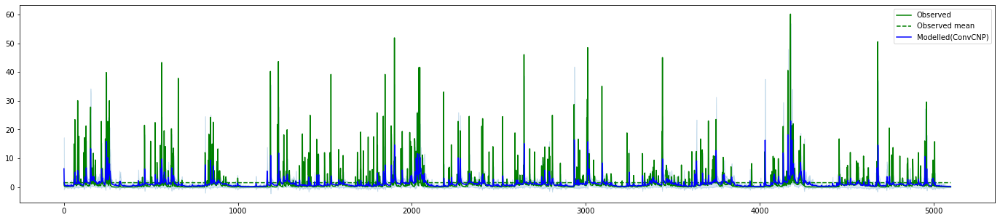

176. Basin hru_03291780 (period: 1996-2010): LL=-0.016 -- NSE=0.088 -- time=20.407


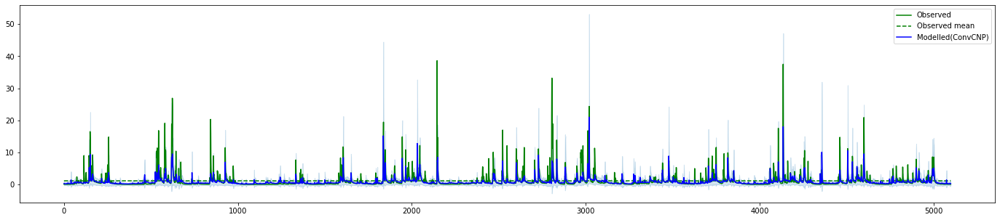

177. Basin hru_03338780 (period: 1996-2010): LL=0.010 -- NSE=0.179 -- time=20.384


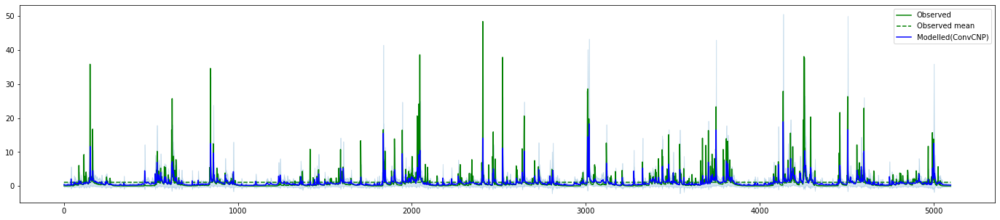

178. Basin hru_03340800 (period: 1996-2010): LL=0.011 -- NSE=0.174 -- time=20.153


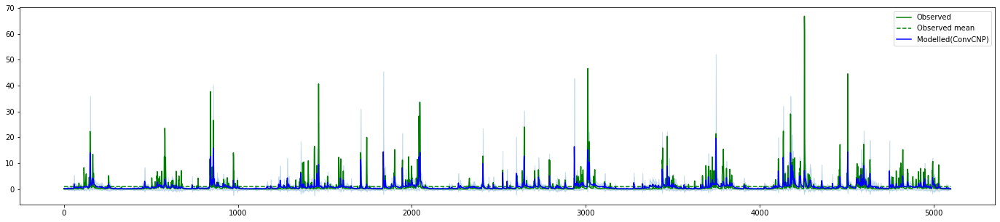

179. Basin hru_03346000 (period: 1996-2010): LL=0.010 -- NSE=0.158 -- time=20.413


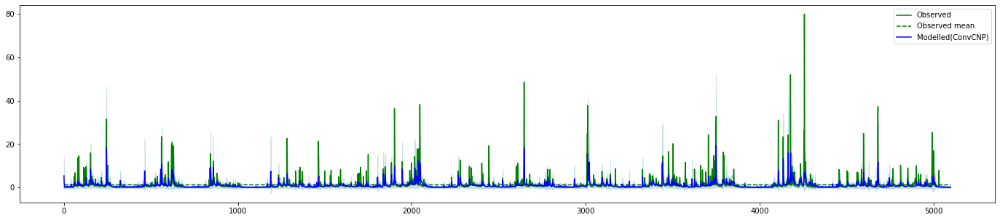

180. Basin hru_03364500 (period: 1996-2010): LL=0.005 -- NSE=0.137 -- time=20.247


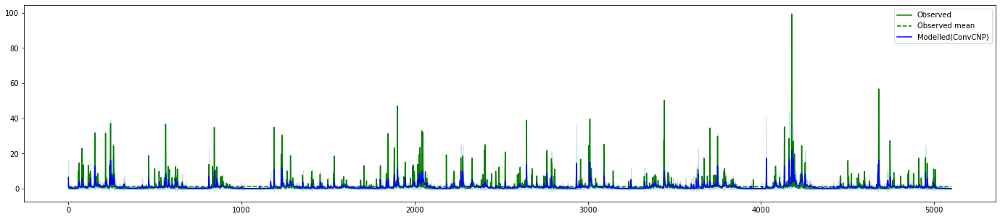

181. Basin hru_03366500 (period: 1996-2010): LL=0.001 -- NSE=0.133 -- time=20.403


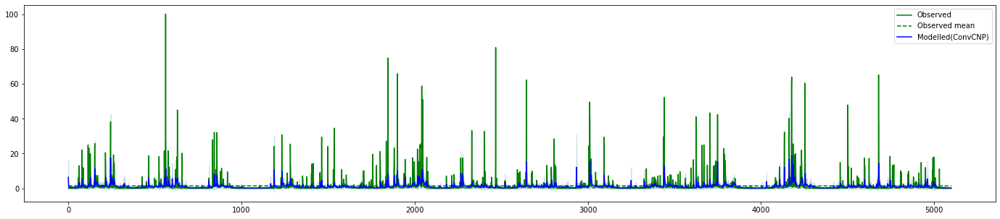

182. Basin hru_03368000 (period: 1996-2010): LL=-0.025 -- NSE=0.059 -- time=20.175


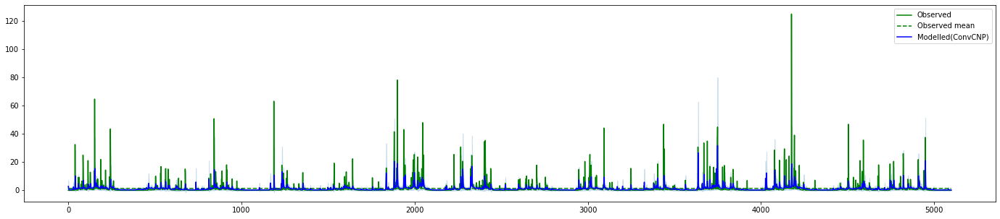

183. Basin hru_03384450 (period: 1996-2010): LL=-0.003 -- NSE=0.098 -- time=20.356


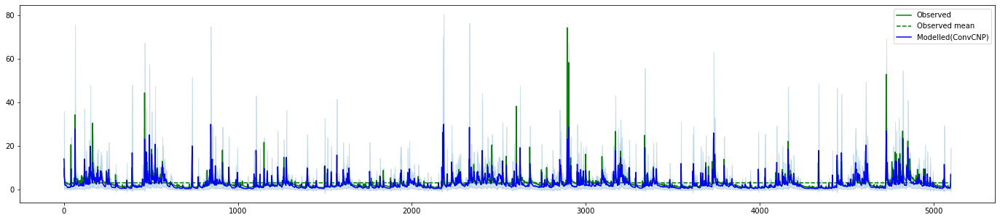

184. Basin hru_03439000 (period: 1996-2010): LL=-0.009 -- NSE=0.095 -- time=20.320


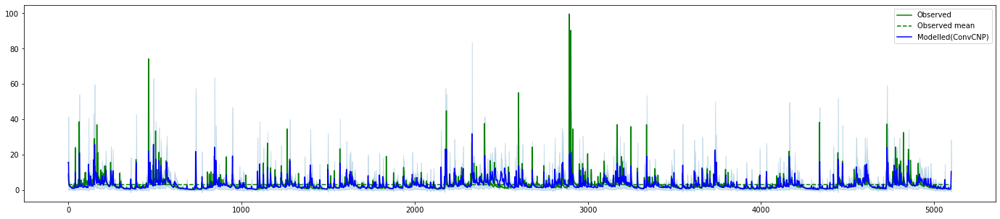

185. Basin hru_03455500 (period: 1996-2010): LL=-0.009 -- NSE=0.064 -- time=20.365


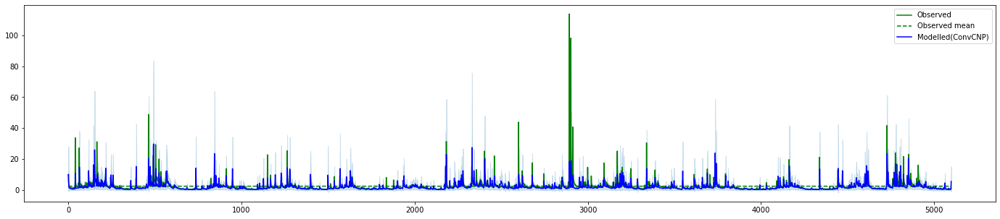

186. Basin hru_03456500 (period: 1996-2010): LL=-0.002 -- NSE=0.119 -- time=20.002


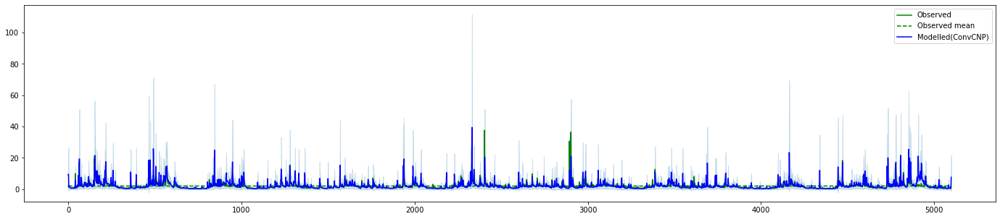

187. Basin hru_03460000 (period: 1996-2010): LL=0.002 -- NSE=0.335 -- time=20.368


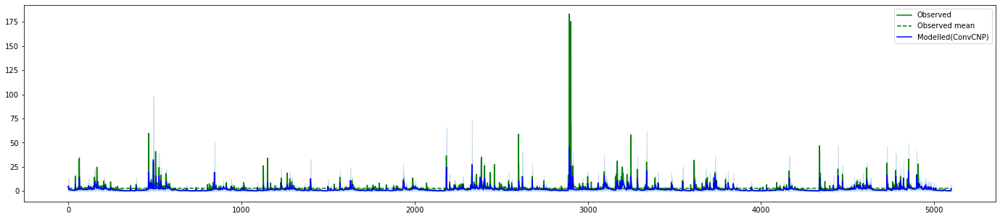

188. Basin hru_03463300 (period: 1996-2010): LL=-0.011 -- NSE=0.066 -- time=20.380


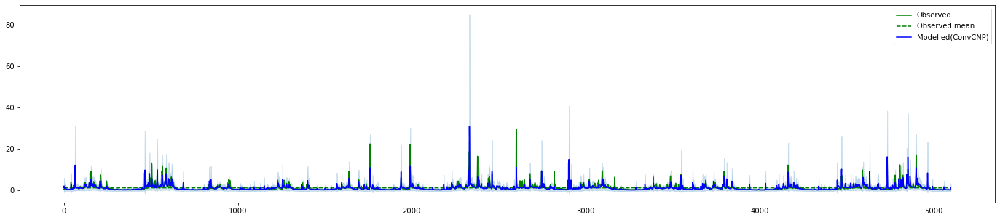

189. Basin hru_03471500 (period: 1996-2010): LL=0.013 -- NSE=0.294 -- time=20.447


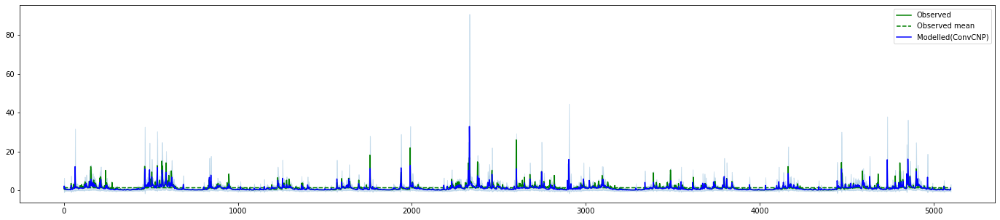

190. Basin hru_03473000 (period: 1996-2010): LL=0.012 -- NSE=0.328 -- time=20.236


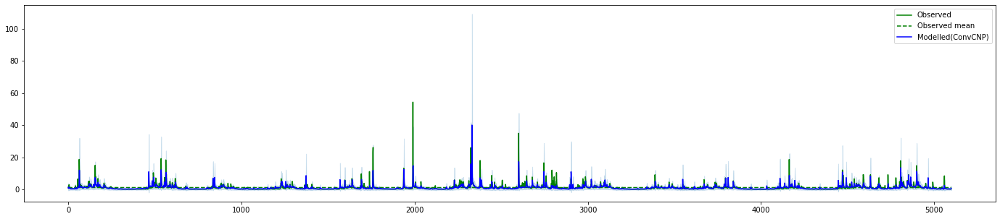

191. Basin hru_03488000 (period: 1996-2010): LL=0.014 -- NSE=0.257 -- time=20.337


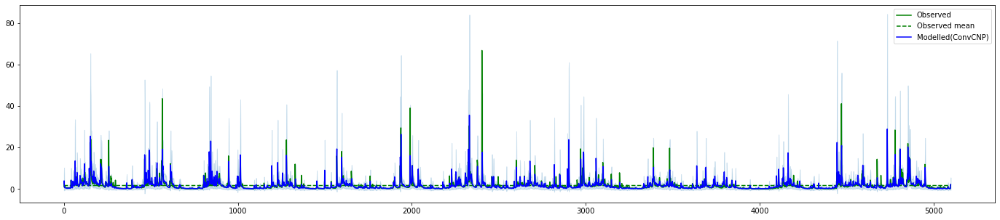

192. Basin hru_03498500 (period: 1996-2010): LL=0.008 -- NSE=0.304 -- time=20.283


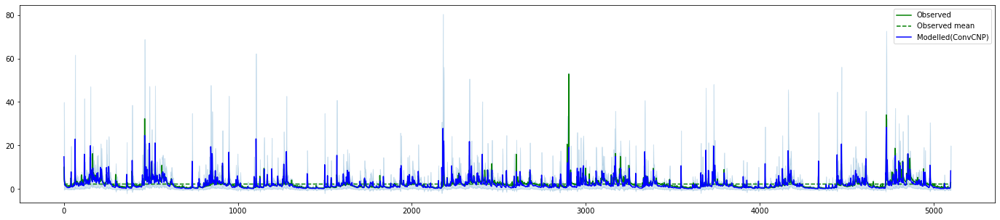

193. Basin hru_03500000 (period: 1996-2010): LL=-0.000 -- NSE=0.290 -- time=20.477


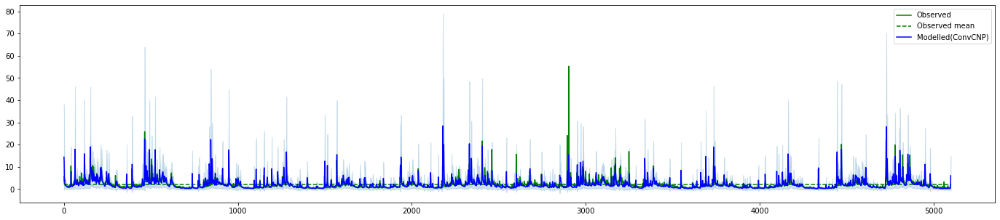

194. Basin hru_03500240 (period: 1996-2010): LL=0.002 -- NSE=0.289 -- time=20.374


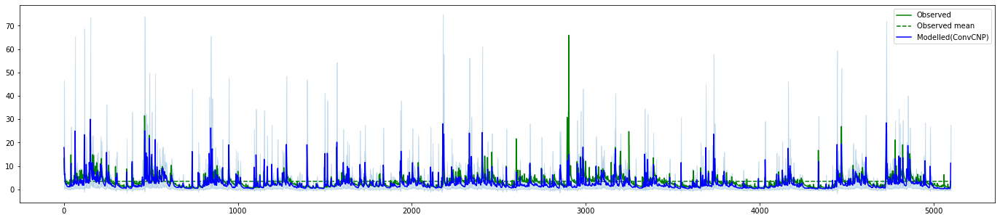

195. Basin hru_03504000 (period: 1996-2010): LL=-0.018 -- NSE=-0.103 -- time=20.392


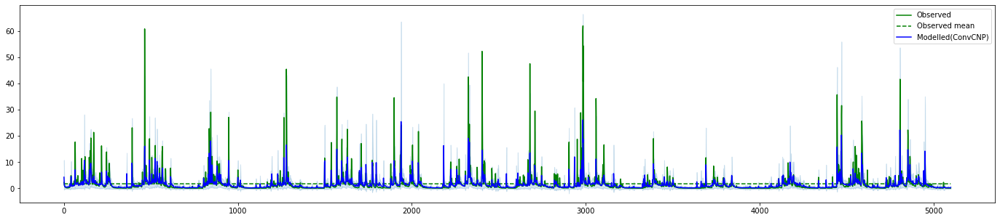

196. Basin hru_03574500 (period: 1996-2010): LL=0.008 -- NSE=0.193 -- time=20.208


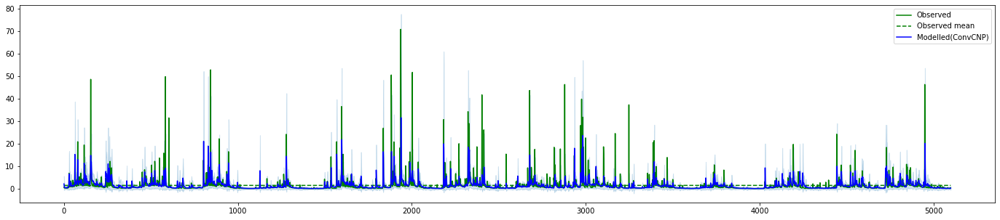

197. Basin hru_03592718 (period: 1996-2010): LL=0.004 -- NSE=0.157 -- time=20.310


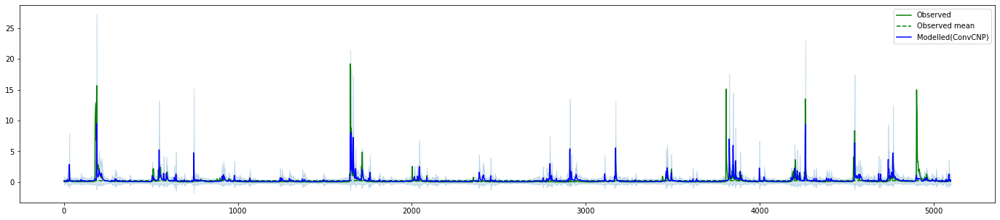

198. Basin hru_05291000 (period: 1996-2010): LL=0.026 -- NSE=-0.792 -- time=20.367


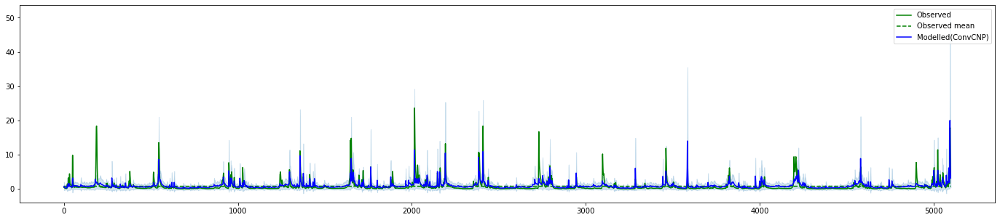

199. Basin hru_05362000 (period: 1996-2010): LL=0.012 -- NSE=0.120 -- time=20.308


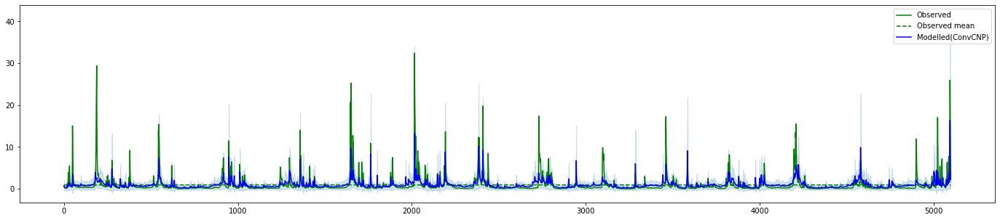

200. Basin hru_05393500 (period: 1996-2010): LL=0.011 -- NSE=0.141 -- time=20.278


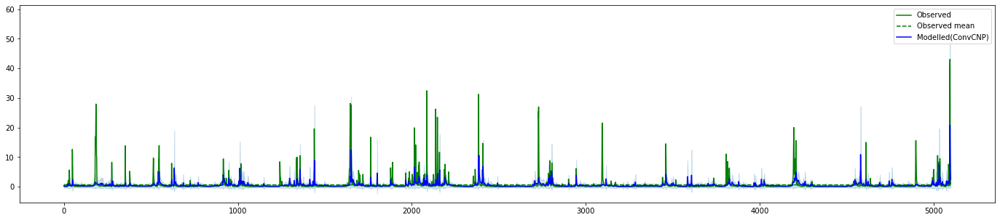

201. Basin hru_05399500 (period: 1996-2010): LL=0.011 -- NSE=0.049 -- time=20.314


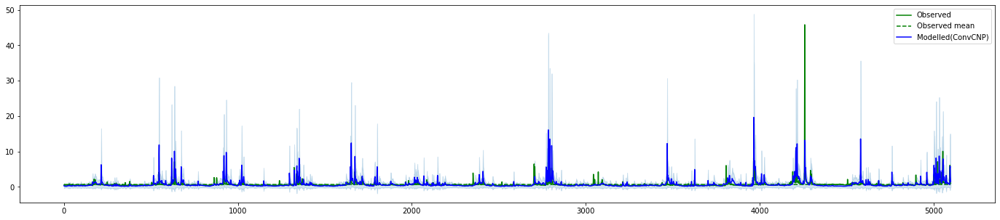

202. Basin hru_05408000 (period: 1996-2010): LL=0.019 -- NSE=-0.066 -- time=20.316


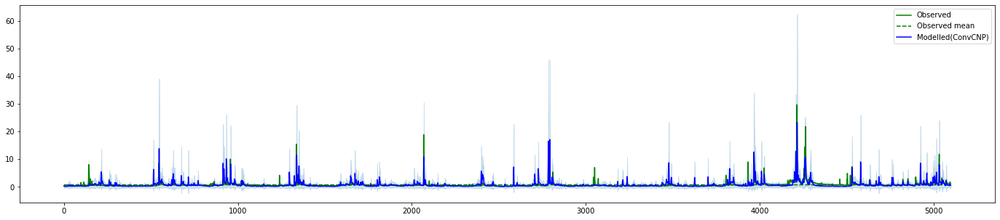

203. Basin hru_05413500 (period: 1996-2010): LL=0.015 -- NSE=0.042 -- time=20.020


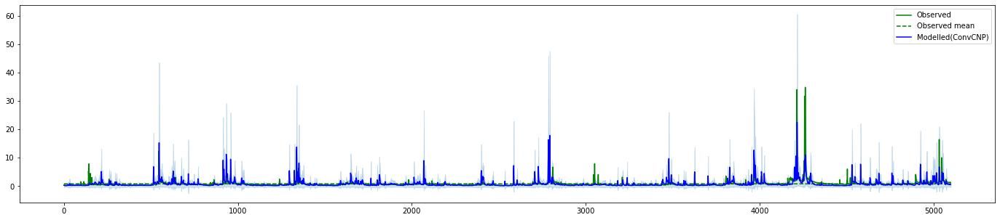

204. Basin hru_05414000 (period: 1996-2010): LL=0.015 -- NSE=0.104 -- time=20.101


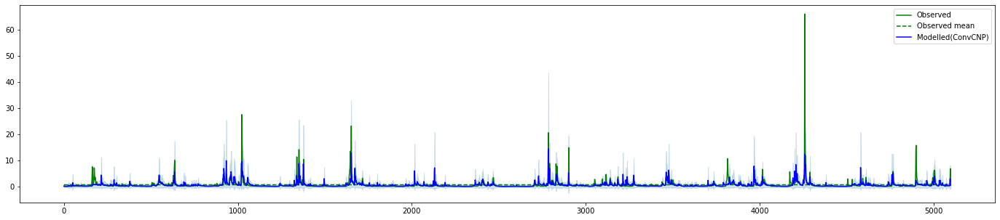

205. Basin hru_05458000 (period: 1996-2010): LL=0.019 -- NSE=0.123 -- time=20.446


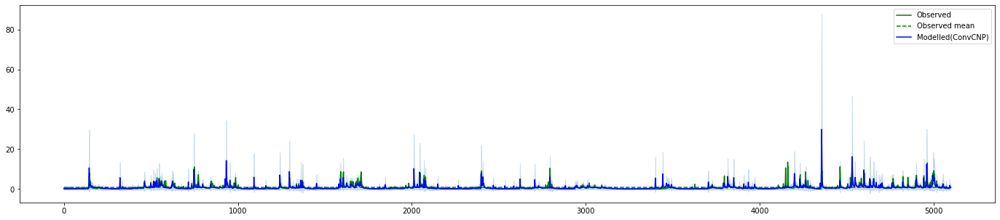

206. Basin hru_05466500 (period: 1996-2010): LL=0.016 -- NSE=0.202 -- time=20.298


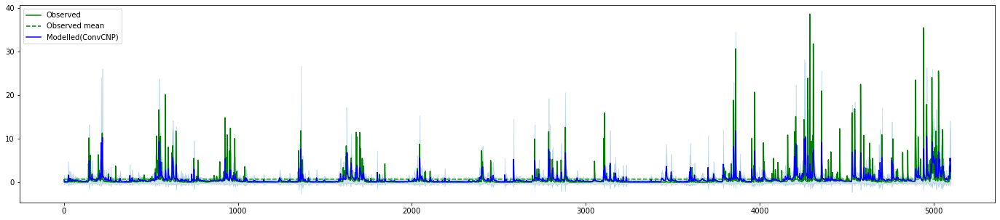

207. Basin hru_05487980 (period: 1996-2010): LL=0.012 -- NSE=0.116 -- time=20.384


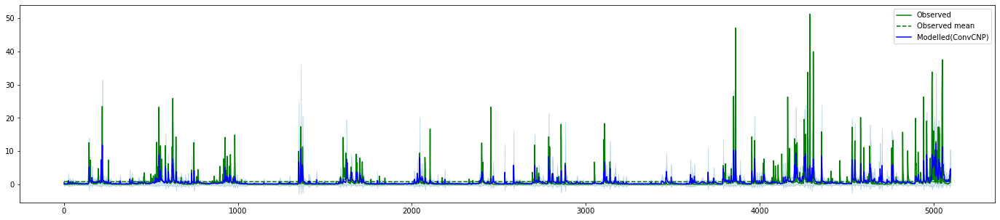

208. Basin hru_05488200 (period: 1996-2010): LL=0.008 -- NSE=0.113 -- time=20.427


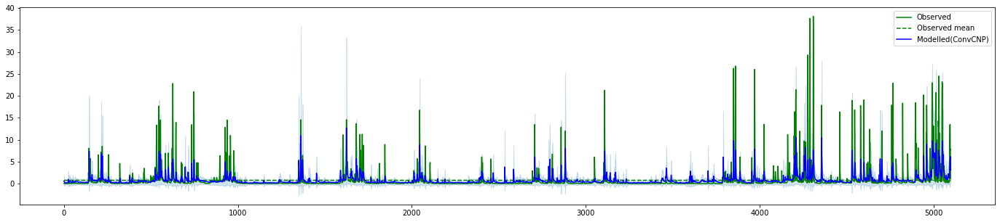

209. Basin hru_05489000 (period: 1996-2010): LL=0.009 -- NSE=0.114 -- time=20.355


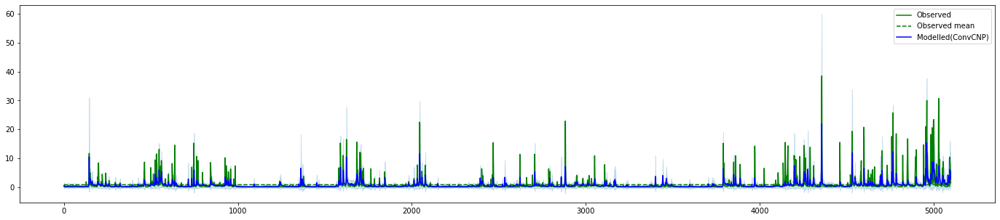

210. Basin hru_05495000 (period: 1996-2010): LL=0.012 -- NSE=0.150 -- time=19.954


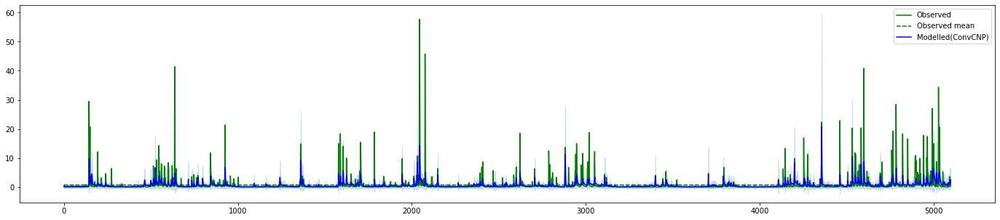

211. Basin hru_05495500 (period: 1996-2010): LL=0.011 -- NSE=0.090 -- time=20.425


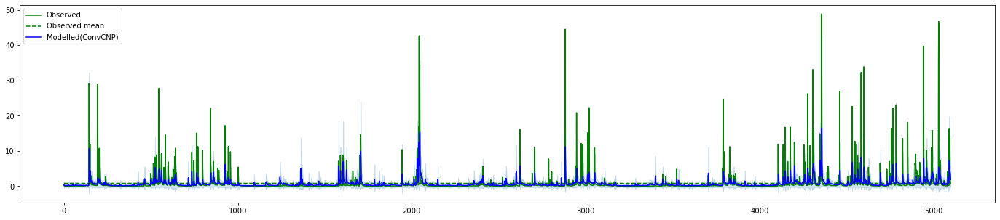

212. Basin hru_05501000 (period: 1996-2010): LL=0.010 -- NSE=0.104 -- time=20.399


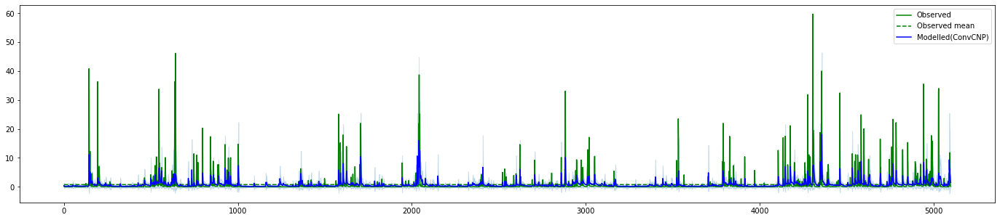

213. Basin hru_05503800 (period: 1996-2010): LL=0.007 -- NSE=0.095 -- time=20.275


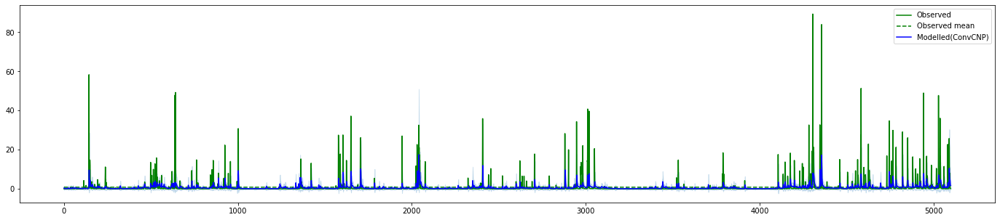

214. Basin hru_05507600 (period: 1996-2010): LL=0.002 -- NSE=0.070 -- time=20.524


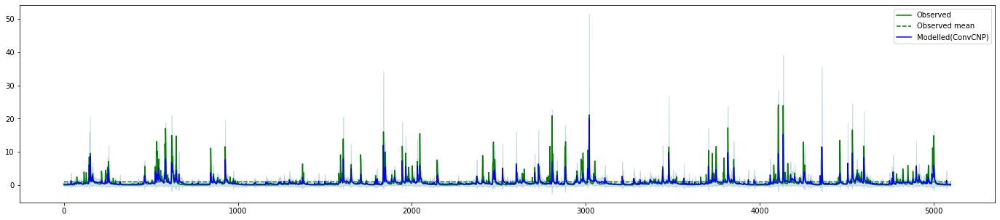

215. Basin hru_05525500 (period: 1996-2010): LL=0.013 -- NSE=0.189 -- time=20.239


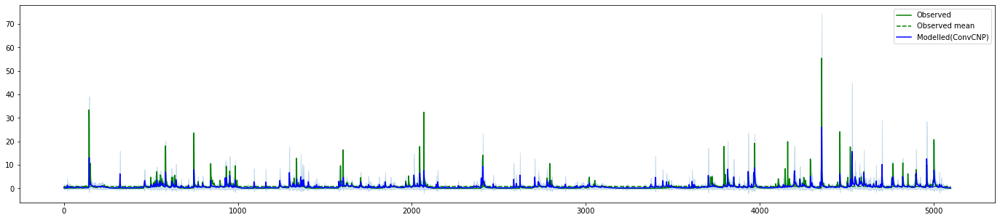

216. Basin hru_05556500 (period: 1996-2010): LL=0.015 -- NSE=0.173 -- time=20.339


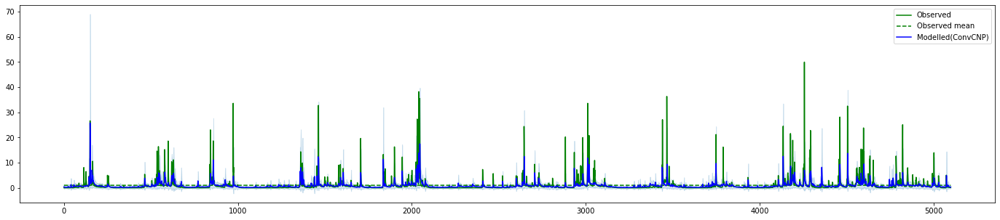

217. Basin hru_05591550 (period: 1996-2010): LL=0.011 -- NSE=0.161 -- time=20.130


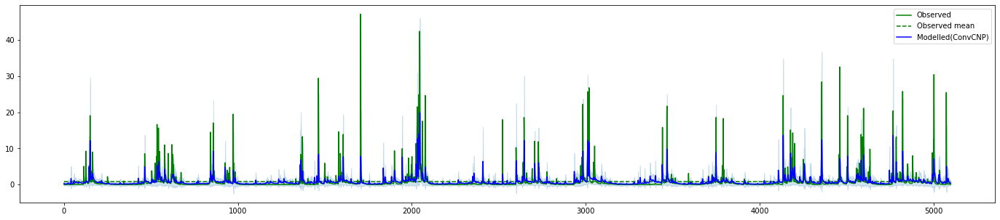

218. Basin hru_05592050 (period: 1996-2010): LL=0.012 -- NSE=0.149 -- time=20.376


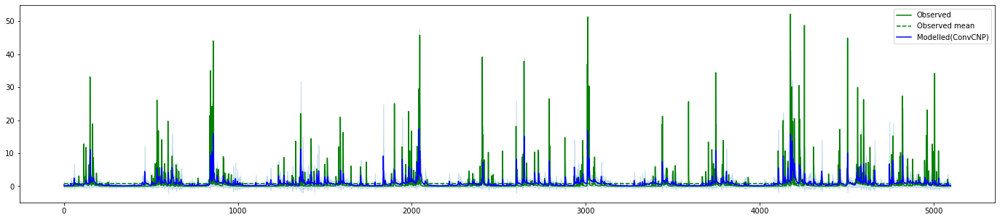

219. Basin hru_05592575 (period: 1996-2010): LL=-0.000 -- NSE=0.084 -- time=20.889


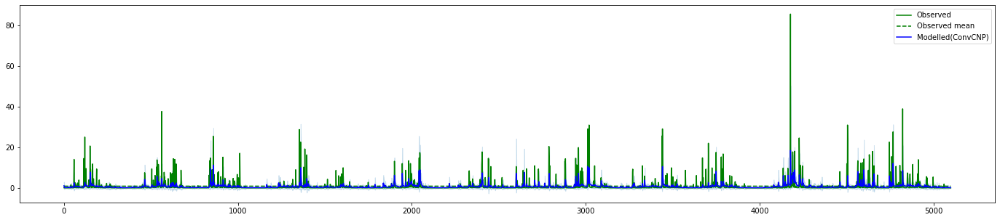

220. Basin hru_05593575 (period: 1996-2010): LL=0.005 -- NSE=0.106 -- time=20.258


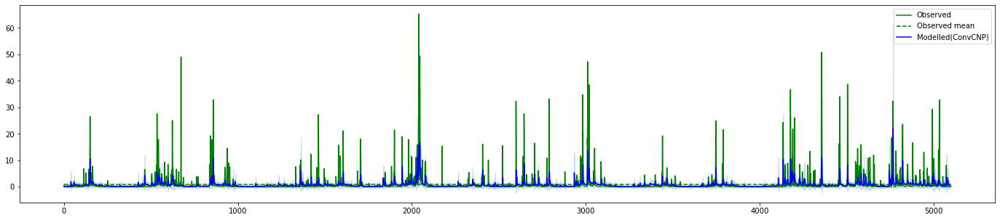

221. Basin hru_05593900 (period: 1996-2010): LL=0.001 -- NSE=0.092 -- time=20.511


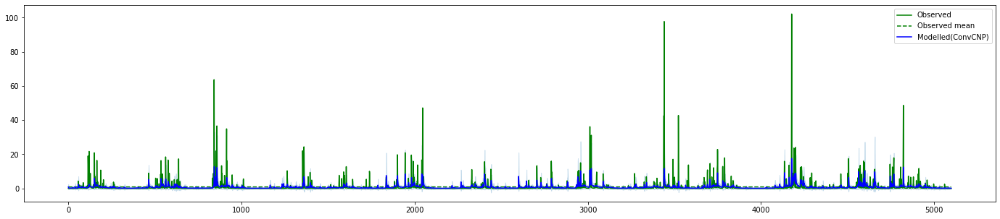

222. Basin hru_05595730 (period: 1996-2010): LL=0.006 -- NSE=0.098 -- time=20.527


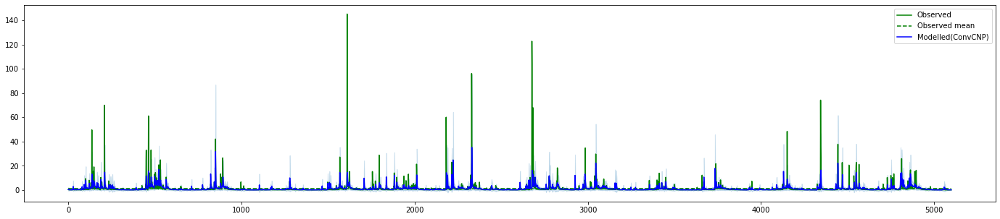

223. Basin hru_07291000 (period: 1996-2010): LL=0.009 -- NSE=0.113 -- time=20.586


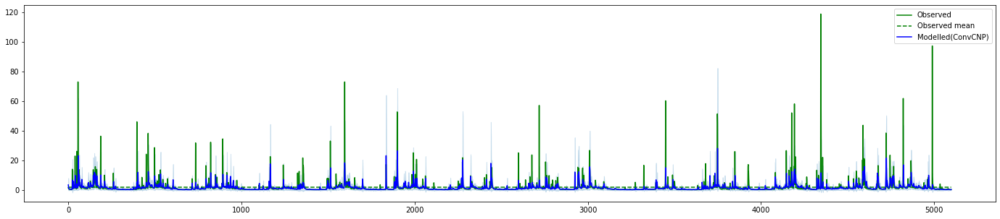

224. Basin hru_07359610 (period: 1996-2010): LL=0.004 -- NSE=0.118 -- time=20.374


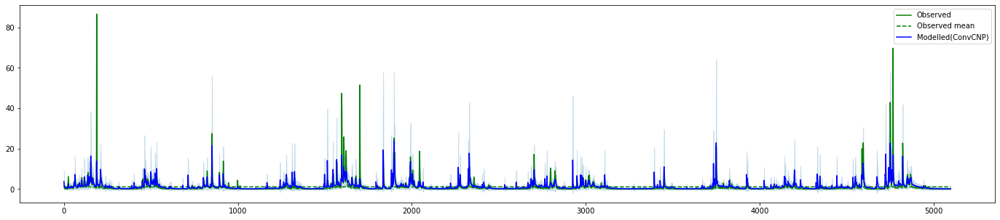

225. Basin hru_07362100 (period: 1996-2010): LL=0.010 -- NSE=0.200 -- time=20.279


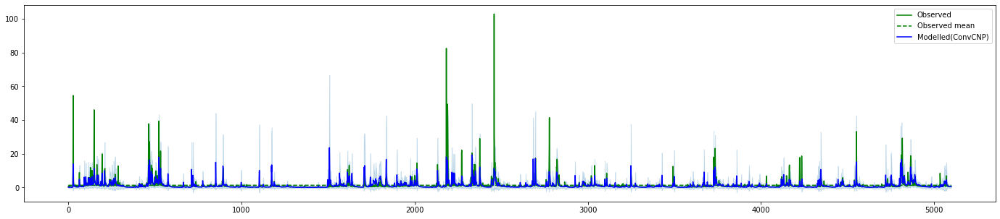

226. Basin hru_07375000 (period: 1996-2010): LL=0.009 -- NSE=0.179 -- time=20.591


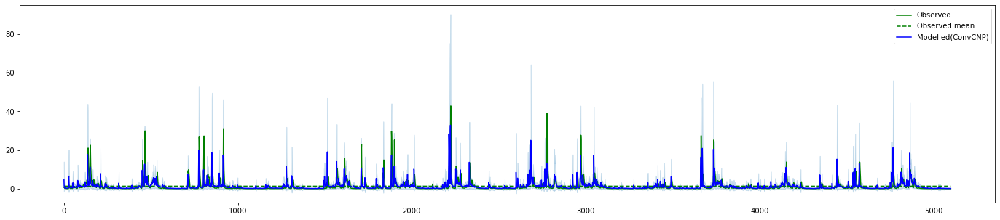

227. Basin hru_08013000 (period: 1996-2010): LL=0.003 -- NSE=0.181 -- time=20.496


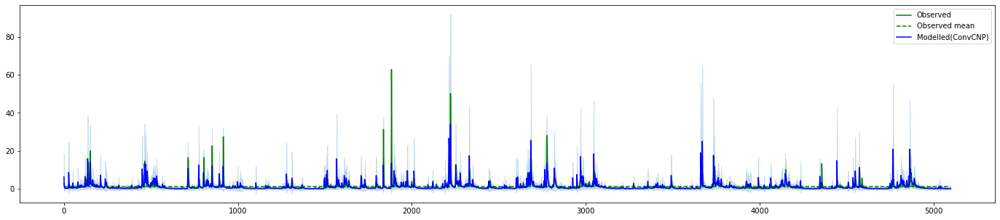

228. Basin hru_08014500 (period: 1996-2010): LL=0.011 -- NSE=0.243 -- time=20.515


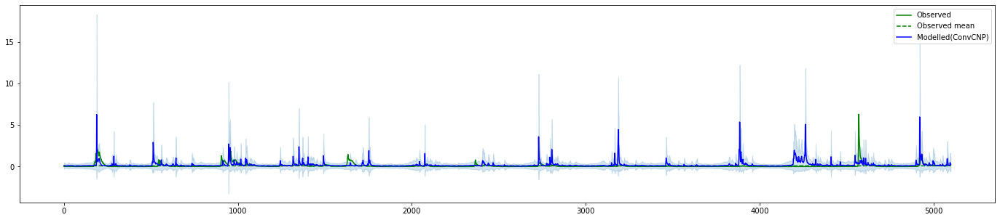

229. Basin hru_05120500 (period: 1996-2010): LL=0.036 -- NSE=-12.849 -- time=20.296


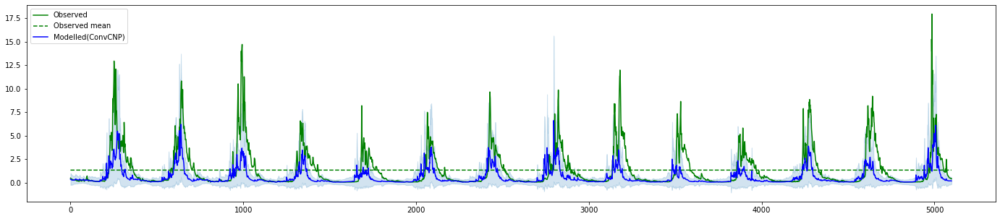

230. Basin hru_06224000 (period: 1996-2010): LL=-0.011 -- NSE=0.134 -- time=20.390


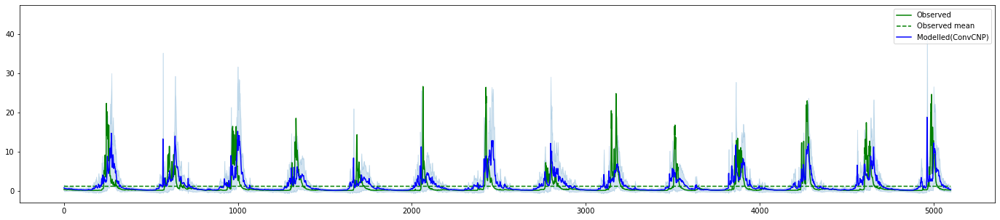

231. Basin hru_06278300 (period: 1996-2010): LL=0.011 -- NSE=0.170 -- time=20.433


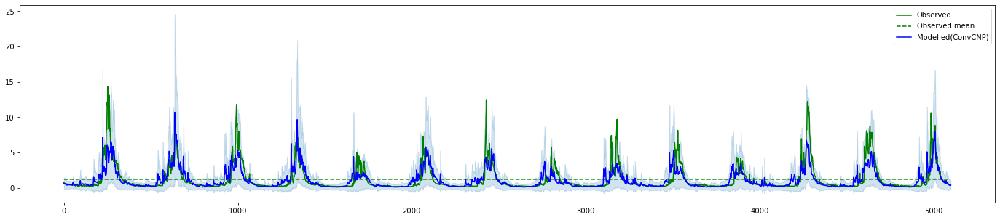

232. Basin hru_06280300 (period: 1996-2010): LL=0.016 -- NSE=0.274 -- time=20.204


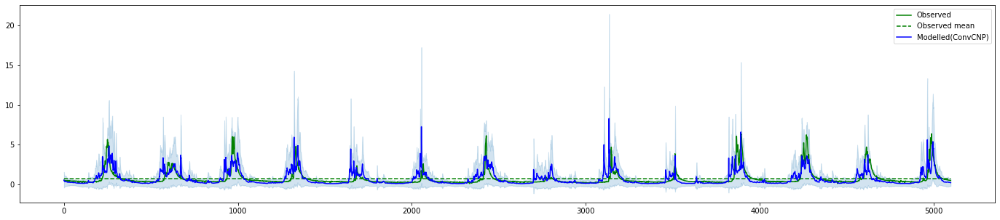

233. Basin hru_06289000 (period: 1996-2010): LL=0.021 -- NSE=-0.008 -- time=20.254


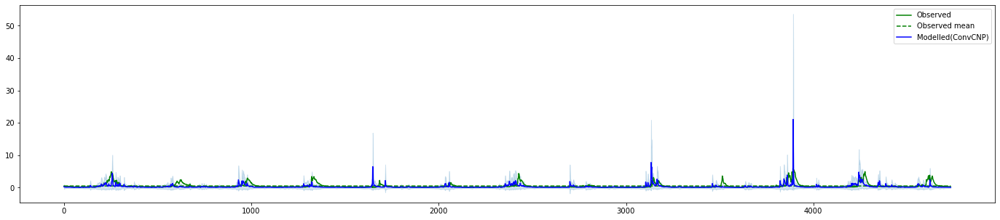

234. Basin hru_06291500 (period: 1996-2009): LL=0.017 -- NSE=-0.531 -- time=19.695


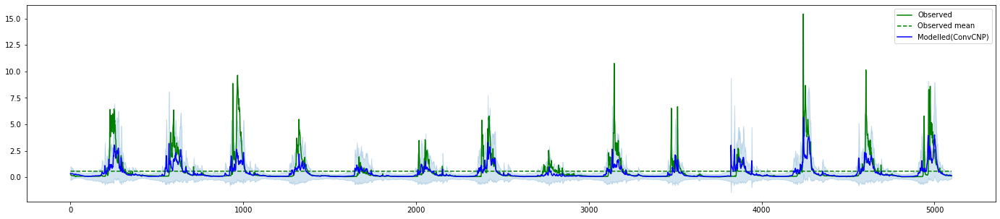

235. Basin hru_06311000 (period: 1996-2010): LL=0.029 -- NSE=-0.050 -- time=20.509


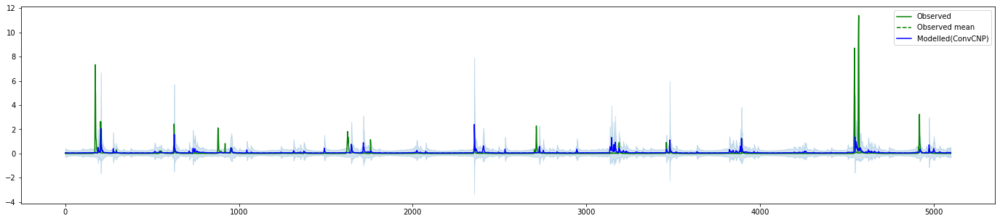

236. Basin hru_06350000 (period: 1996-2010): LL=0.038 -- NSE=-5.688 -- time=20.121


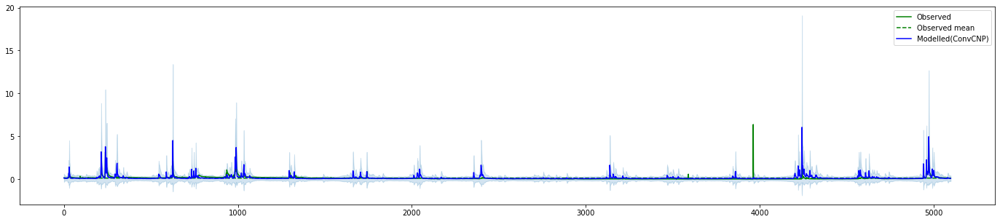

237. Basin hru_06406000 (period: 1996-2010): LL=0.040 -- NSE=-19.129 -- time=20.509


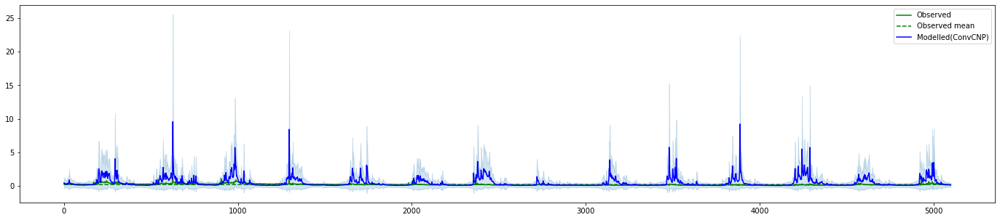

238. Basin hru_06409000 (period: 1996-2010): LL=0.029 -- NSE=-57.554 -- time=20.727


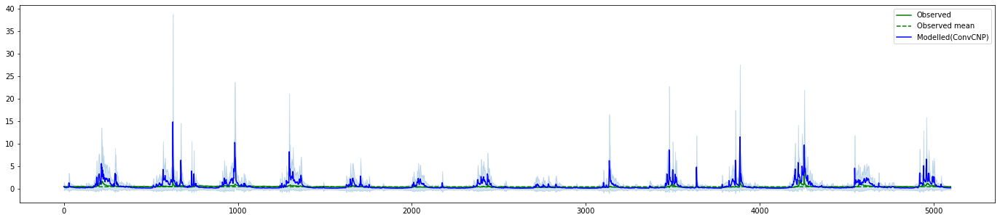

239. Basin hru_06431500 (period: 1996-2010): LL=0.022 -- NSE=-14.034 -- time=20.511


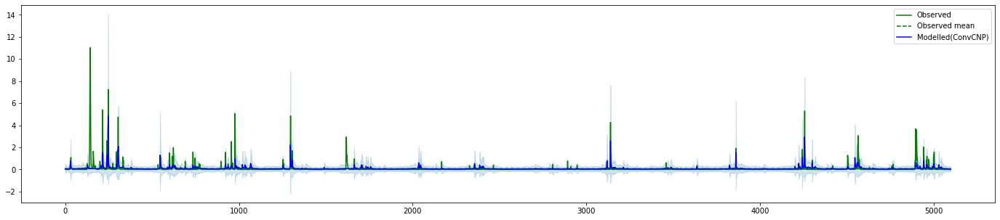

240. Basin hru_06440200 (period: 1996-2010): LL=0.039 -- NSE=-5.143 -- time=20.509


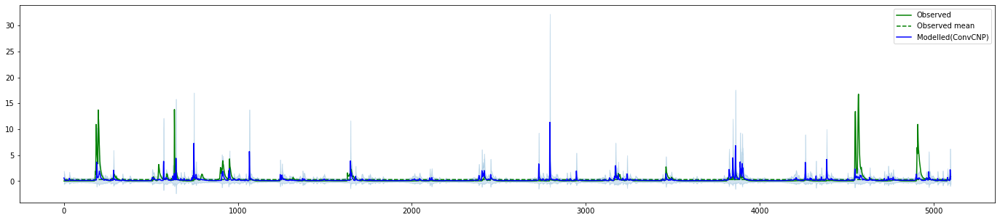

241. Basin hru_06470800 (period: 1996-2010): LL=0.024 -- NSE=-0.505 -- time=20.608


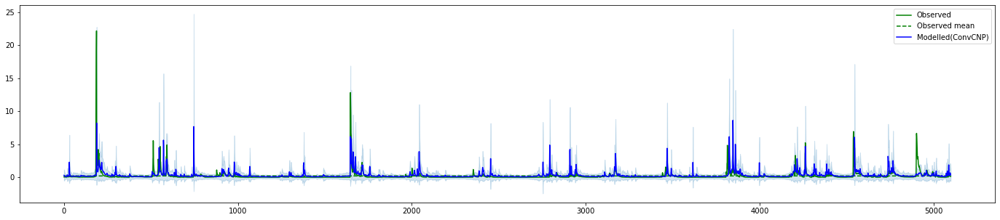

242. Basin hru_06479215 (period: 1996-2010): LL=0.028 -- NSE=-1.274 -- time=20.518


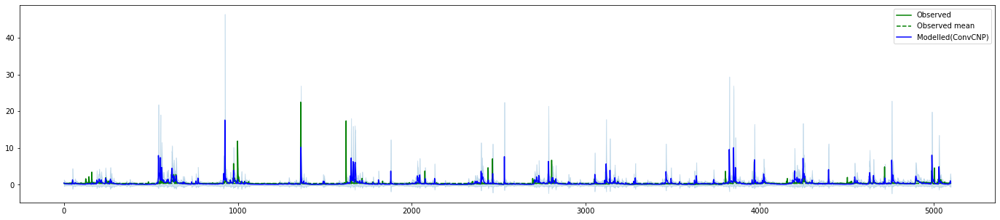

243. Basin hru_06601000 (period: 1996-2010): LL=0.026 -- NSE=-1.643 -- time=20.538


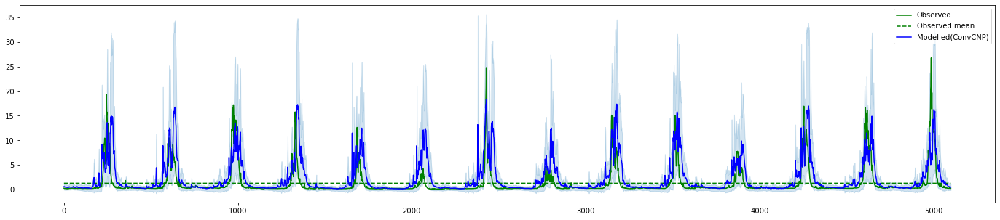

244. Basin hru_06622700 (period: 1996-2010): LL=0.011 -- NSE=0.339 -- time=20.554


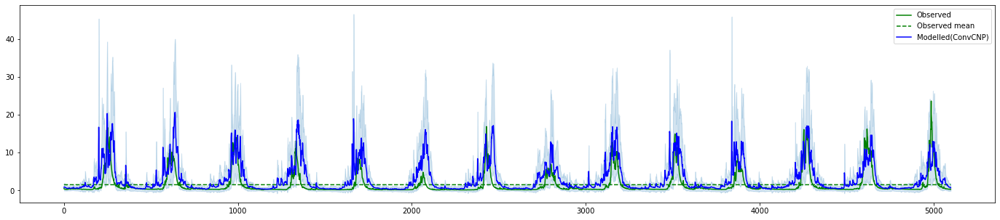

245. Basin hru_06623800 (period: 1996-2010): LL=0.001 -- NSE=0.381 -- time=20.618


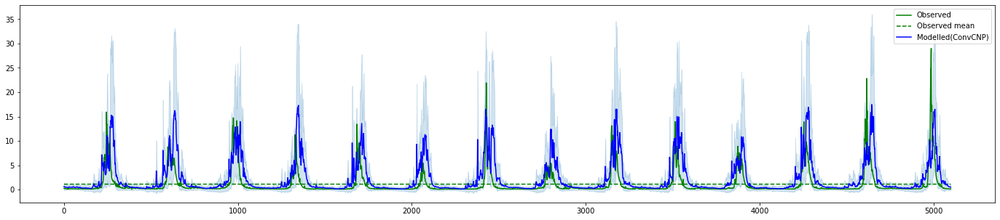

246. Basin hru_06632400 (period: 1996-2010): LL=0.010 -- NSE=0.328 -- time=20.553


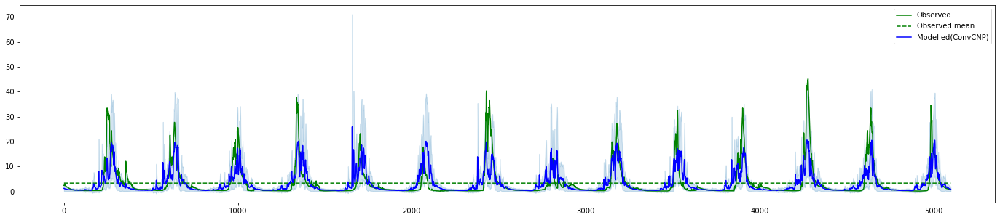

247. Basin hru_06746095 (period: 1996-2010): LL=-0.002 -- NSE=0.185 -- time=20.385


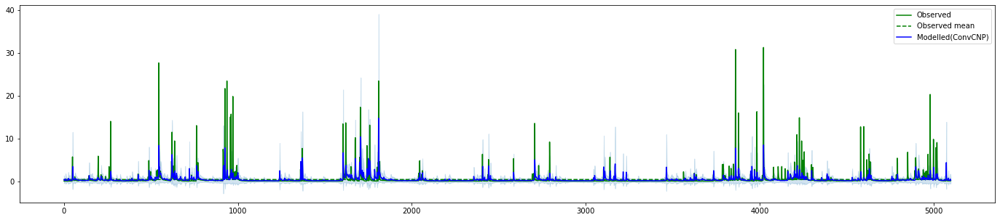

248. Basin hru_06814000 (period: 1996-2010): LL=0.023 -- NSE=-0.101 -- time=20.474


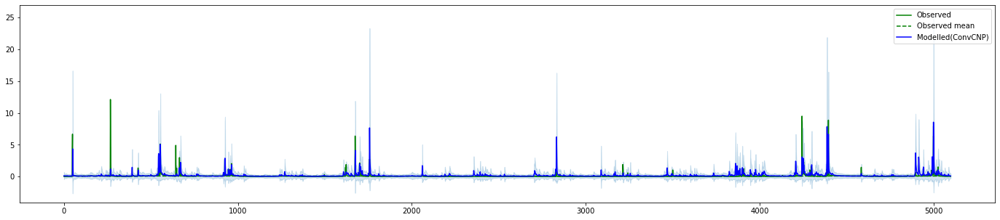

249. Basin hru_06853800 (period: 1996-2010): LL=0.036 -- NSE=-5.348 -- time=20.436


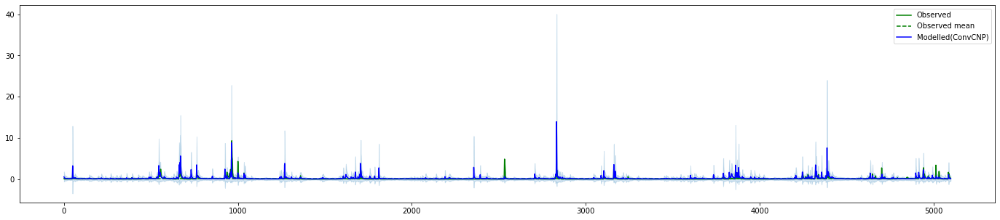

250. Basin hru_06876700 (period: 1996-2010): LL=0.036 -- NSE=-6.071 -- time=20.103


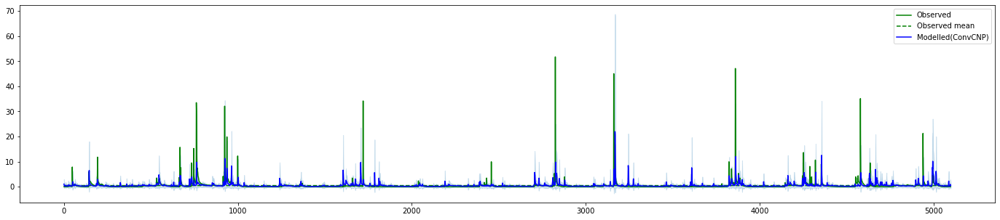

251. Basin hru_06879650 (period: 1996-2010): LL=0.017 -- NSE=-0.032 -- time=20.362


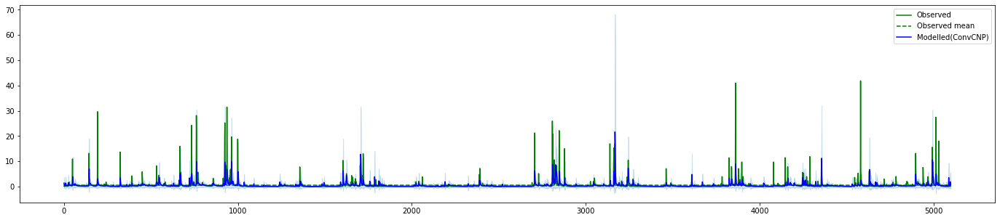

252. Basin hru_06888500 (period: 1996-2010): LL=0.018 -- NSE=0.041 -- time=20.135


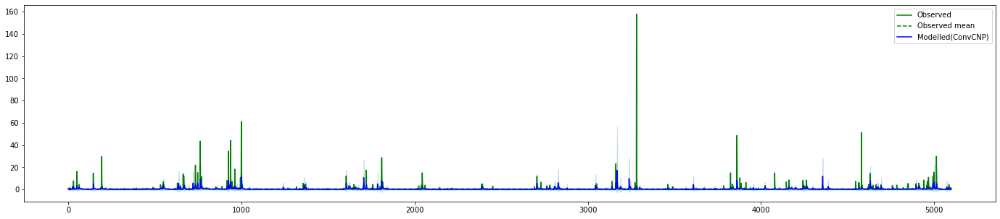

253. Basin hru_06889200 (period: 1996-2010): LL=0.017 -- NSE=0.022 -- time=20.432


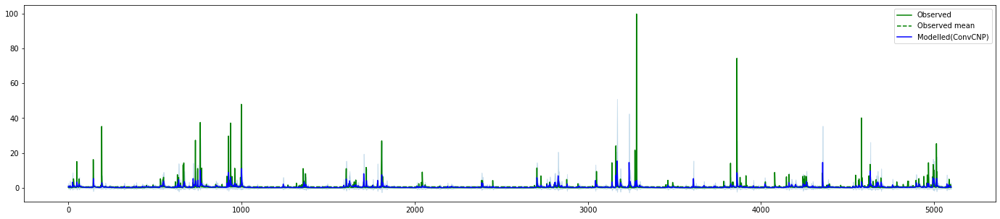

254. Basin hru_06889500 (period: 1996-2010): LL=0.019 -- NSE=0.027 -- time=20.485


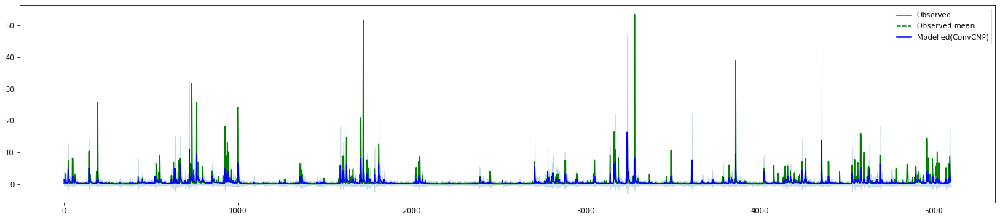

255. Basin hru_06892000 (period: 1996-2010): LL=0.019 -- NSE=0.087 -- time=20.416


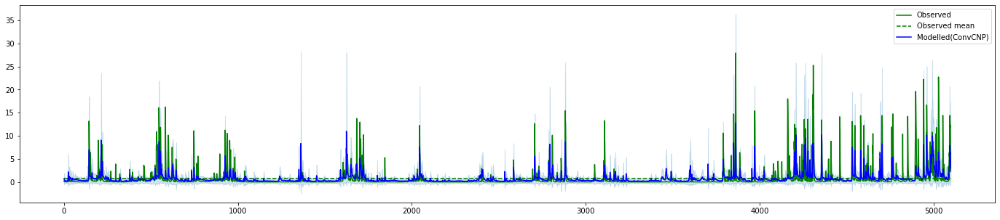

256. Basin hru_06903400 (period: 1996-2010): LL=0.009 -- NSE=0.141 -- time=20.649


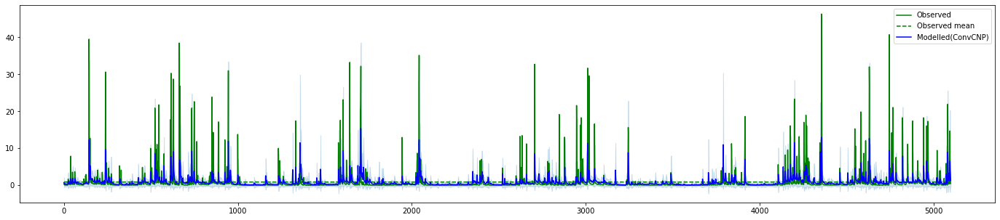

257. Basin hru_06906800 (period: 1996-2010): LL=0.010 -- NSE=0.120 -- time=20.566


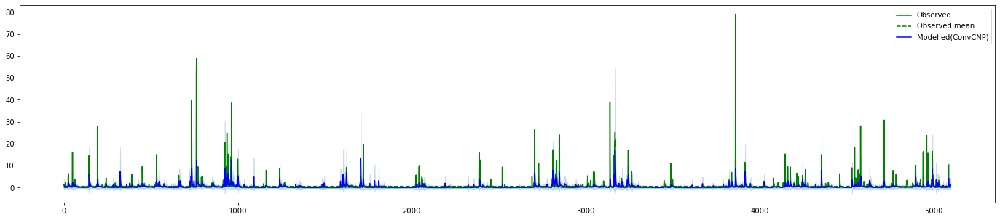

258. Basin hru_06910800 (period: 1996-2010): LL=0.015 -- NSE=0.053 -- time=20.588


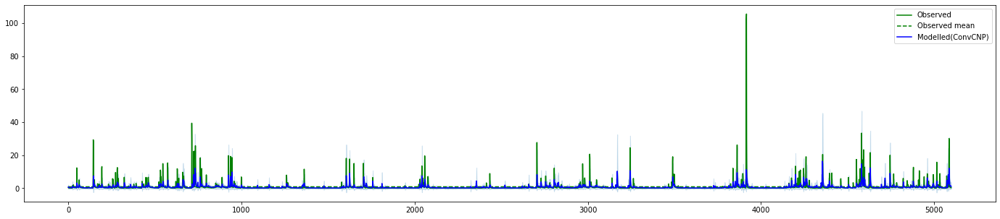

259. Basin hru_06917000 (period: 1996-2010): LL=0.015 -- NSE=0.109 -- time=20.574


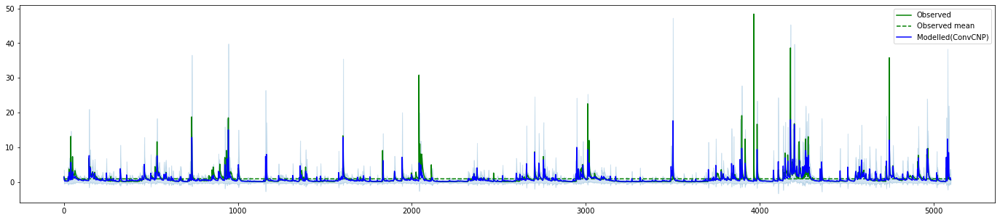

260. Basin hru_06918460 (period: 1996-2010): LL=0.016 -- NSE=0.189 -- time=20.591


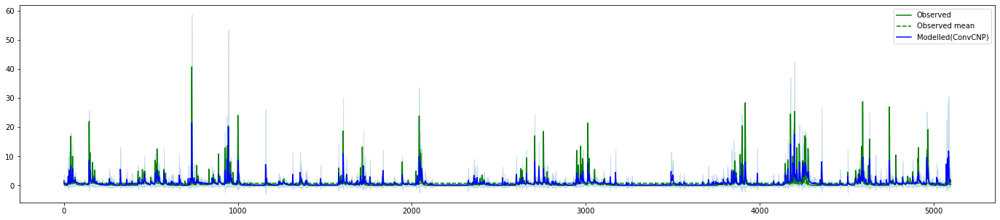

261. Basin hru_06919500 (period: 1996-2010): LL=0.015 -- NSE=0.177 -- time=20.445


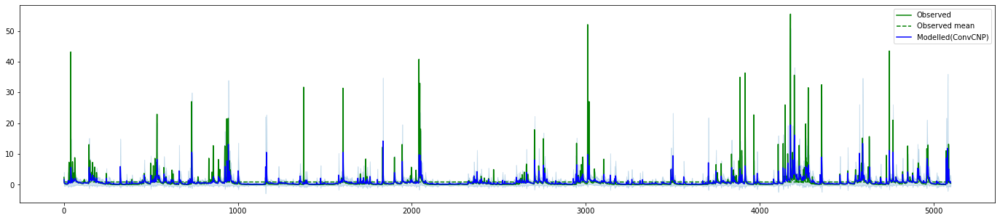

262. Basin hru_06921070 (period: 1996-2010): LL=0.013 -- NSE=0.124 -- time=20.489


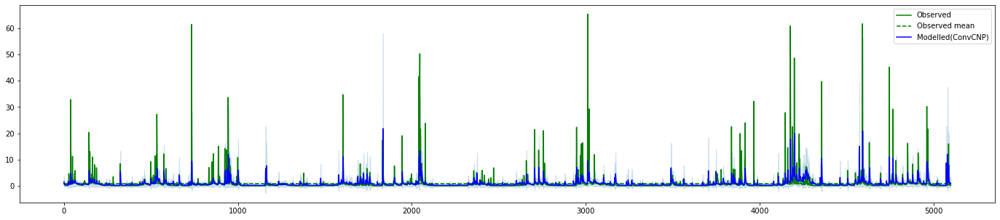

263. Basin hru_06921200 (period: 1996-2010): LL=0.008 -- NSE=0.085 -- time=20.679


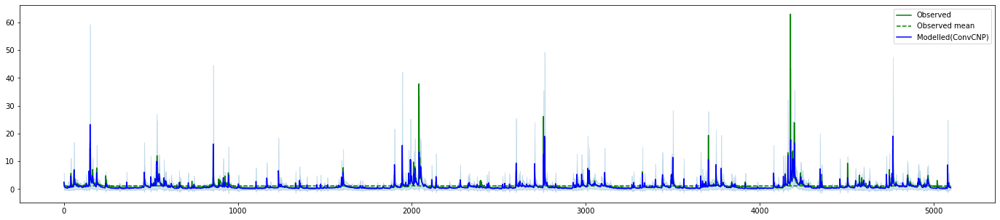

264. Basin hru_07057500 (period: 1996-2010): LL=0.013 -- NSE=0.289 -- time=20.589


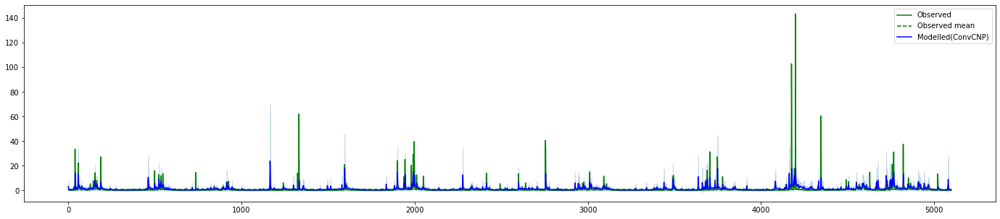

265. Basin hru_07060710 (period: 1996-2010): LL=0.006 -- NSE=0.072 -- time=20.526


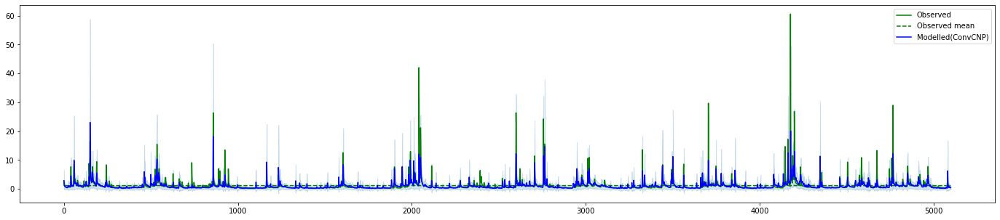

266. Basin hru_07066000 (period: 1996-2010): LL=0.015 -- NSE=0.238 -- time=20.594


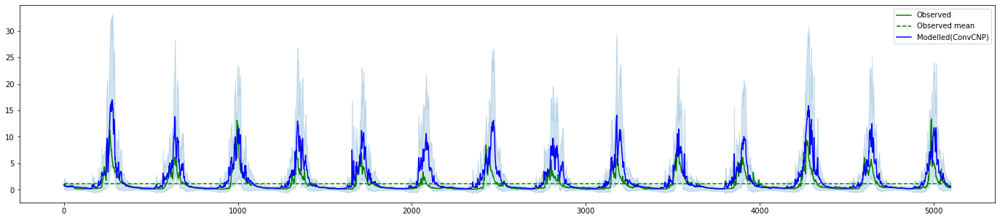

267. Basin hru_07083000 (period: 1996-2010): LL=0.014 -- NSE=0.478 -- time=20.500


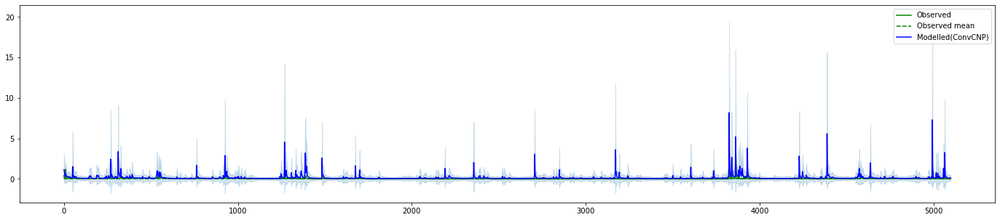

268. Basin hru_07142300 (period: 1996-2010): LL=0.040 -- NSE=-163.680 -- time=20.459


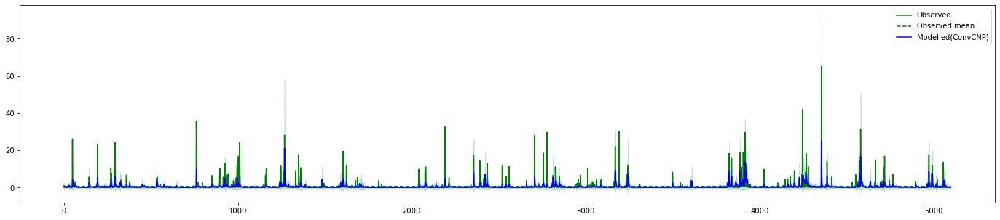

269. Basin hru_07145700 (period: 1996-2010): LL=0.021 -- NSE=0.101 -- time=20.105


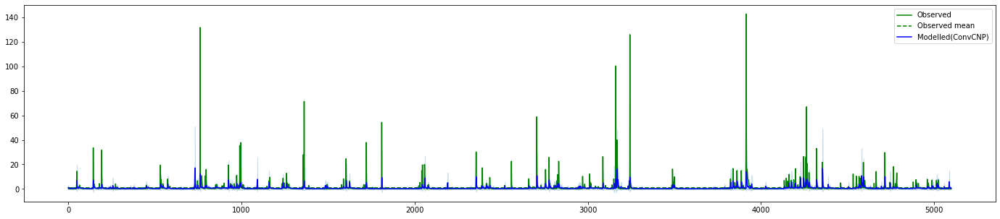

270. Basin hru_07167500 (period: 1996-2010): LL=0.010 -- NSE=0.056 -- time=20.344


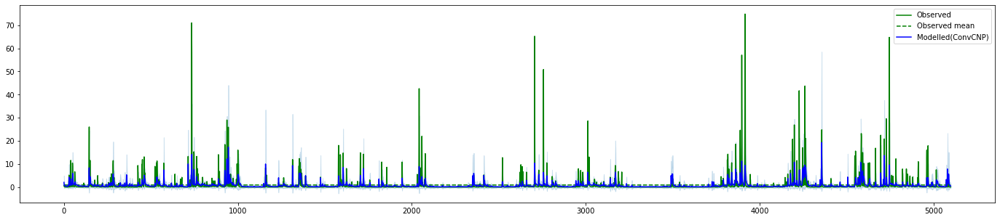

271. Basin hru_07184000 (period: 1996-2010): LL=0.011 -- NSE=0.113 -- time=20.090


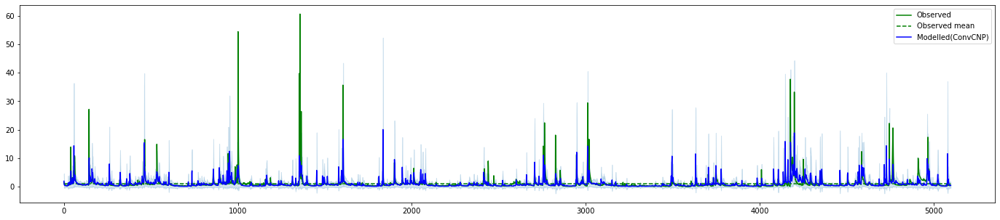

272. Basin hru_07195800 (period: 1996-2010): LL=0.013 -- NSE=0.158 -- time=20.534


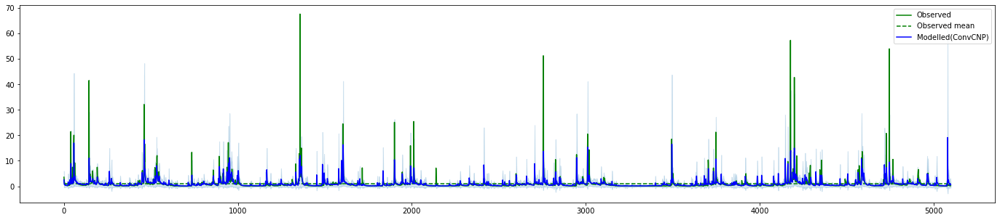

273. Basin hru_07197000 (period: 1996-2010): LL=0.015 -- NSE=0.174 -- time=20.174


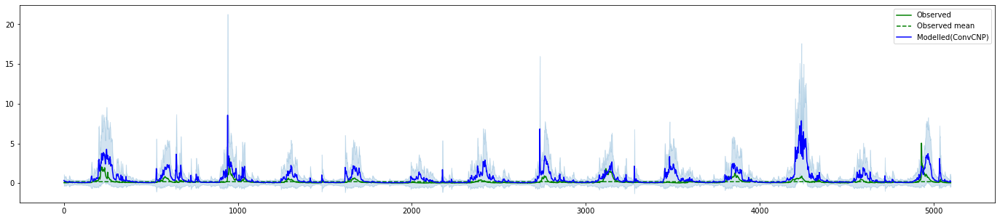

274. Basin hru_07208500 (period: 1996-2010): LL=0.028 -- NSE=-11.077 -- time=20.612


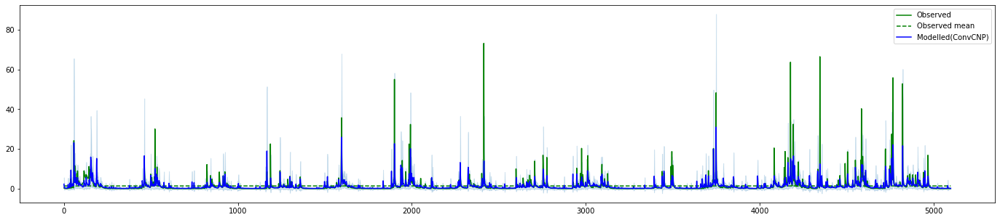

275. Basin hru_07261000 (period: 1996-2010): LL=0.011 -- NSE=0.219 -- time=20.529


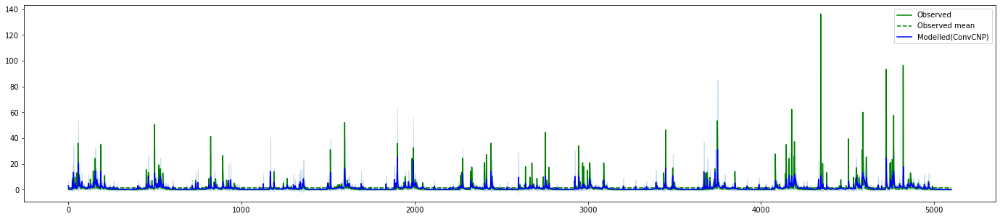

276. Basin hru_07263295 (period: 1996-2010): LL=0.004 -- NSE=0.127 -- time=20.434


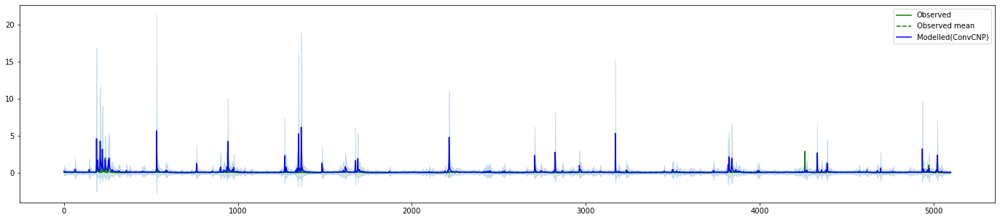

277. Basin hru_07301410 (period: 1996-2010): LL=0.043 -- NSE=-131.057 -- time=20.419


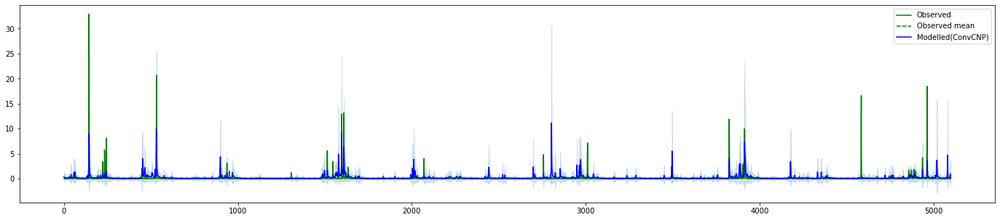

278. Basin hru_07315200 (period: 1996-2010): LL=0.034 -- NSE=-0.852 -- time=19.987


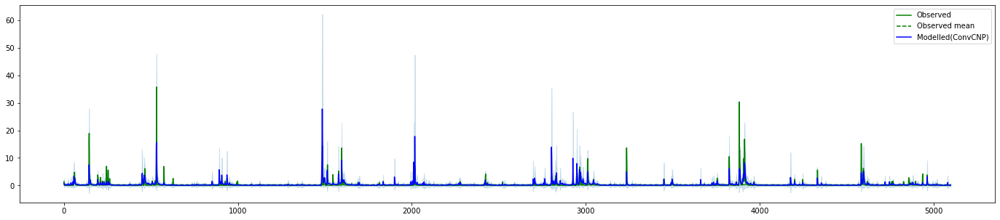

279. Basin hru_07315700 (period: 1996-2010): LL=0.029 -- NSE=-0.190 -- time=20.622


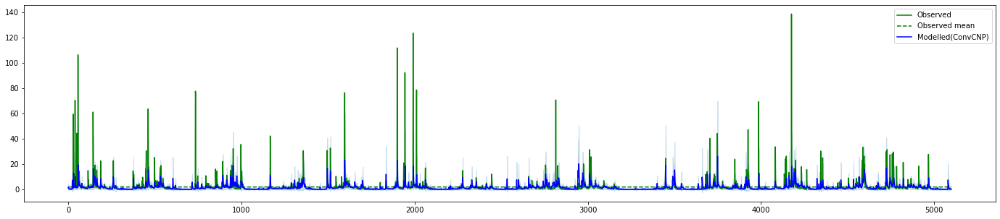

280. Basin hru_07335700 (period: 1996-2010): LL=-0.007 -- NSE=0.078 -- time=20.354


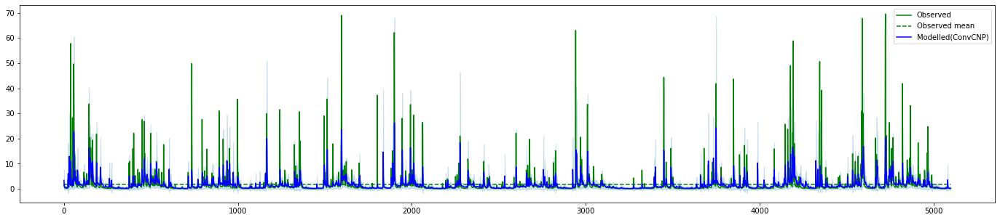

281. Basin hru_07340300 (period: 1996-2010): LL=-0.000 -- NSE=0.137 -- time=20.654


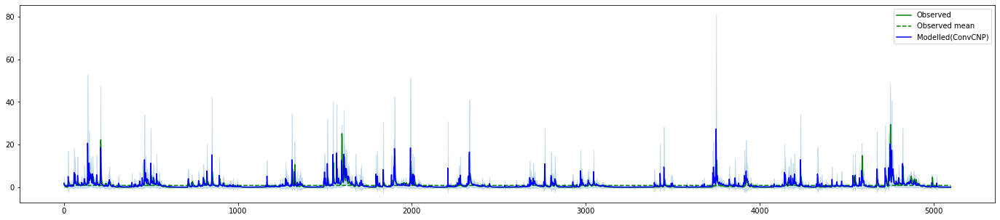

282. Basin hru_07346045 (period: 1996-2010): LL=0.014 -- NSE=0.217 -- time=20.447


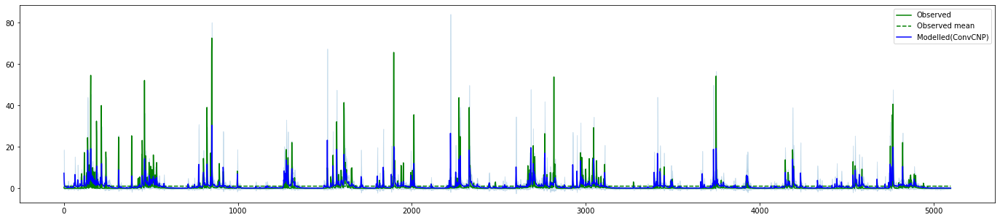

283. Basin hru_08023080 (period: 1996-2010): LL=0.010 -- NSE=0.187 -- time=20.395


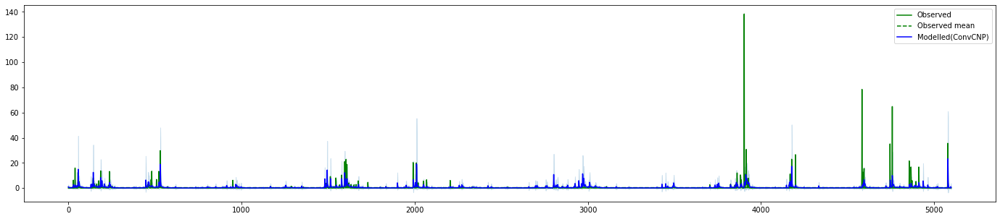

284. Basin hru_08050800 (period: 1996-2010): LL=0.018 -- NSE=-0.013 -- time=20.374


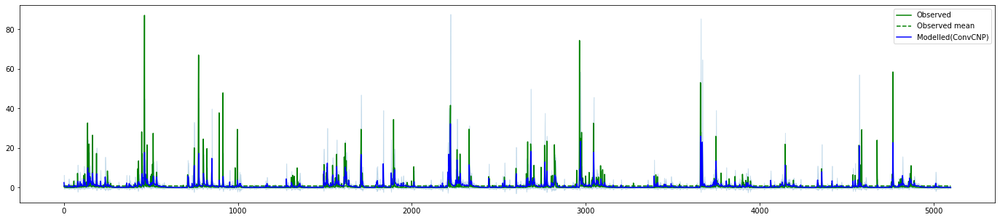

285. Basin hru_08066200 (period: 1996-2010): LL=0.006 -- NSE=0.125 -- time=20.476


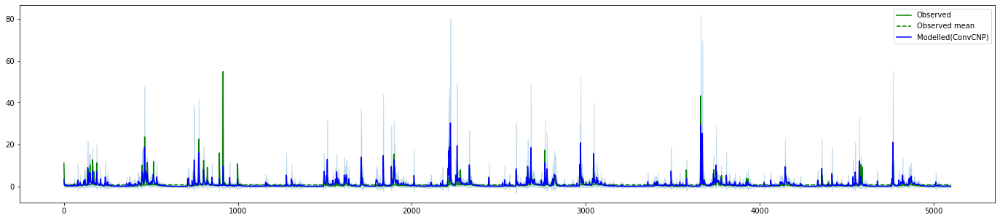

286. Basin hru_08066300 (period: 1996-2010): LL=0.016 -- NSE=0.245 -- time=20.408


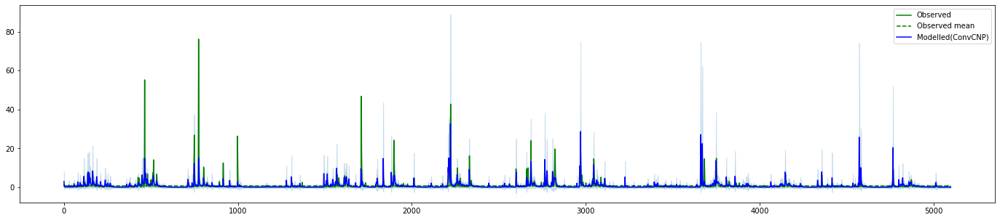

287. Basin hru_08070000 (period: 1996-2010): LL=0.017 -- NSE=0.156 -- time=21.745


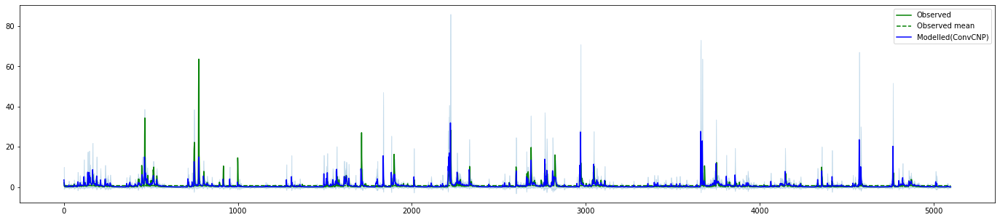

288. Basin hru_08070200 (period: 1996-2010): LL=0.016 -- NSE=0.148 -- time=20.180


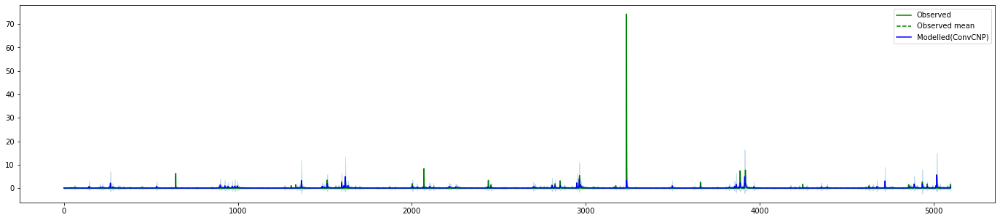

289. Basin hru_08082700 (period: 1996-2010): LL=0.038 -- NSE=-0.629 -- time=20.396


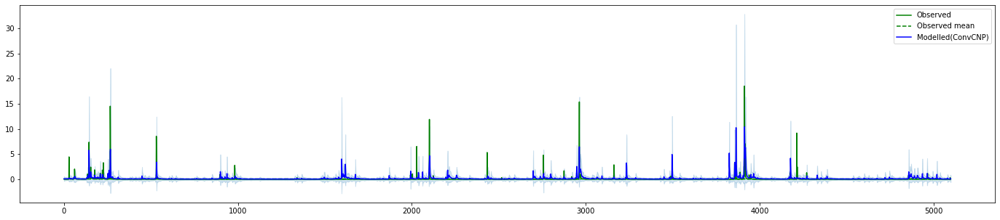

290. Basin hru_08086212 (period: 1996-2010): LL=0.036 -- NSE=-2.379 -- time=20.700


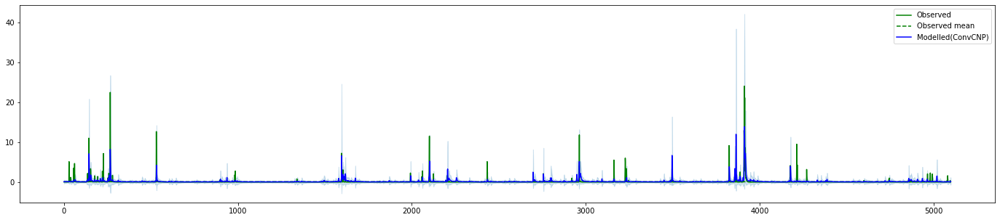

291. Basin hru_08086290 (period: 1996-2010): LL=0.037 -- NSE=-1.089 -- time=20.499


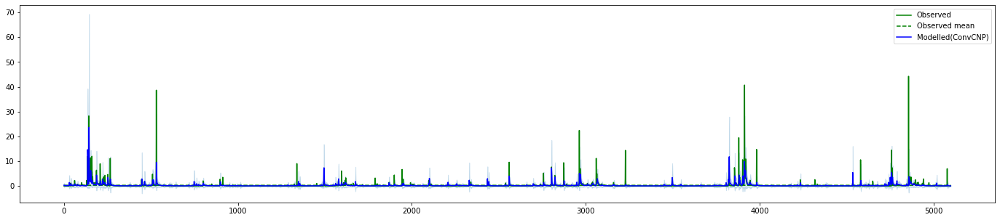

292. Basin hru_08101000 (period: 1996-2010): LL=0.029 -- NSE=-0.115 -- time=20.447


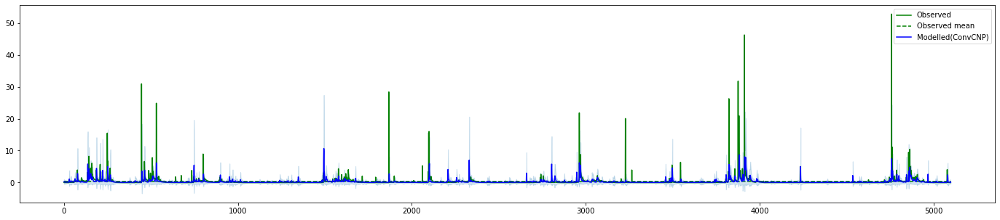

293. Basin hru_08103900 (period: 1996-2010): LL=0.001 -- NSE=-0.088 -- time=20.350


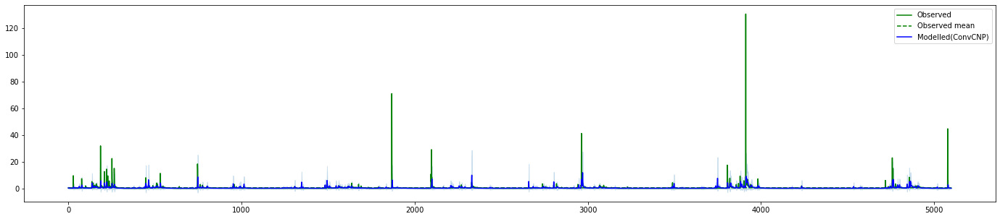

294. Basin hru_08104900 (period: 1996-2010): LL=0.021 -- NSE=-0.025 -- time=20.035


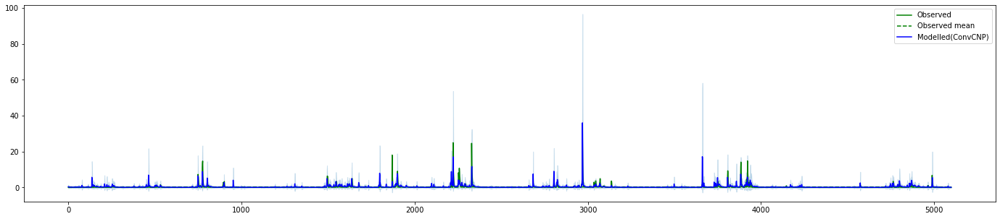

295. Basin hru_08109700 (period: 1996-2010): LL=0.030 -- NSE=-0.204 -- time=20.492


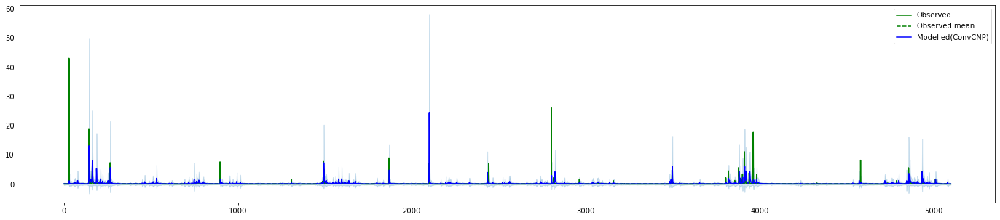

296. Basin hru_08150800 (period: 1996-2010): LL=0.031 -- NSE=-1.063 -- time=20.405


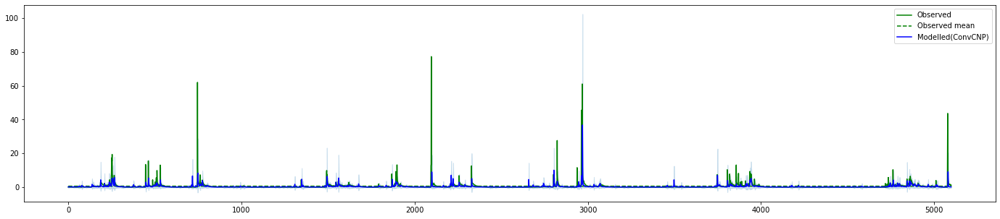

297. Basin hru_08158810 (period: 1996-2010): LL=0.016 -- NSE=0.021 -- time=20.441


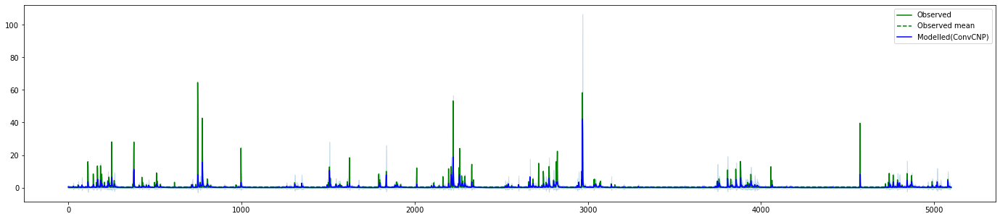

298. Basin hru_08164300 (period: 1996-2010): LL=0.018 -- NSE=0.086 -- time=20.310


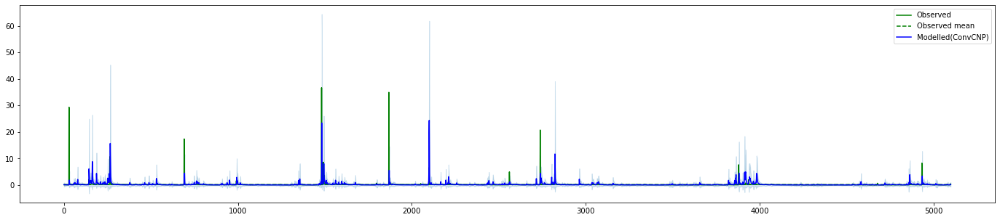

299. Basin hru_08165300 (period: 1996-2010): LL=0.033 -- NSE=-0.826 -- time=20.175


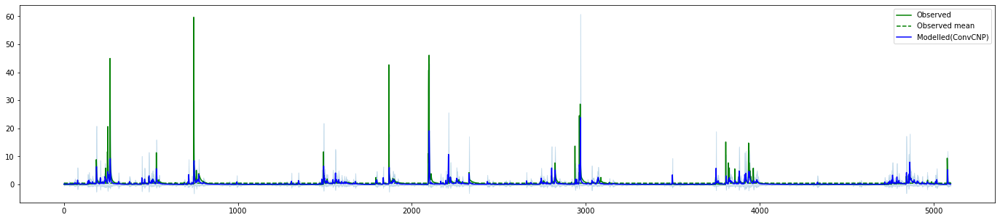

300. Basin hru_08171300 (period: 1996-2010): LL=0.028 -- NSE=0.008 -- time=20.358


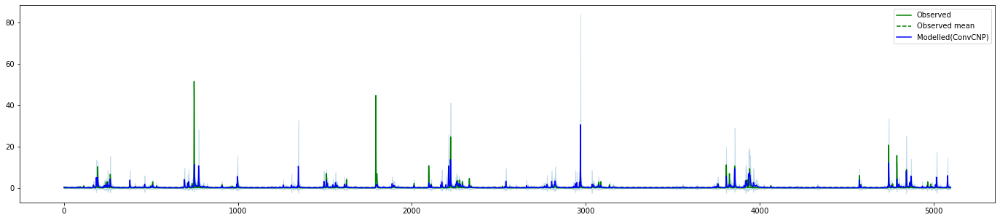

301. Basin hru_08175000 (period: 1996-2010): LL=0.032 -- NSE=-0.139 -- time=20.217


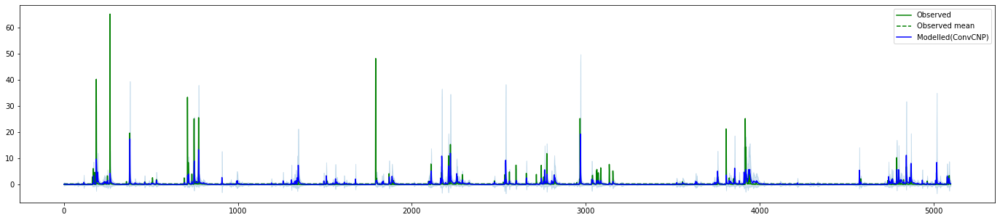

302. Basin hru_08176900 (period: 1996-2010): LL=0.030 -- NSE=-0.089 -- time=20.400


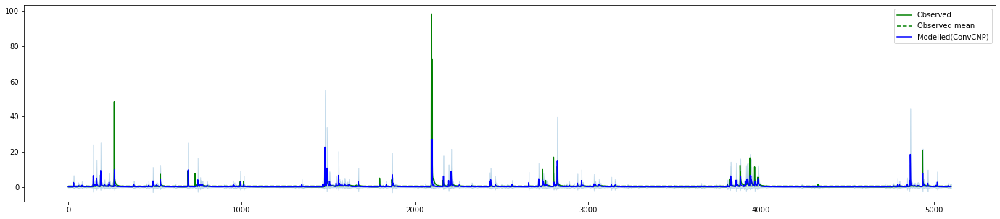

303. Basin hru_08178880 (period: 1996-2010): LL=0.028 -- NSE=0.027 -- time=20.558


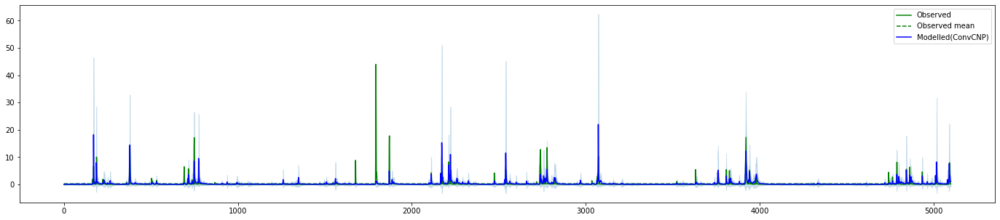

304. Basin hru_08189500 (period: 1996-2010): LL=0.033 -- NSE=-0.229 -- time=20.490


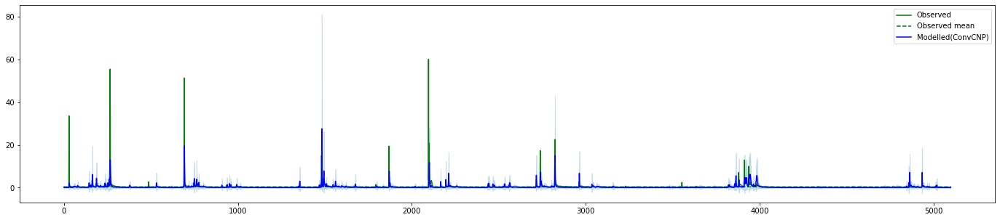

305. Basin hru_08195000 (period: 1996-2010): LL=0.029 -- NSE=-0.110 -- time=20.381


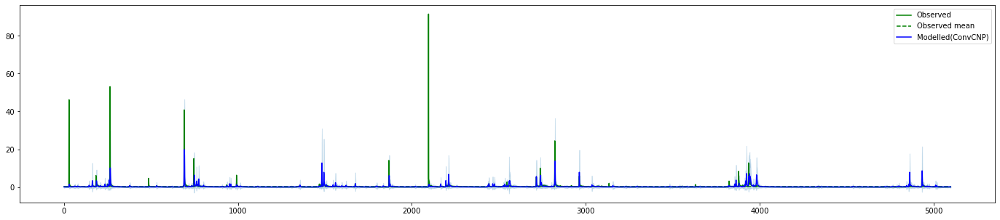

306. Basin hru_08196000 (period: 1996-2010): LL=0.029 -- NSE=-0.127 -- time=20.325


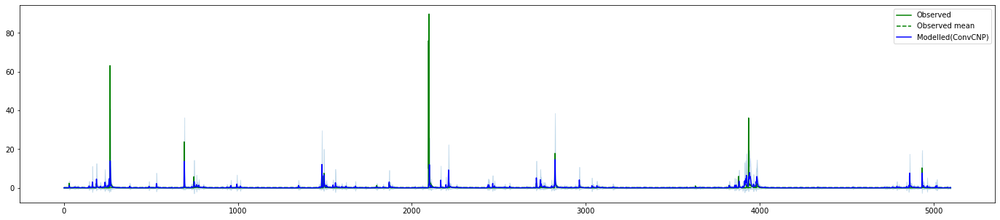

307. Basin hru_08198500 (period: 1996-2010): LL=0.035 -- NSE=-0.131 -- time=20.855


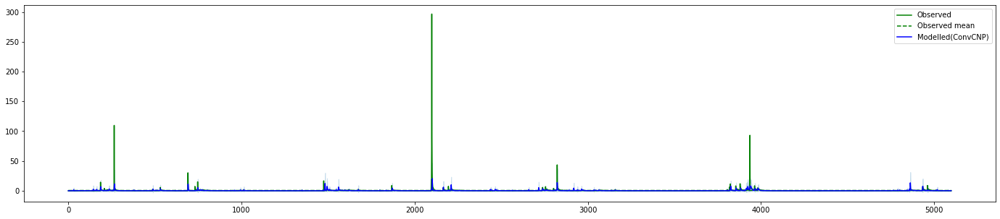

308. Basin hru_08200000 (period: 1996-2010): LL=0.025 -- NSE=0.015 -- time=20.647


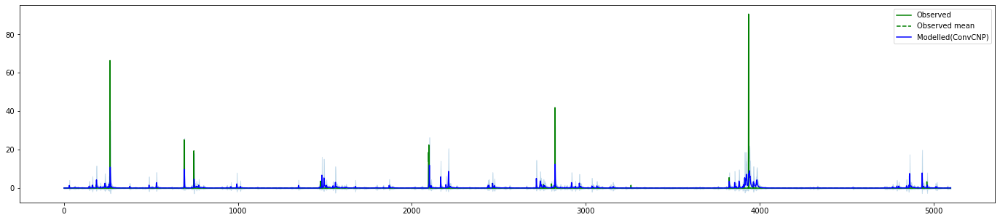

309. Basin hru_08202700 (period: 1996-2010): LL=0.036 -- NSE=-0.250 -- time=20.721


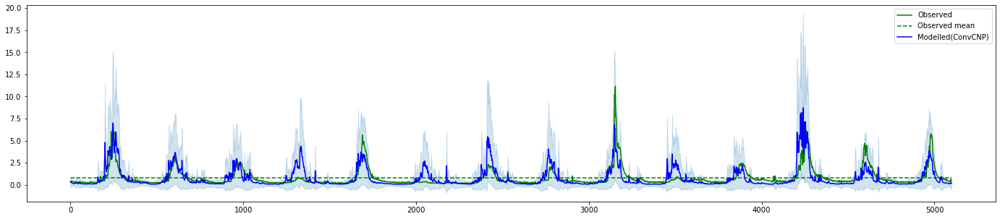

310. Basin hru_08267500 (period: 1996-2010): LL=0.018 -- NSE=0.182 -- time=20.510


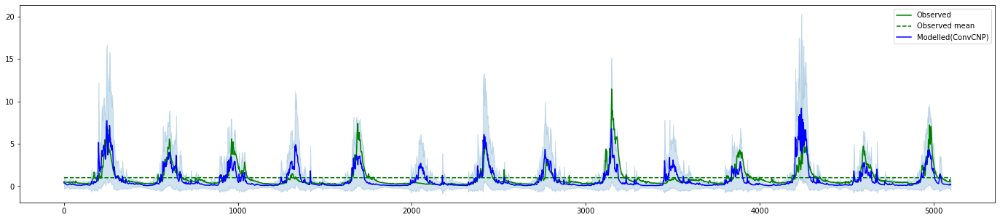

311. Basin hru_08271000 (period: 1996-2010): LL=0.012 -- NSE=0.294 -- time=20.314


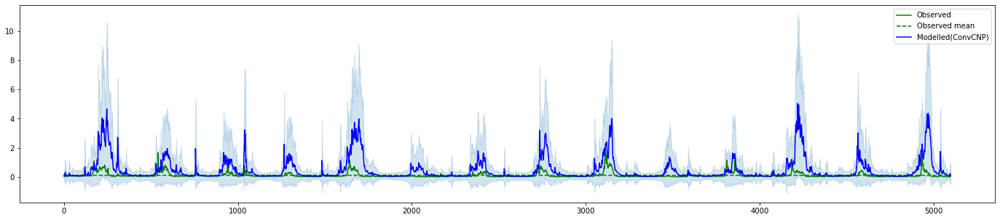

312. Basin hru_08324000 (period: 1996-2010): LL=0.031 -- NSE=-31.956 -- time=20.706


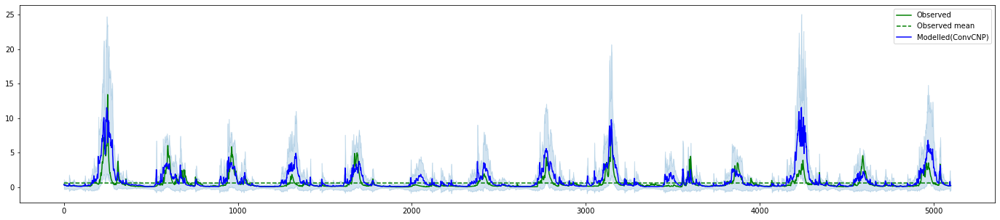

313. Basin hru_08377900 (period: 1996-2010): LL=0.021 -- NSE=0.001 -- time=20.711


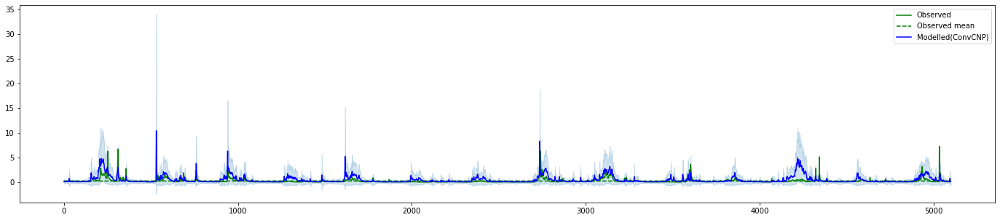

314. Basin hru_08380500 (period: 1996-2010): LL=0.030 -- NSE=-4.291 -- time=21.417


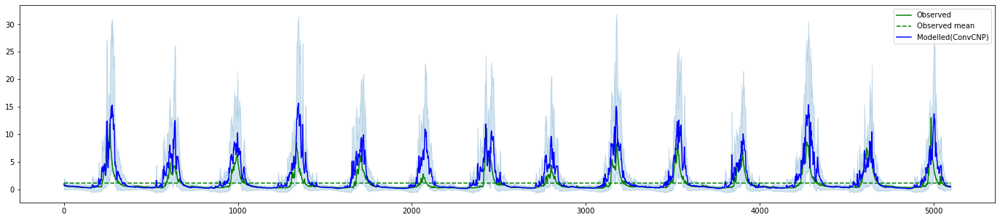

315. Basin hru_09035900 (period: 1996-2010): LL=0.015 -- NSE=0.489 -- time=21.492


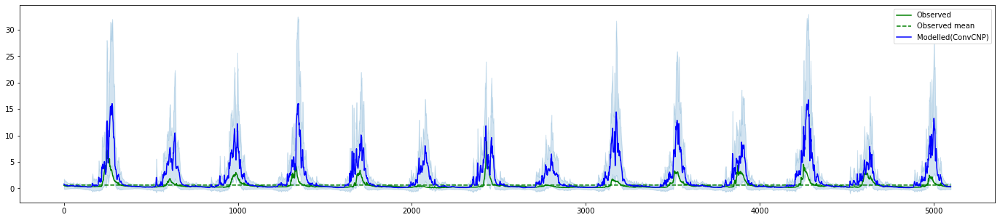

316. Basin hru_09047700 (period: 1996-2010): LL=0.015 -- NSE=-0.697 -- time=20.354


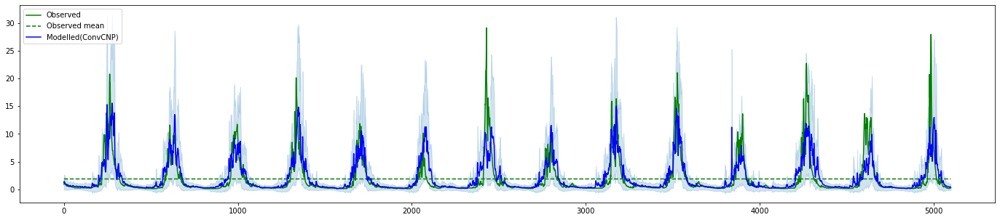

317. Basin hru_09065500 (period: 1996-2010): LL=0.012 -- NSE=0.302 -- time=20.440


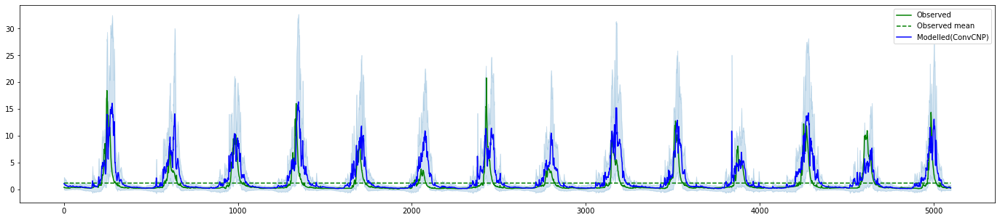

318. Basin hru_09066000 (period: 1996-2010): LL=0.014 -- NSE=0.356 -- time=20.775


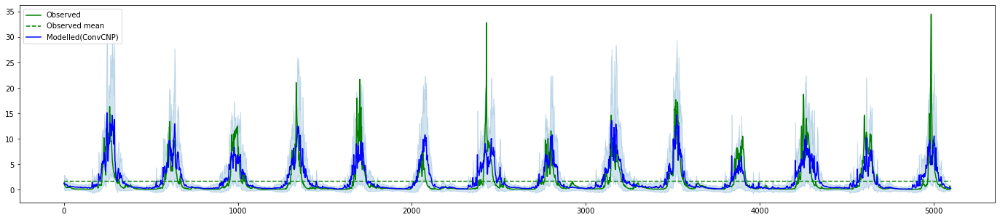

319. Basin hru_09066200 (period: 1996-2010): LL=0.010 -- NSE=0.292 -- time=22.225


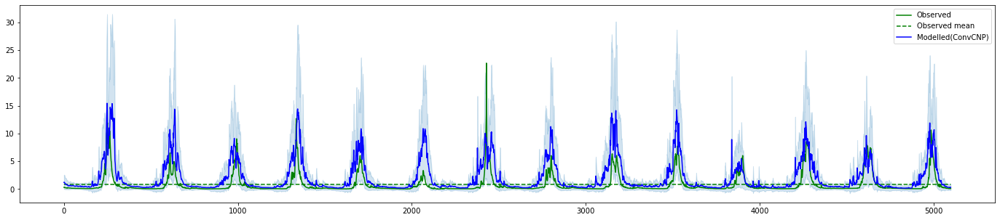

320. Basin hru_09066300 (period: 1996-2010): LL=0.009 -- NSE=0.316 -- time=20.502


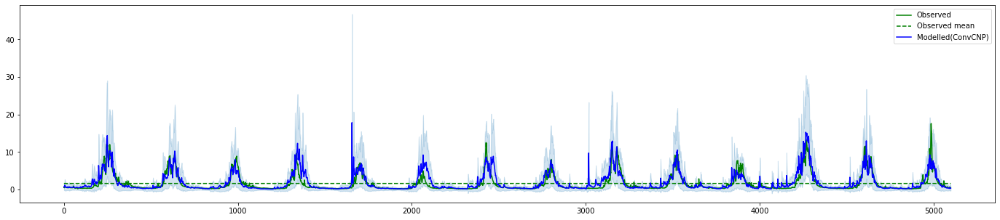

321. Basin hru_09081600 (period: 1996-2010): LL=0.012 -- NSE=0.410 -- time=20.803


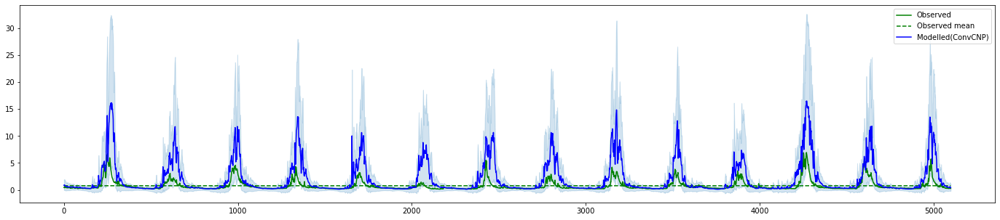

322. Basin hru_09107000 (period: 1996-2010): LL=0.015 -- NSE=0.051 -- time=20.636


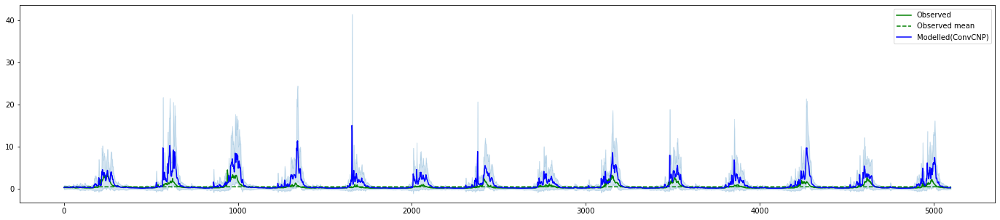

323. Basin hru_09210500 (period: 1996-2010): LL=0.025 -- NSE=-2.020 -- time=20.688


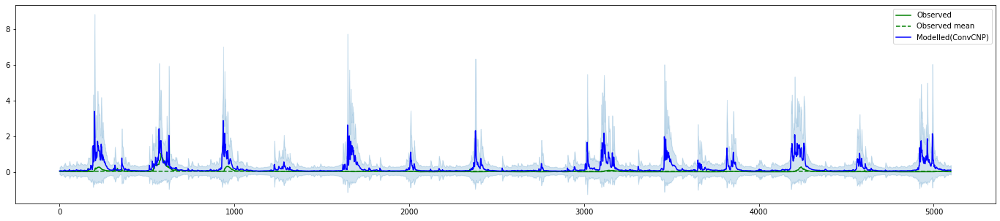

324. Basin hru_09306242 (period: 1996-2010): LL=0.039 -- NSE=-183.501 -- time=20.697


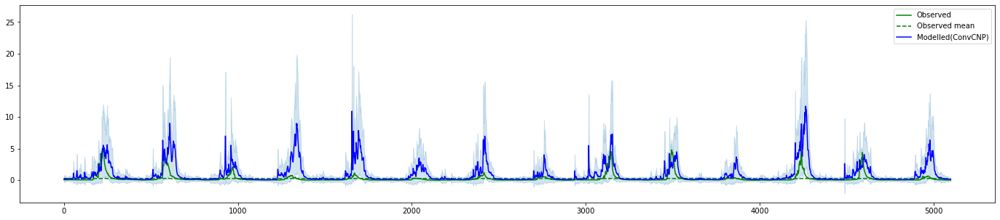

325. Basin hru_09312600 (period: 1996-2010): LL=0.023 -- NSE=-2.101 -- time=21.343


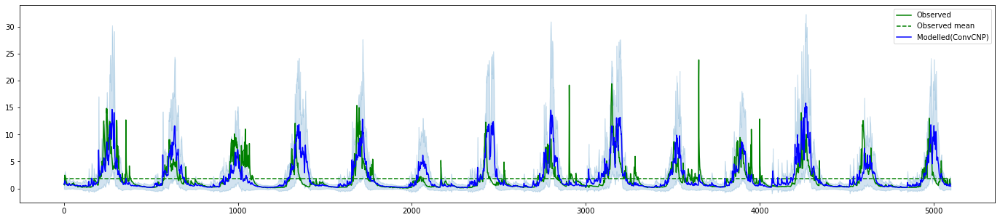

326. Basin hru_09352900 (period: 1996-2010): LL=0.006 -- NSE=0.294 -- time=21.098


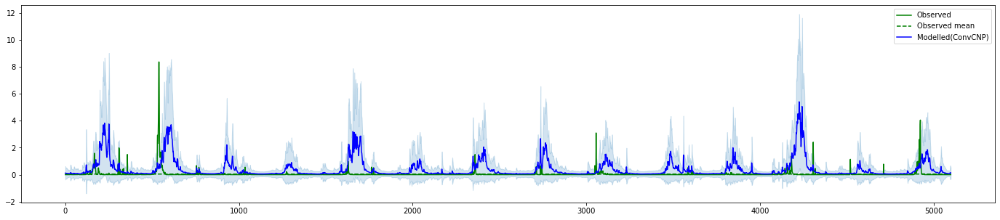

327. Basin hru_09386900 (period: 1996-2010): LL=0.031 -- NSE=-12.224 -- time=20.875


/home/donal/miniconda3/lib/python3.7/site-packages/scipy/stats/_distn_infrastructure.py:881: RuntimeWarning: invalid value encountered in greater
  cond = logical_and(cond, (asarray(arg) > 0))
/home/donal/miniconda3/lib/python3.7/site-packages/scipy/stats/_distn_infrastructure.py:2016: RuntimeWarning: invalid value encountered in greater
  cond0 = self._argcheck(*args) & (scale > 0) & (loc == loc)


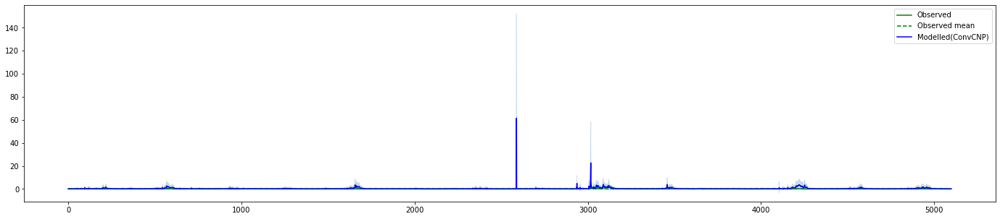

328. Basin hru_09404450 (period: 1996-2010): LL=nan -- NSE=nan -- time=21.190


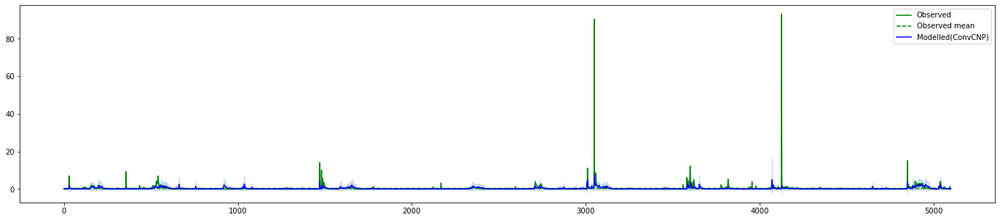

329. Basin hru_09430600 (period: 1996-2010): LL=0.029 -- NSE=-0.085 -- time=23.078


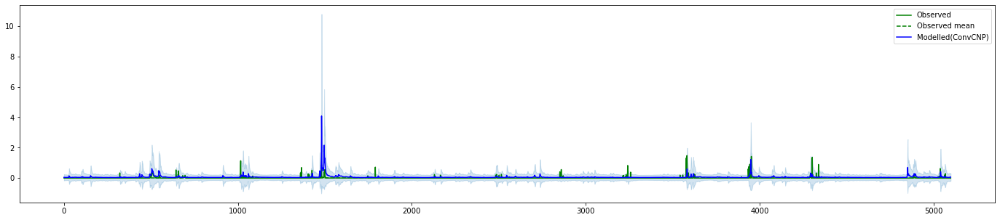

330. Basin hru_09484600 (period: 1996-2010): LL=0.049 -- NSE=-208.683 -- time=22.280


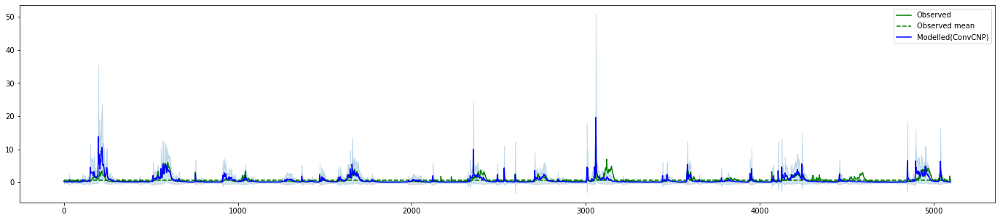

331. Basin hru_09492400 (period: 1996-2010): LL=0.017 -- NSE=-0.045 -- time=20.691


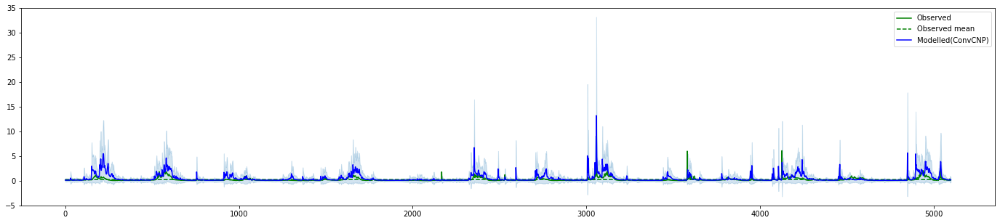

332. Basin hru_09494000 (period: 1996-2010): LL=0.030 -- NSE=-7.451 -- time=21.860


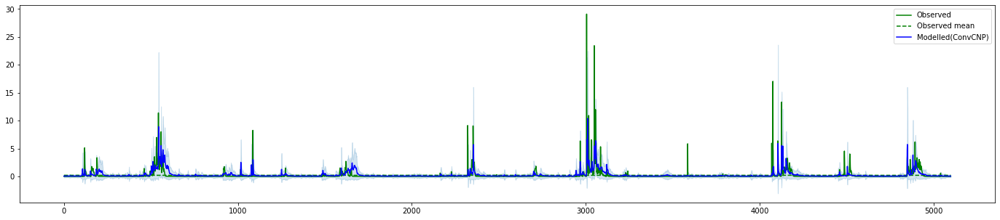

333. Basin hru_09505350 (period: 1996-2010): LL=0.033 -- NSE=-0.707 -- time=20.714


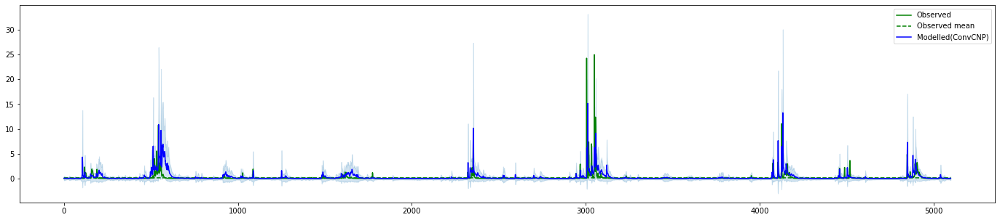

334. Basin hru_09505800 (period: 1996-2010): LL=0.037 -- NSE=-1.300 -- time=20.347


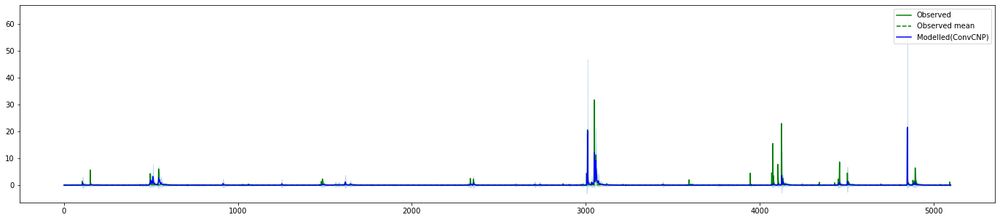

335. Basin hru_09510200 (period: 1996-2010): LL=0.043 -- NSE=-0.834 -- time=21.086


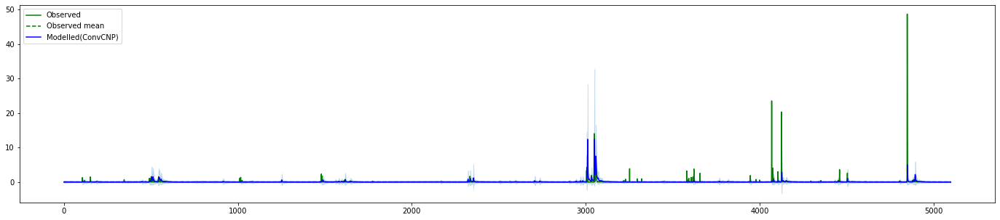

336. Basin hru_09512280 (period: 1996-2010): LL=0.040 -- NSE=-1.048 -- time=22.315


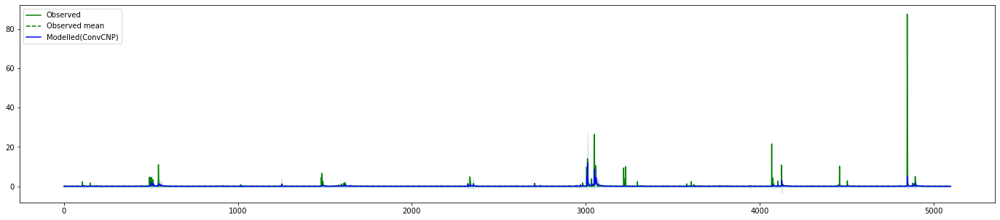

337. Basin hru_09513780 (period: 1996-2010): LL=0.034 -- NSE=-0.315 -- time=20.826


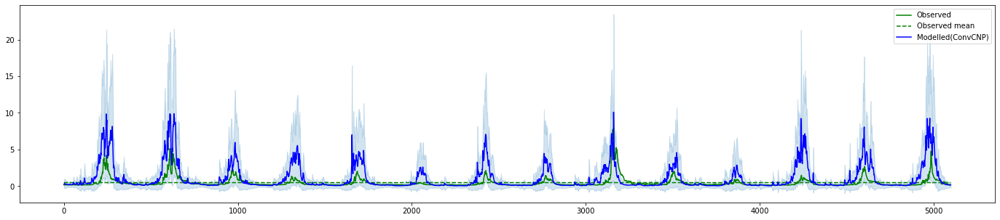

338. Basin hru_10234500 (period: 1996-2010): LL=0.021 -- NSE=-0.869 -- time=20.578


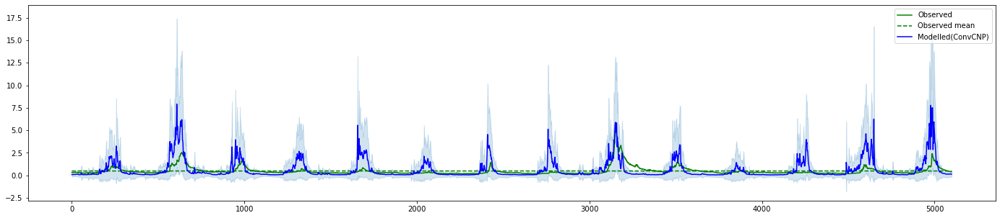

339. Basin hru_10244950 (period: 1996-2010): LL=0.016 -- NSE=-1.711 -- time=21.794


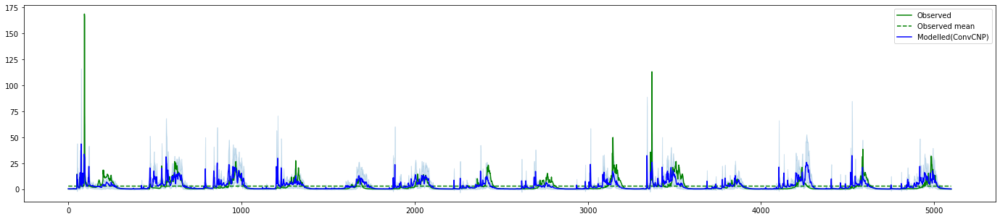

340. Basin hru_10336660 (period: 1996-2010): LL=-0.003 -- NSE=0.153 -- time=21.810


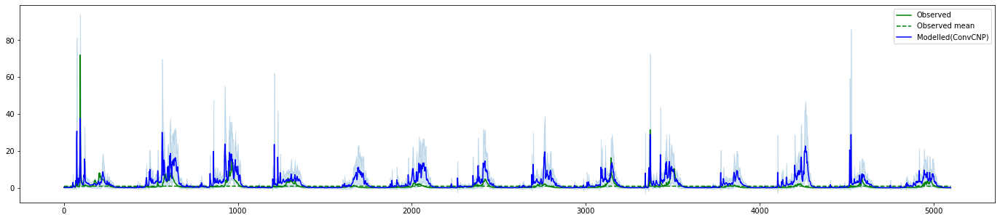

341. Basin hru_10343500 (period: 1996-2010): LL=0.007 -- NSE=0.192 -- time=21.430


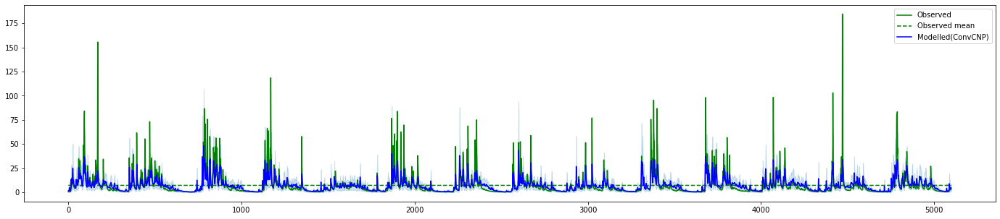

342. Basin hru_12010000 (period: 1996-2010): LL=-0.018 -- NSE=0.074 -- time=21.769


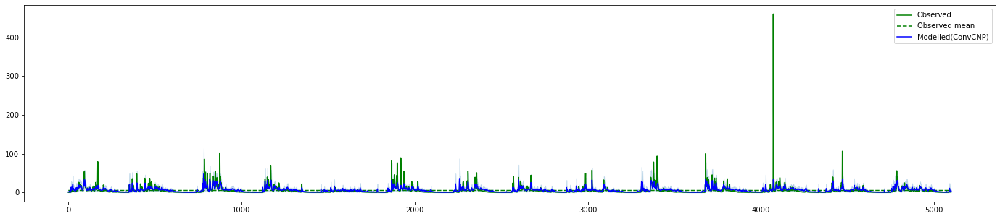

343. Basin hru_12020000 (period: 1996-2010): LL=-0.019 -- NSE=0.111 -- time=21.451


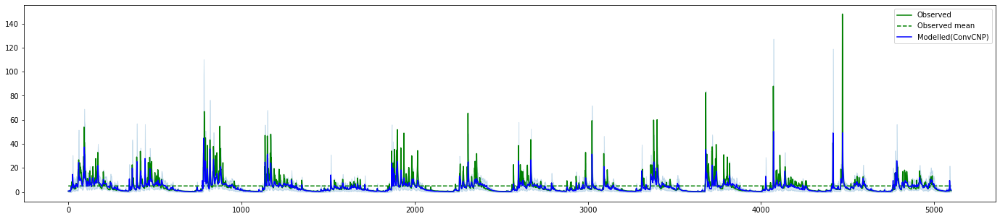

344. Basin hru_12025700 (period: 1996-2010): LL=-0.009 -- NSE=0.075 -- time=20.959


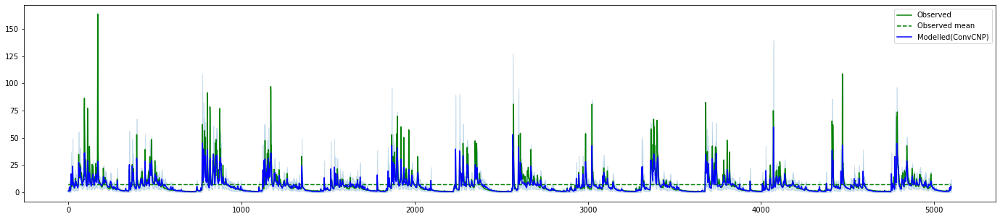

345. Basin hru_12035000 (period: 1996-2010): LL=-0.013 -- NSE=0.091 -- time=20.828


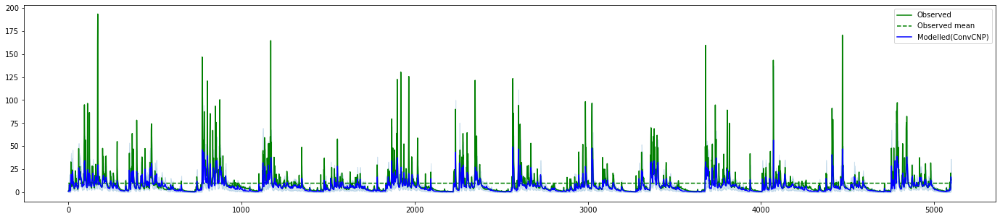

346. Basin hru_12040500 (period: 1996-2010): LL=-0.030 -- NSE=-0.064 -- time=20.543


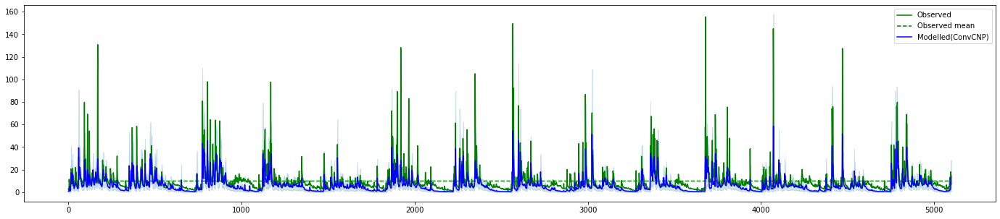

347. Basin hru_12041200 (period: 1996-2010): LL=-0.098 -- NSE=-0.224 -- time=20.742


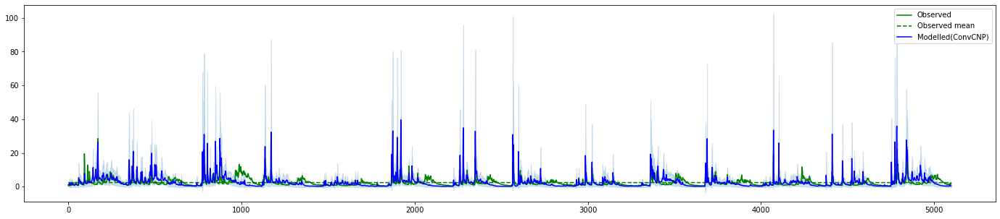

348. Basin hru_12048000 (period: 1996-2010): LL=-0.035 -- NSE=0.216 -- time=20.660


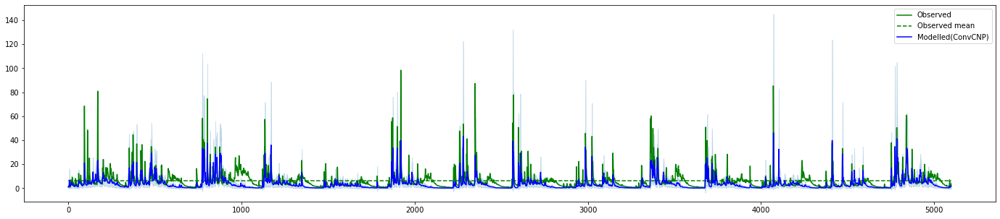

349. Basin hru_12054000 (period: 1996-2010): LL=-0.115 -- NSE=-0.119 -- time=20.496


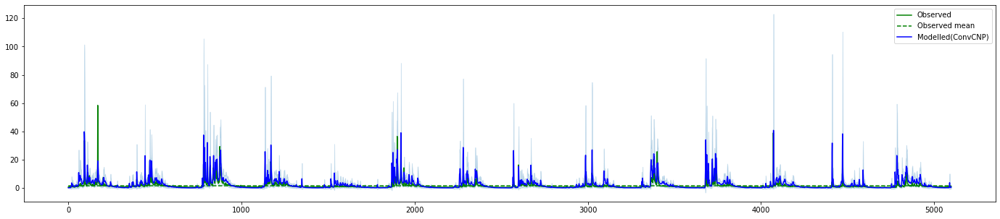

350. Basin hru_12073500 (period: 1996-2010): LL=-0.002 -- NSE=0.507 -- time=20.542


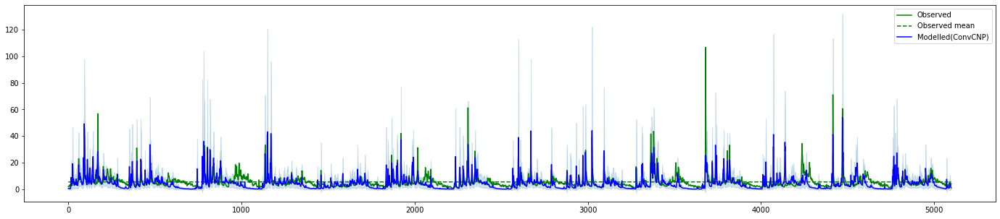

351. Basin hru_12082500 (period: 1996-2010): LL=-0.105 -- NSE=-0.223 -- time=20.456


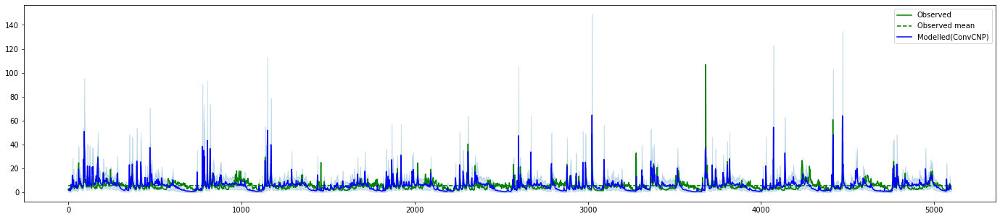

352. Basin hru_12092000 (period: 1996-2010): LL=-0.058 -- NSE=-0.217 -- time=20.482


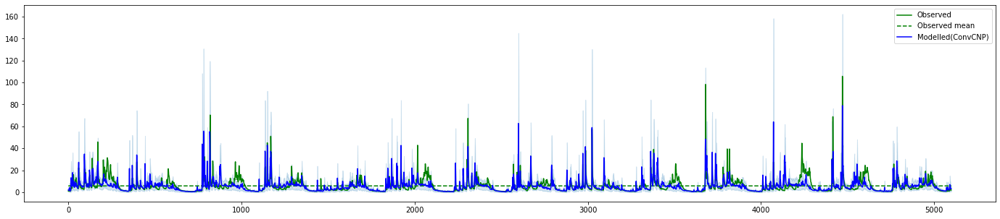

353. Basin hru_12114500 (period: 1996-2010): LL=-0.022 -- NSE=0.002 -- time=21.146


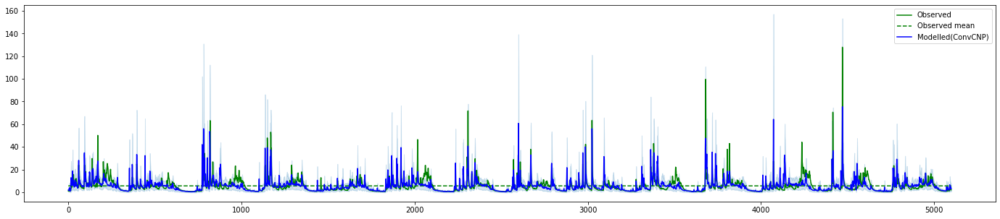

354. Basin hru_12115000 (period: 1996-2010): LL=-0.019 -- NSE=0.050 -- time=20.521


/home/donal/miniconda3/lib/python3.7/site-packages/scipy/stats/_distn_infrastructure.py:881: RuntimeWarning: invalid value encountered in greater
  cond = logical_and(cond, (asarray(arg) > 0))
/home/donal/miniconda3/lib/python3.7/site-packages/scipy/stats/_distn_infrastructure.py:2016: RuntimeWarning: invalid value encountered in greater
  cond0 = self._argcheck(*args) & (scale > 0) & (loc == loc)


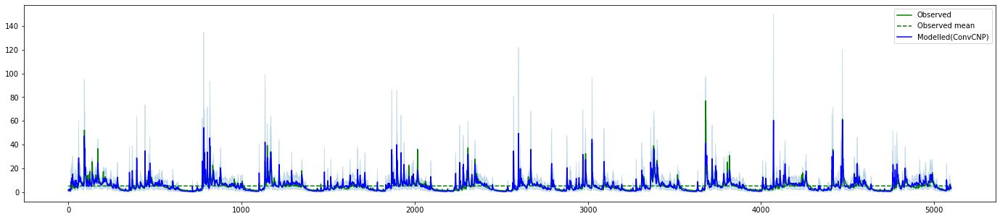

355. Basin hru_12117000 (period: 1996-2010): LL=nan -- NSE=nan -- time=22.052


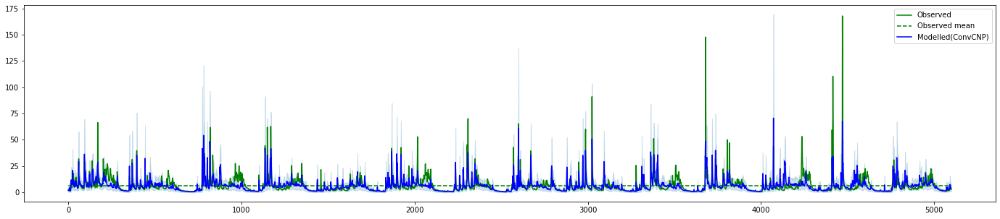

356. Basin hru_12143600 (period: 1996-2010): LL=-0.022 -- NSE=0.033 -- time=21.062


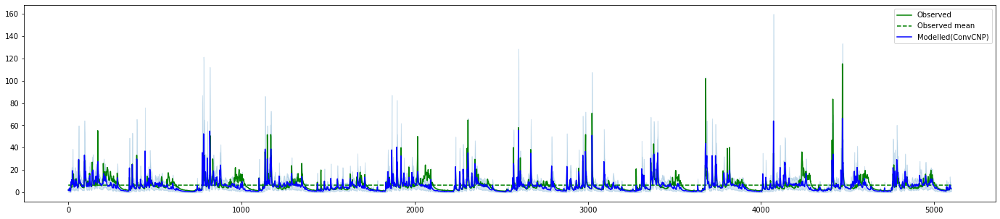

357. Basin hru_12144000 (period: 1996-2010): LL=-0.028 -- NSE=-0.077 -- time=20.772


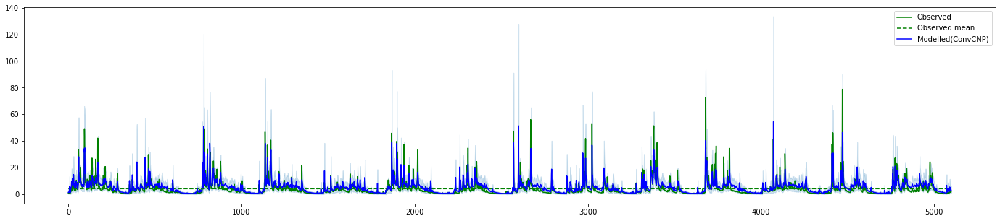

358. Basin hru_12145500 (period: 1996-2010): LL=-0.010 -- NSE=0.264 -- time=20.610


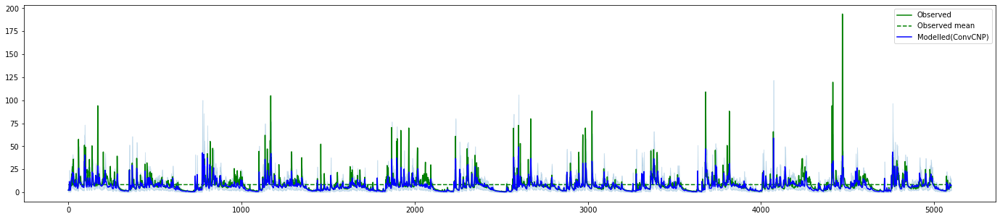

359. Basin hru_12147500 (period: 1996-2010): LL=-0.023 -- NSE=-0.149 -- time=20.513


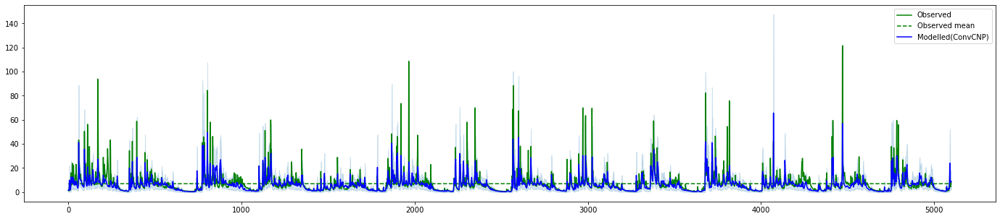

360. Basin hru_12167000 (period: 1996-2010): LL=-0.020 -- NSE=-0.037 -- time=20.585


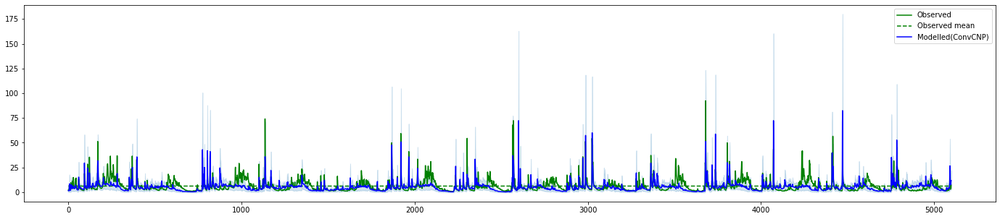

361. Basin hru_12178100 (period: 1996-2010): LL=-0.042 -- NSE=-0.170 -- time=20.583


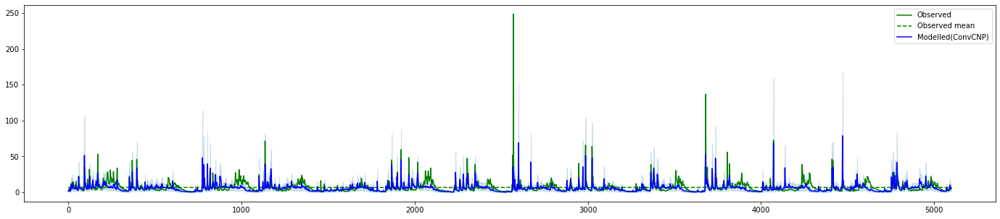

362. Basin hru_12186000 (period: 1996-2010): LL=-0.038 -- NSE=-0.119 -- time=20.622


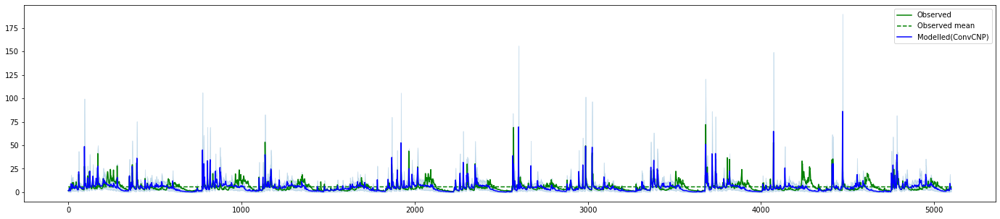

363. Basin hru_12189500 (period: 1996-2010): LL=-0.044 -- NSE=-0.176 -- time=20.877


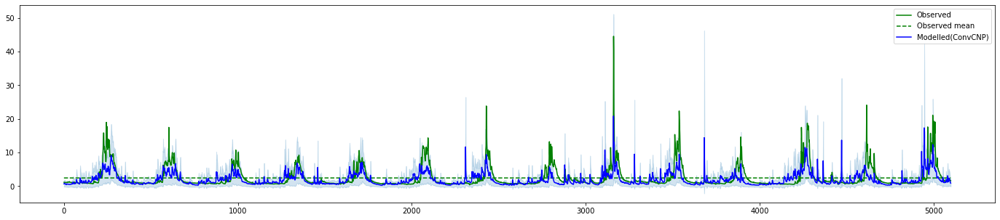

364. Basin hru_12375900 (period: 1996-2010): LL=-0.006 -- NSE=0.101 -- time=20.625


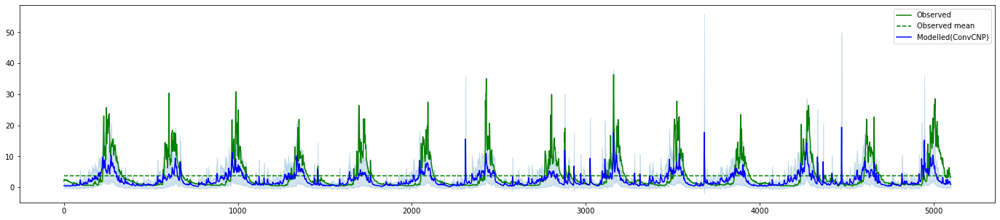

365. Basin hru_12377150 (period: 1996-2010): LL=-0.023 -- NSE=-0.042 -- time=20.556


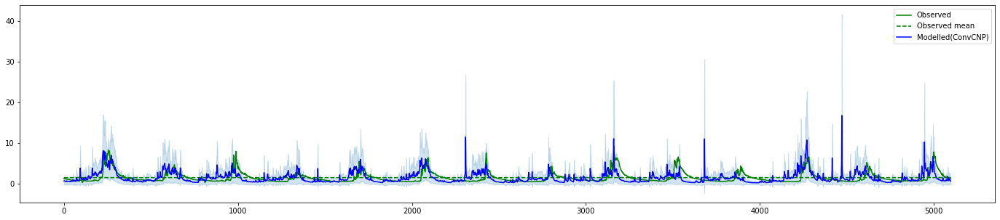

366. Basin hru_12383500 (period: 1996-2010): LL=-0.007 -- NSE=0.188 -- time=20.713


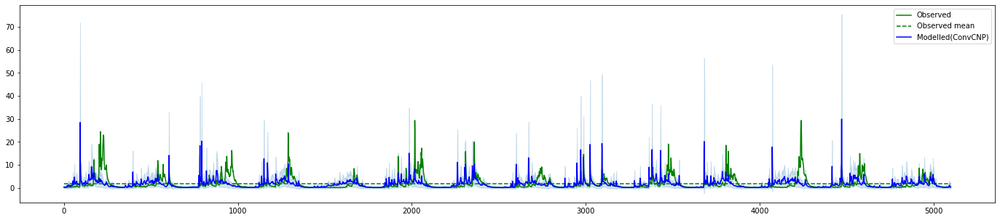

367. Basin hru_12411000 (period: 1996-2010): LL=-0.018 -- NSE=0.077 -- time=20.456


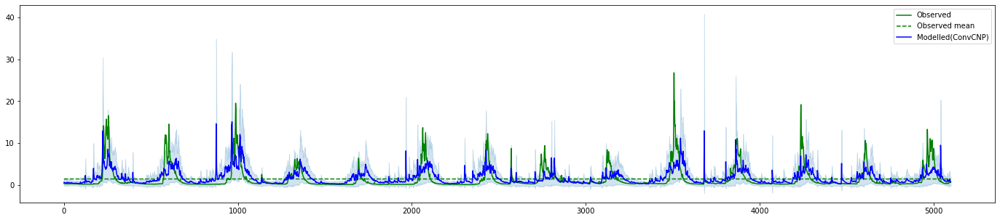

368. Basin hru_12447390 (period: 1996-2010): LL=0.002 -- NSE=0.182 -- time=20.431


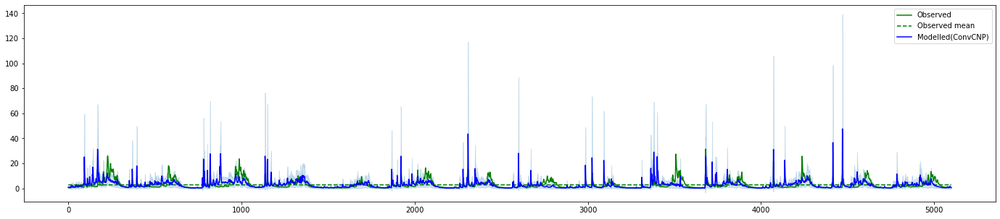

369. Basin hru_12488500 (period: 1996-2010): LL=-0.012 -- NSE=0.077 -- time=20.639


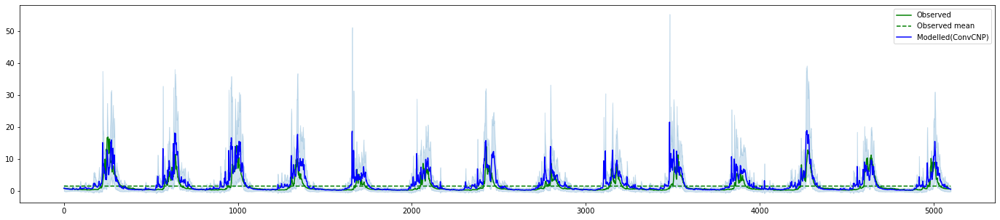

370. Basin hru_13011900 (period: 1996-2010): LL=0.009 -- NSE=0.428 -- time=20.620


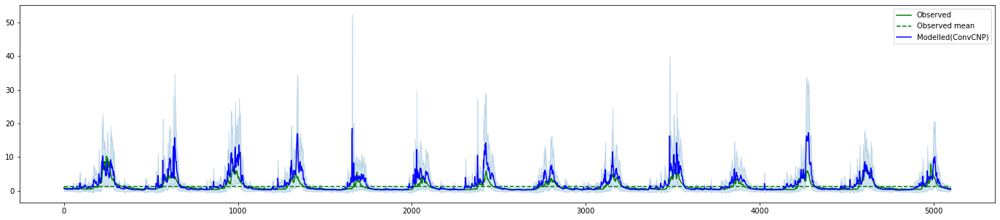

371. Basin hru_13023000 (period: 1996-2010): LL=0.010 -- NSE=0.495 -- time=20.588


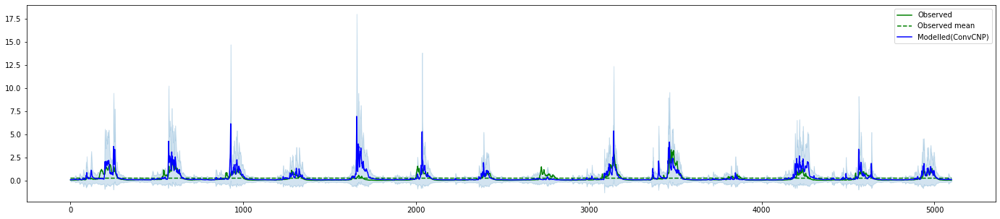

372. Basin hru_13161500 (period: 1996-2010): LL=0.035 -- NSE=-4.274 -- time=20.902


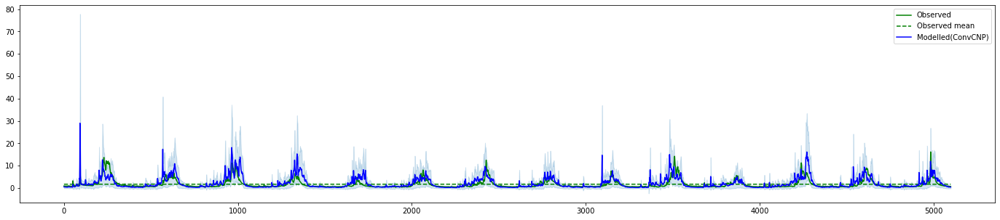

373. Basin hru_13235000 (period: 1996-2010): LL=0.005 -- NSE=0.361 -- time=20.411


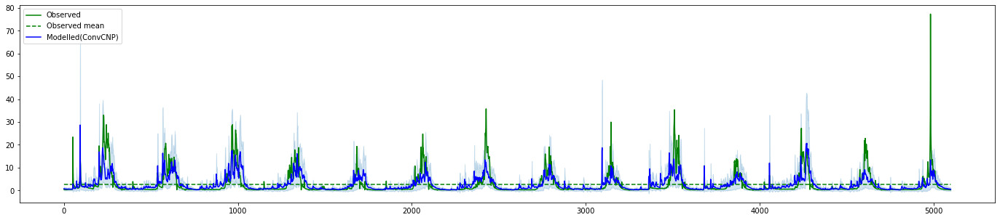

374. Basin hru_13240000 (period: 1996-2010): LL=-0.002 -- NSE=0.178 -- time=20.593


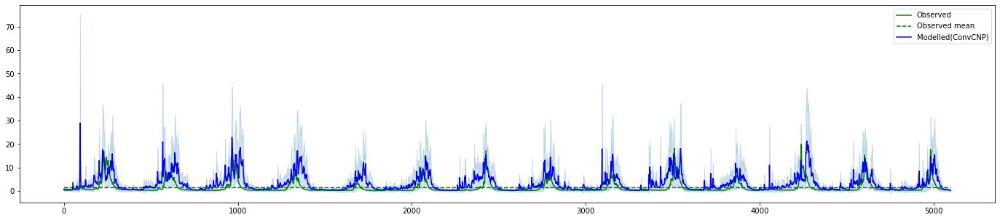

375. Basin hru_13313000 (period: 1996-2010): LL=-0.003 -- NSE=0.336 -- time=20.611


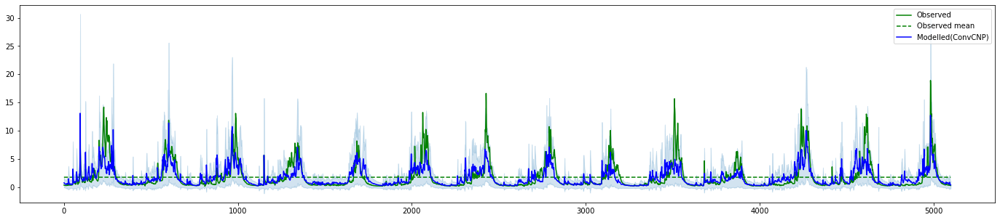

376. Basin hru_13331500 (period: 1996-2010): LL=0.006 -- NSE=0.228 -- time=20.427


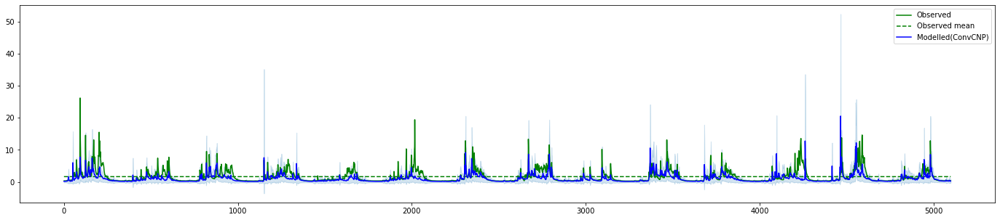

377. Basin hru_14020000 (period: 1996-2010): LL=0.001 -- NSE=0.166 -- time=20.549


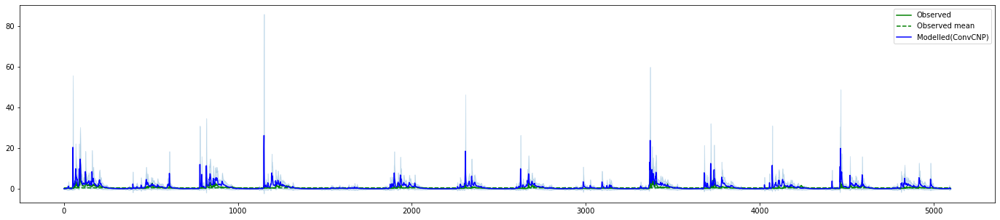

378. Basin hru_14096850 (period: 1996-2010): LL=0.018 -- NSE=-0.837 -- time=20.426


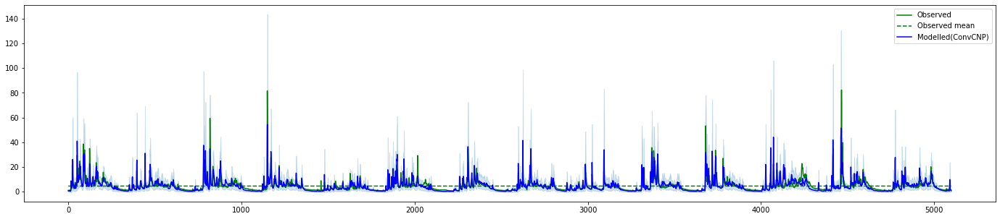

379. Basin hru_14137000 (period: 1996-2010): LL=-0.016 -- NSE=0.139 -- time=20.806


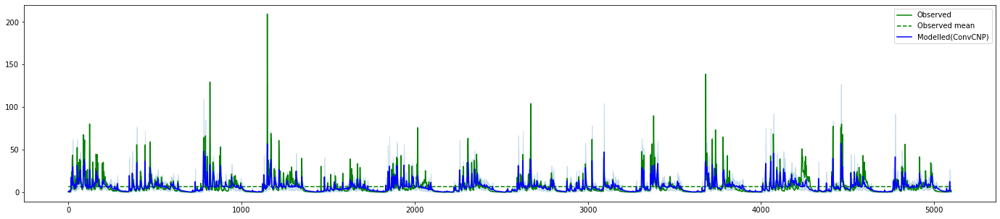

380. Basin hru_14138800 (period: 1996-2010): LL=-0.022 -- NSE=0.083 -- time=20.746


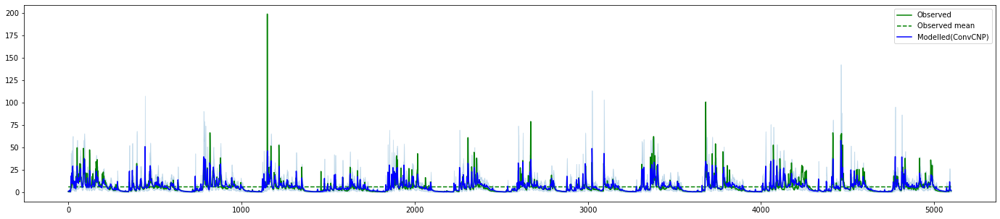

381. Basin hru_14138870 (period: 1996-2010): LL=-0.013 -- NSE=0.130 -- time=20.698


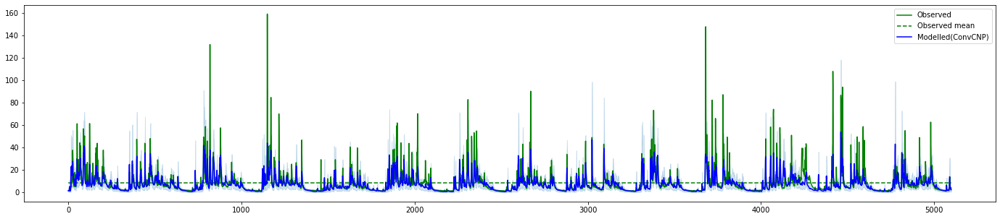

382. Basin hru_14138900 (period: 1996-2010): LL=-0.024 -- NSE=-0.021 -- time=20.747


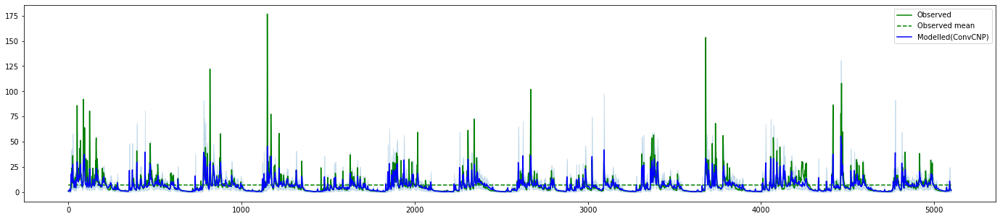

383. Basin hru_14139800 (period: 1996-2010): LL=-0.015 -- NSE=0.038 -- time=22.161


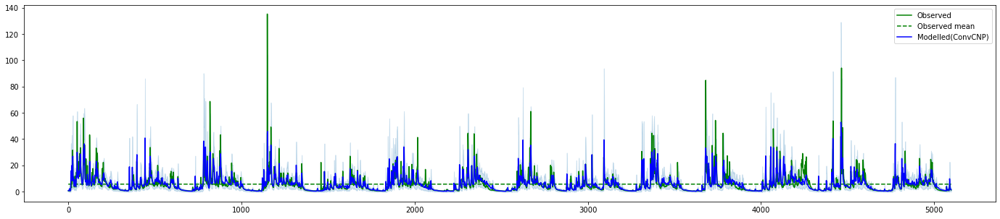

384. Basin hru_14141500 (period: 1996-2010): LL=-0.011 -- NSE=0.121 -- time=20.775


/home/donal/miniconda3/lib/python3.7/site-packages/scipy/stats/_distn_infrastructure.py:881: RuntimeWarning: invalid value encountered in greater
  cond = logical_and(cond, (asarray(arg) > 0))
/home/donal/miniconda3/lib/python3.7/site-packages/scipy/stats/_distn_infrastructure.py:2016: RuntimeWarning: invalid value encountered in greater
  cond0 = self._argcheck(*args) & (scale > 0) & (loc == loc)


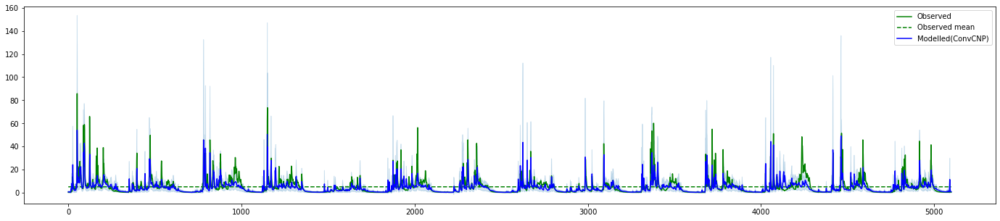

385. Basin hru_14158790 (period: 1996-2010): LL=nan -- NSE=nan -- time=20.924


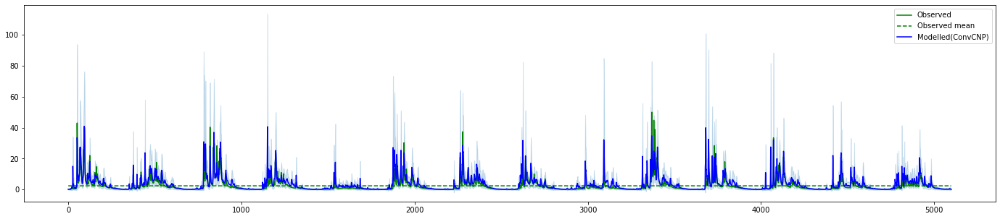

386. Basin hru_14166500 (period: 1996-2010): LL=0.003 -- NSE=0.447 -- time=20.671


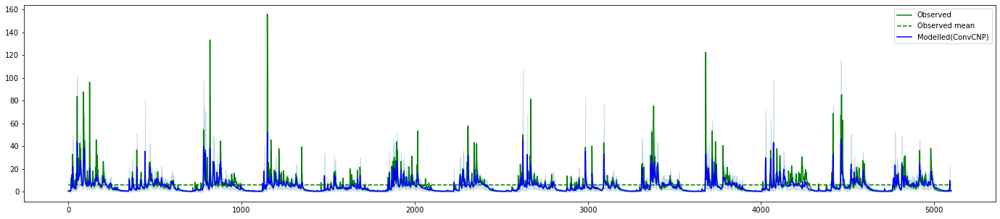

387. Basin hru_14182500 (period: 1996-2010): LL=-0.013 -- NSE=0.055 -- time=21.571


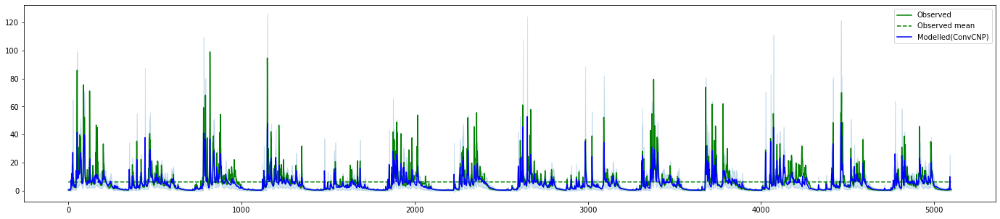

388. Basin hru_14185900 (period: 1996-2010): LL=-0.014 -- NSE=0.062 -- time=20.624


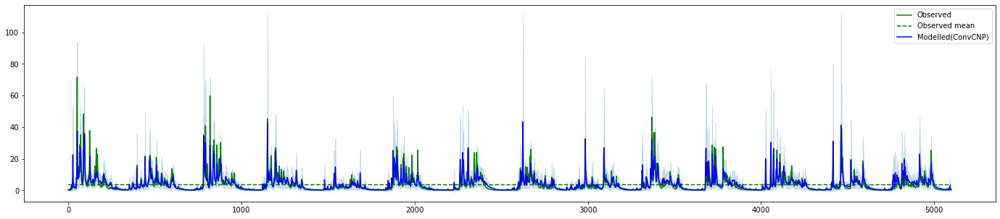

389. Basin hru_14187000 (period: 1996-2010): LL=-0.003 -- NSE=0.279 -- time=20.987


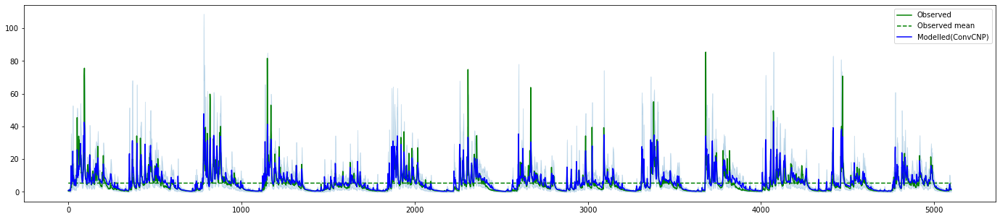

390. Basin hru_14222500 (period: 1996-2010): LL=-0.010 -- NSE=0.214 -- time=20.696


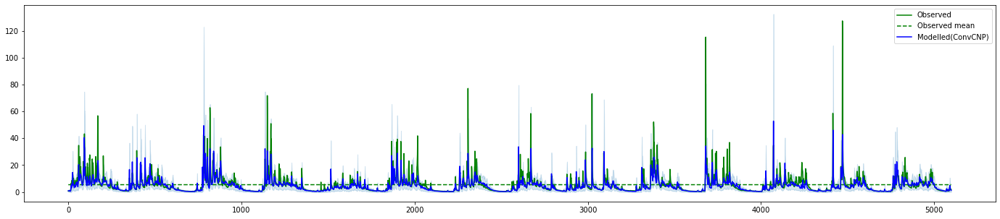

391. Basin hru_14236200 (period: 1996-2010): LL=-0.009 -- NSE=0.059 -- time=21.553


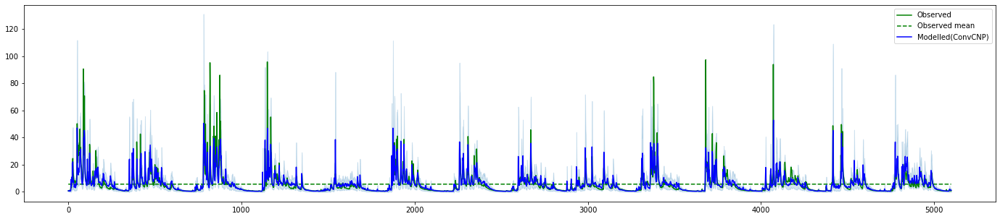

392. Basin hru_14303200 (period: 1996-2010): LL=-0.008 -- NSE=0.198 -- time=20.879


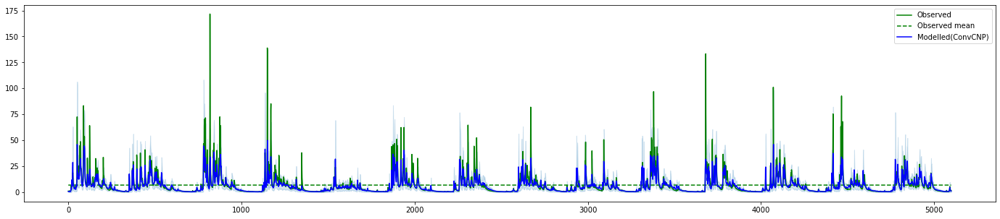

393. Basin hru_14305500 (period: 1996-2010): LL=-0.010 -- NSE=0.109 -- time=20.963


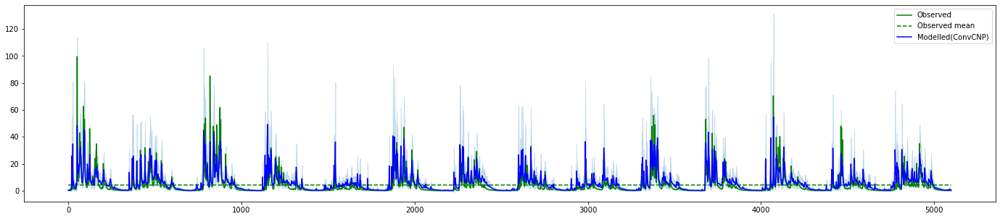

394. Basin hru_14306340 (period: 1996-2010): LL=-0.012 -- NSE=0.327 -- time=21.037


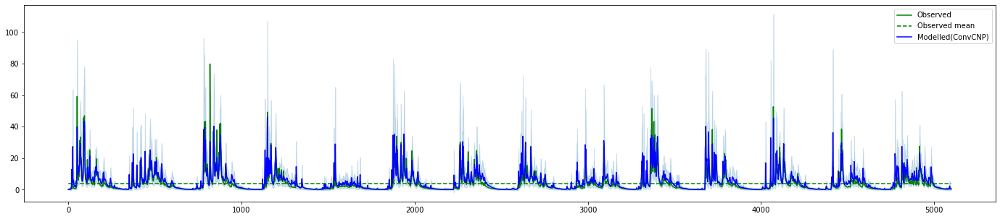

395. Basin hru_14306500 (period: 1996-2010): LL=-0.004 -- NSE=0.370 -- time=20.587


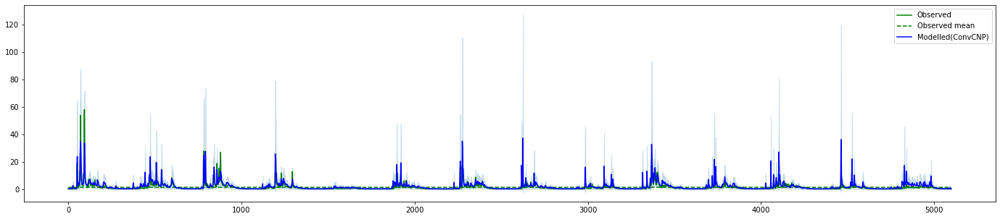

396. Basin hru_14308990 (period: 1996-2010): LL=0.011 -- NSE=0.437 -- time=20.828


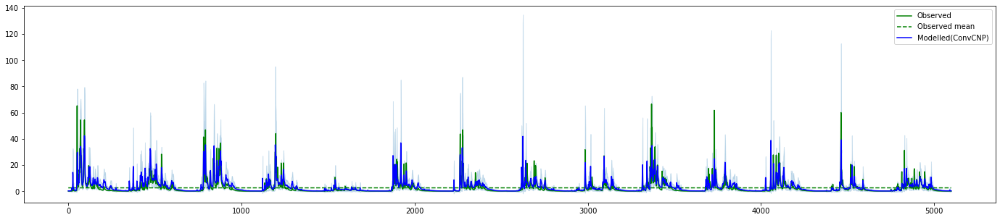

397. Basin hru_14309500 (period: 1996-2010): LL=0.001 -- NSE=0.359 -- time=20.897


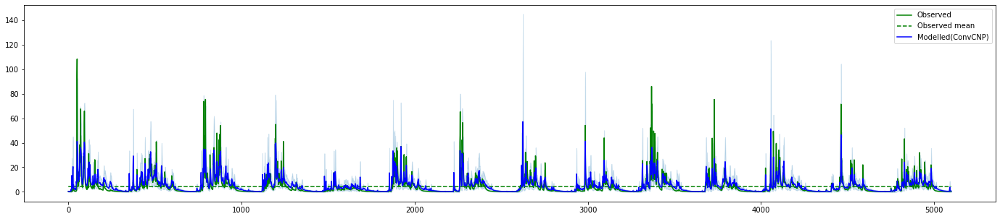

398. Basin hru_14325000 (period: 1996-2010): LL=-0.009 -- NSE=0.259 -- time=20.403


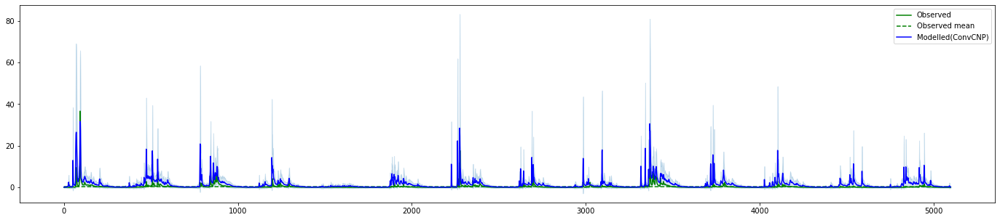

399. Basin hru_14362250 (period: 1996-2010): LL=0.010 -- NSE=-0.430 -- time=20.603


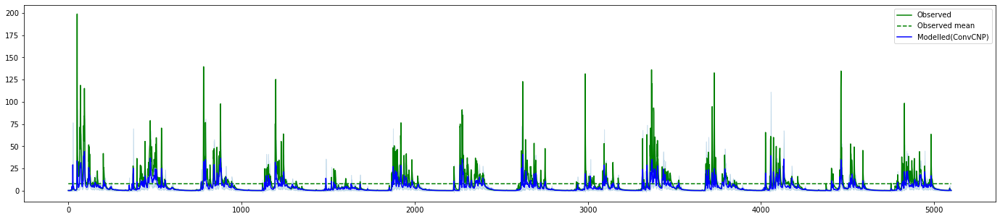

400. Basin hru_14400000 (period: 1996-2010): LL=-0.024 -- NSE=-0.004 -- time=20.854


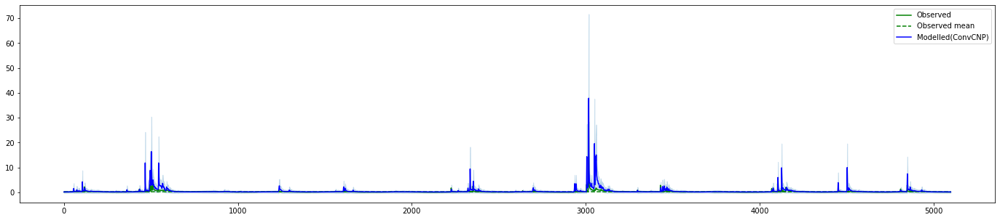

401. Basin hru_10259000 (period: 1996-2010): LL=0.031 -- NSE=-1.932 -- time=21.738


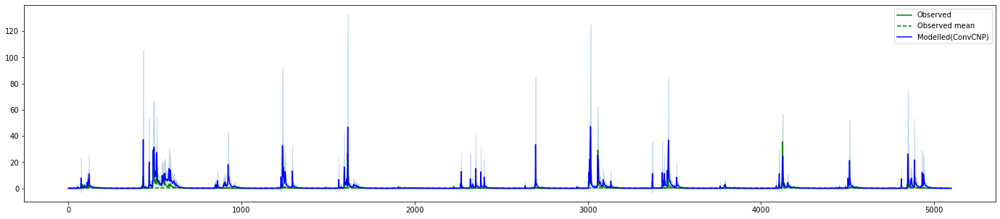

402. Basin hru_11124500 (period: 1996-2010): LL=0.025 -- NSE=0.028 -- time=20.579


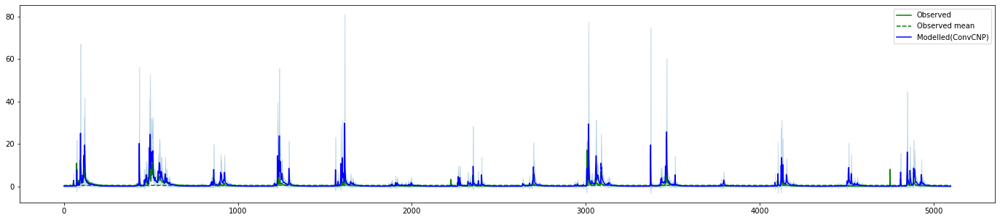

403. Basin hru_11141280 (period: 1996-2010): LL=0.027 -- NSE=0.077 -- time=20.840


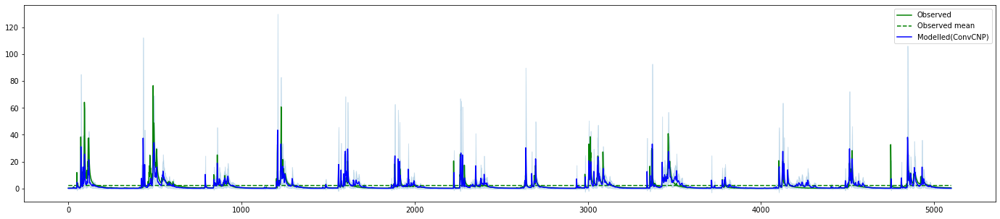

404. Basin hru_11143000 (period: 1996-2010): LL=0.004 -- NSE=0.281 -- time=20.804


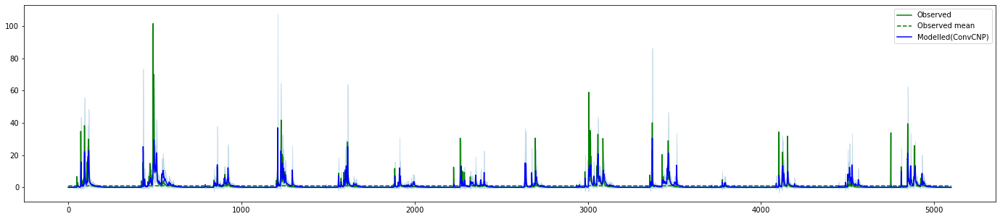

405. Basin hru_11148900 (period: 1996-2010): LL=0.016 -- NSE=0.237 -- time=20.801


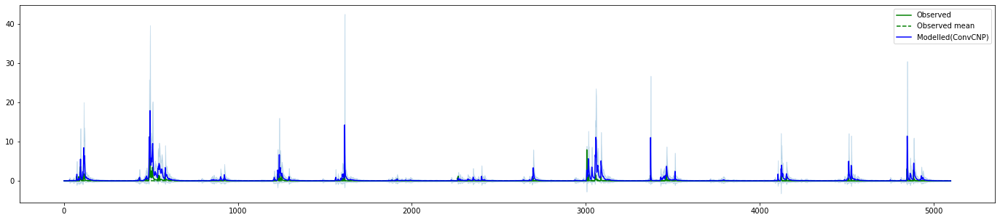

406. Basin hru_11151300 (period: 1996-2010): LL=0.039 -- NSE=-8.625 -- time=20.717


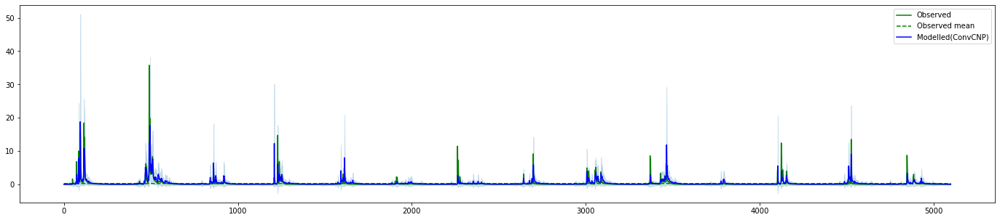

407. Basin hru_11176400 (period: 1996-2010): LL=0.036 -- NSE=-0.265 -- time=20.913


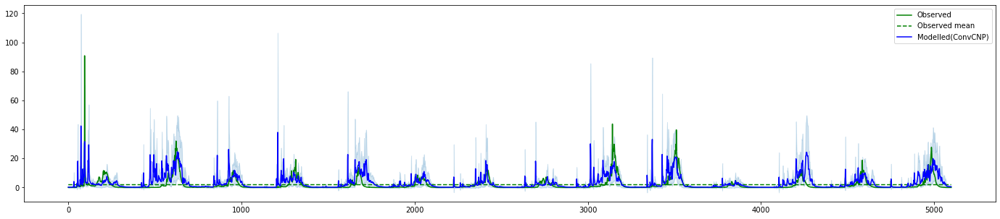

408. Basin hru_11237500 (period: 1996-2010): LL=0.001 -- NSE=0.282 -- time=21.182


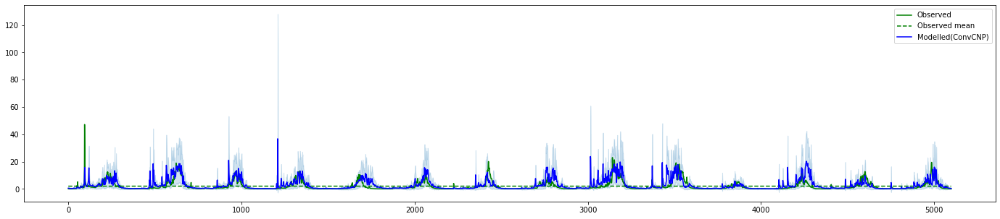

409. Basin hru_11264500 (period: 1996-2010): LL=0.005 -- NSE=0.340 -- time=20.805


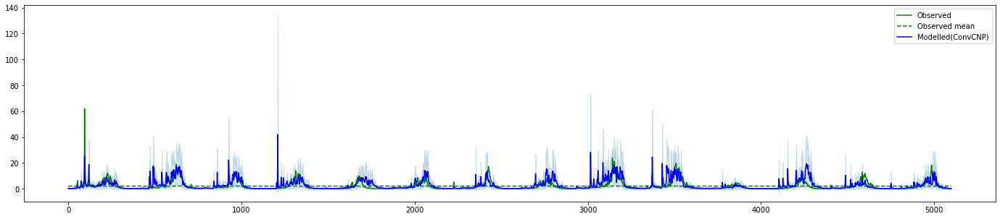

410. Basin hru_11266500 (period: 1996-2010): LL=0.005 -- NSE=0.316 -- time=21.496


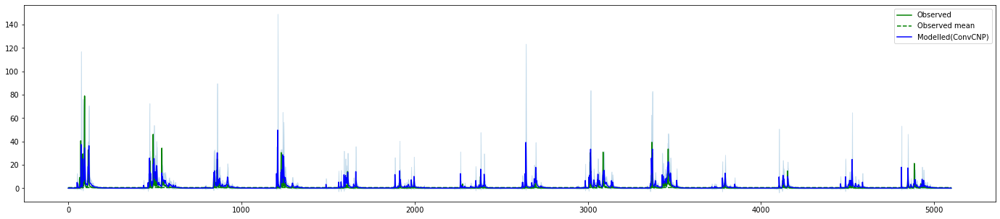

411. Basin hru_11284400 (period: 1996-2010): LL=0.023 -- NSE=0.234 -- time=20.740


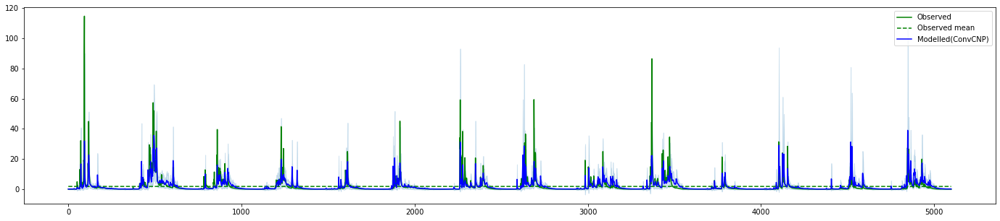

412. Basin hru_11451100 (period: 1996-2010): LL=0.010 -- NSE=0.251 -- time=21.490


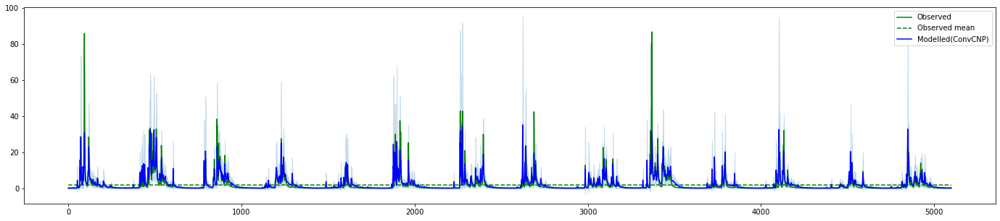

413. Basin hru_11468500 (period: 1996-2010): LL=0.011 -- NSE=0.342 -- time=20.903


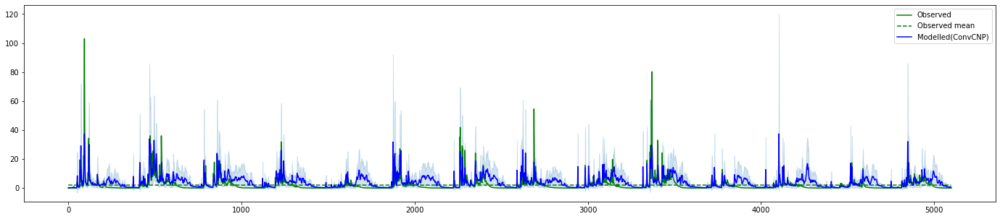

414. Basin hru_11473900 (period: 1996-2010): LL=-0.013 -- NSE=0.287 -- time=21.452


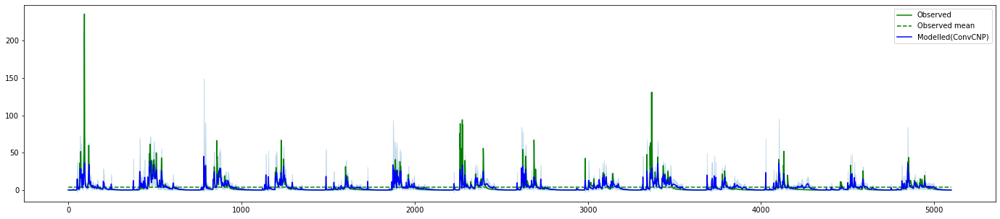

415. Basin hru_11475560 (period: 1996-2010): LL=-0.003 -- NSE=0.171 -- time=20.610


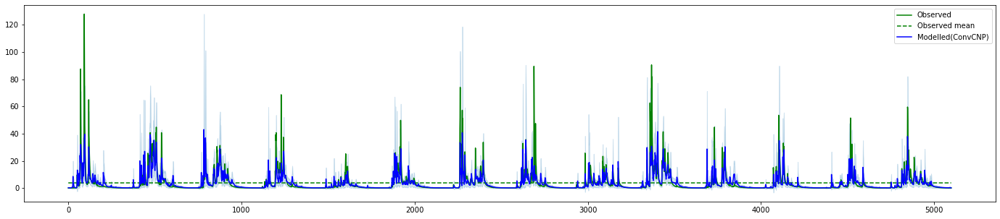

416. Basin hru_11476600 (period: 1996-2010): LL=-0.001 -- NSE=0.214 -- time=20.617


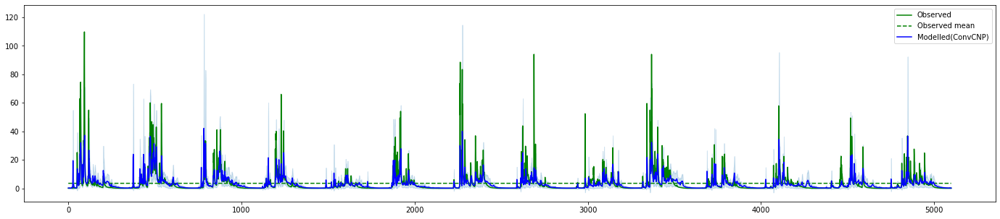

417. Basin hru_11478500 (period: 1996-2010): LL=-0.004 -- NSE=0.183 -- time=20.522


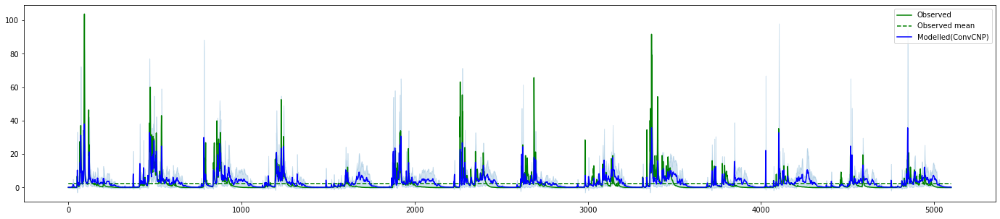

418. Basin hru_11480390 (period: 1996-2010): LL=-0.006 -- NSE=0.232 -- time=20.779


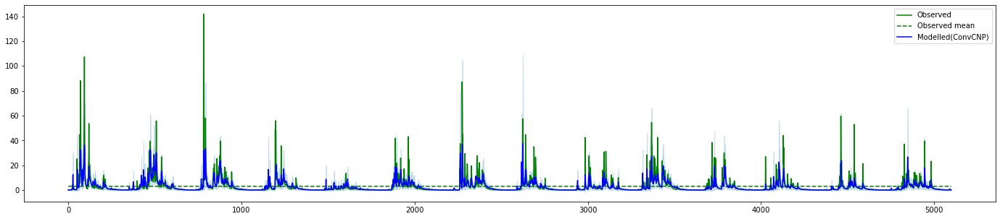

419. Basin hru_11481200 (period: 1996-2010): LL=0.004 -- NSE=0.196 -- time=20.710


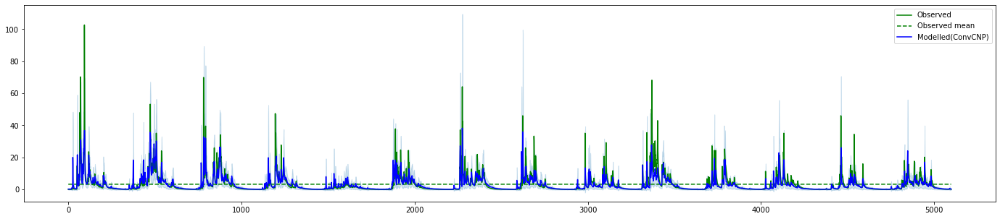

420. Basin hru_11482500 (period: 1996-2010): LL=0.003 -- NSE=0.239 -- time=20.675


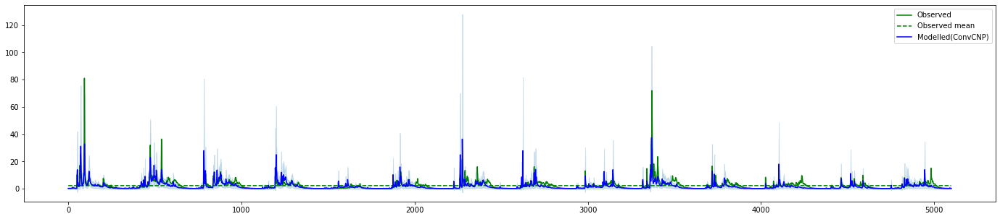

421. Basin hru_11522500 (period: 1996-2010): LL=-0.005 -- NSE=0.232 -- time=20.533


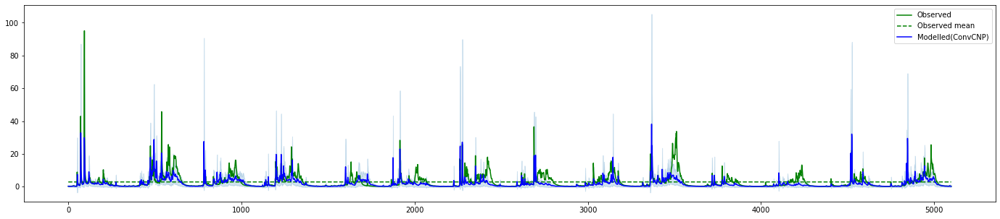

422. Basin hru_11523200 (period: 1996-2010): LL=-0.013 -- NSE=0.106 -- time=20.471


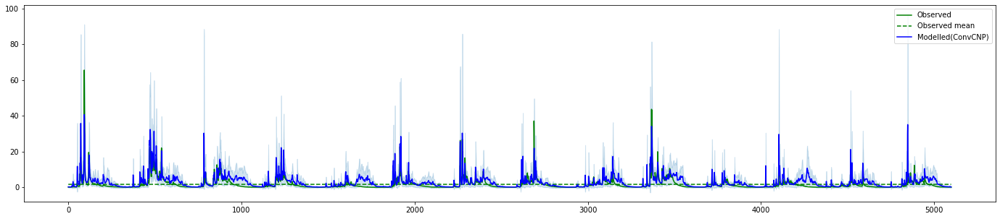

423. Basin hru_11528700 (period: 1996-2010): LL=0.001 -- NSE=0.408 -- time=20.571


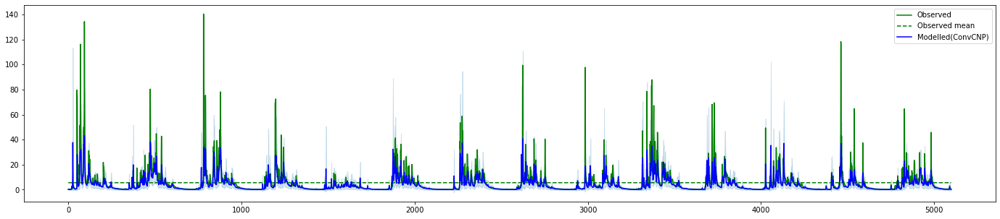

424. Basin hru_11532500 (period: 1996-2010): LL=-0.008 -- NSE=0.099 -- time=21.202


In [62]:
# Instantiate data generator for testing.
NUM_TEST_TASKS = 10
gen_365 = convcnp.data_hydro_2_extended.HydroGenerator(
                                            dataframe=df_test,
                                            df_att = df_att,
                                            batch_size = 16,
                                            num_tasks = NUM_TEST_TASKS,
                                            channels_c = context_channels,
                                            channels_t = target_channels,
                                            channels_att = attributes,
                                            channels_t_val = target_val_channel,
                                            context_mask = context_mask,
                                            target_mask = target_mask,
                                            concat_static_features = concat_static_features,
                                            extrapolate = True,
                                            timeslice = 365,
                                            min_train_points=364,
                                            min_test_points=1,
                                            max_train_points=364,
                                            max_test_points=1,
                                            device='cpu')

out = np.array([])
out_2 = np.array([])

# Compute average task log-likelihood.
basins = df_test['hru08'].unique().tolist()
print(len(basins))
b=0
for basin in basins[:]:
    
    b+=1
    
    ravg = RunningAverage()
    ravg_nse = RunningAverage()
    model.eval()
    start = time.time()
    
    pred_mu = np.array([])
    pred_mu2 = np.array([])
    pred_sigma = np.array([])
    pred_loc = np.array([])
    pred_scale = np.array([])
    observations = np.array([])
    DOY = np.array([])
    YR = np.array([])
    HRU = np.array([])
    
    alpha_nse = np.array([])
    beta_nse = np.array([])
    nse_index = np.array([])
    fhv = np.array([])
    flv = np.array([])
    fms = np.array([])
    
    with torch.no_grad():    
        years = df_test['YR'][df_test['hru08']==basin].unique().tolist()
        years = sorted(years)[1:]
        
        """duration = 1
        y = np.random.randint(len(years)-duration)
        years = years[y:y+duration]"""
        
        testtime_dataloader = DataLoader(dataset=HydroTestDataset(gen_365,years=years,basin=basin),
                                         batch_size=1, num_workers=16, pin_memory=True)
        
        for step, task in enumerate(testtime_dataloader):
            
            torch.cuda.empty_cache()
            
            task = loaded_task(task,device='cpu')
            
            year=years[step]
        
        #for year in years[:]:
        #    task = gen_365.generate_test_task(year,basin)
            
            chunk_size = 50
            chunks = np.arange(0, task['x_context'].shape[0],chunk_size)
            
            #minitask = task.copy()
            #minitask = loaded_task(minitask)
            
            for i in range(len(chunks)):
                
                torch.cuda.empty_cache()
                                
                if i+1 == len(chunks):
                    s = chunks[i]
                    e = task['x'].shape[0]
                else:
                    s = chunks[i]
                    e = chunks[i+1]

                minitask = {}
                for k,v in task.items():
                    minitask[k] = task[k][s:e]
                
                minitask = loaded_task(minitask)
                
                minibatch_size = minitask['x_context'].shape[0]
                
                y_mean, y_std = model(minitask['x_context'], minitask['y_context'], 
                                      minitask['x_target'],minitask['y_att'], 
                                      minitask['feature'],minitask['m'],
                                      static_masking_rate=0,
                                      embedding=feature_embedding_flag)
                                
                if dist == 'gaussian':
                    obj = -gaussian_logpdf(minitask['y_target'], y_mean, y_std, 'batched_mean')
                elif dist == 'gamma':
                    obj = -gamma_logpdf(minitask['y_target'], y_mean, y_std, 'batched_mean')
                
                #y_mu, y_sigma = rev_lognormal(to_numpy(y_mean), to_numpy(y_std))
                
                if dist == 'gamma':
                    y_loc = y_mean
                    y_scale = y_std
                    g_mean = torch.distributions.gamma.Gamma(y_mean, y_std).mean
                    g_var = torch.distributions.gamma.Gamma(y_mean, y_std).variance
                    y_mean = g_mean
                    y_std = torch.sqrt(g_var)
                

                ravg.update(obj.item() / minibatch_size, minibatch_size)
                
                observed = rev_transform(to_numpy(minitask['y_target']))
                
                observations = np.append(observations, observed)
                pred_mu = np.append(pred_mu, to_numpy(y_mean))
                pred_sigma = np.append(pred_sigma, to_numpy(y_std))
                
                if dist=='gamma':
                    pred_loc = np.append(pred_loc, to_numpy(y_loc))
                    pred_scale = np.append(pred_scale, to_numpy(y_scale))
                    
                #DOY = np.append(DOY, np.arange(s+1,e+1))
                DOY = np.append(DOY, np.arange(1,minibatch_size+1))
                YR = np.append(YR, np.ones(minibatch_size)*year)
                HRU = np.append(HRU, np.array([basin] * minibatch_size))
                
            #print(f'{step}, {basin}, {year}')
                
        alpha_nse = np.append(alpha_nse, calc_alpha_nse(observations,rev_transform(pred_mu)))
        beta_nse = np.append(beta_nse, calc_beta_nse(observations,rev_transform(pred_mu)))
        nse_index = np.append(nse_index, calc_nse(observations,rev_transform(pred_mu)))
        fhv = np.append(fhv, calc_fdc_fhv(observations,rev_transform(pred_mu)))
        flv = np.append(flv, calc_fdc_flv(observations,rev_transform(pred_mu)))
        fms = np.append(fms, calc_fdc_fms(observations,rev_transform(pred_mu)))   
            
        out_basin = np.transpose(np.vstack((HRU,YR,DOY,observations,pred_mu,pred_sigma,pred_loc,pred_scale)))
        out_basin_2 = np.transpose(np.vstack((alpha_nse,beta_nse,nse_index,fhv,flv,fms)))
        
        fig = plt.figure(figsize=(24, 5))
        
        x = np.arange(len(observations))
        
        # Plot model predictions.
        plt.plot(x,observations, label='Observed', color='green')
        plt.plot(x,np.ones(len(observations))*observations.mean(), label='Observed mean', linestyle='dashed', color='green')
        plt.plot(x,rev_transform(pred_mu), label='Modelled(ConvCNP)', color='blue')
        
        if dist=='gaussian':
            plt.fill_between(x,
                             rev_transform(pred_mu + 2 * pred_sigma),
                             rev_transform(pred_mu - 2 * pred_sigma),
                             color='tab:blue', alpha=0.2)

        elif dist=='gamma':
            p05 = scipy.stats.gamma.ppf(0.05, pred_loc, 0, 1/pred_scale)
            p95 = scipy.stats.gamma.ppf(0.95, pred_loc, 0, 1/pred_scale)
            plt.fill_between(x, rev_transform(p05), rev_transform(p95),color='tab:blue', alpha=0.2)
        
        plt.legend()
        plt.show()

        elapsed = time.time() - start        
        
        print(f'{b}. Basin {basin} (period: {years[0]}-{years[-1]}): LL=%.3f -- NSE=%.3f -- time=%.3f' % (-ravg.avg, calc_nse(observations,pred_mu), elapsed))
    
    if out.shape[0]!=0:
        out = np.vstack((out,out_basin))
        out_2 = np.vstack((out_2,out_basin_2))
    else:
        out = out_basin
        out_2 = out_basin_2

In [62]:
importlib.reload(convcnp.transformations)
from convcnp.transformations import rev_lognormal

1999

In [64]:
df_output = pd.DataFrame(out,columns=['HRU','YR','DOY','OBS_RUN','MOD_RUN_MU','MOD_RUN_SIGMA','PRED_LOC','PRED_SCALE'])
df_output_2 = pd.DataFrame(out_2, columns=['alpha_nse','beta_nse','nse_index','fhv','flv','fms'])

In [65]:
PATH = '_experiments/2020-08-02_00-31-53_k5fold-01-gamma-staticfs-after-encoder-unet'
df_output.to_csv(os.path.join(PATH,f'results_PGB_model_best_epoch_85.csv'),index=False)
df_output_2.to_csv(os.path.join(PATH,f'metrics_PGB_model_best_epoch_85.csv'),index=False)

In [66]:
"""df_output_test_both_40basins = df_output.copy()
df_output_test_both_40basins_2 = df_output_2.copy()"""

'df_output_test_both_40basins = df_output.copy()\ndf_output_test_both_40basins_2 = df_output_2.copy()'

424


/home/donal/miniconda3/lib/python3.7/site-packages/numpy/lib/histograms.py:839: RuntimeWarning: invalid value encountered in greater_equal
  keep = (tmp_a >= first_edge)
/home/donal/miniconda3/lib/python3.7/site-packages/numpy/lib/histograms.py:840: RuntimeWarning: invalid value encountered in less_equal
  keep &= (tmp_a <= last_edge)
/home/donal/miniconda3/lib/python3.7/site-packages/numpy/lib/histograms.py:839: RuntimeWarning: invalid value encountered in greater_equal
  keep = (tmp_a >= first_edge)
/home/donal/miniconda3/lib/python3.7/site-packages/numpy/lib/histograms.py:840: RuntimeWarning: invalid value encountered in less_equal
  keep &= (tmp_a <= last_edge)
/home/donal/miniconda3/lib/python3.7/site-packages/numpy/lib/histograms.py:839: RuntimeWarning: invalid value encountered in greater_equal
  keep = (tmp_a >= first_edge)
/home/donal/miniconda3/lib/python3.7/site-packages/numpy/lib/histograms.py:840: RuntimeWarning: invalid value encountered in less_equal
  keep &= (tmp_a <= 

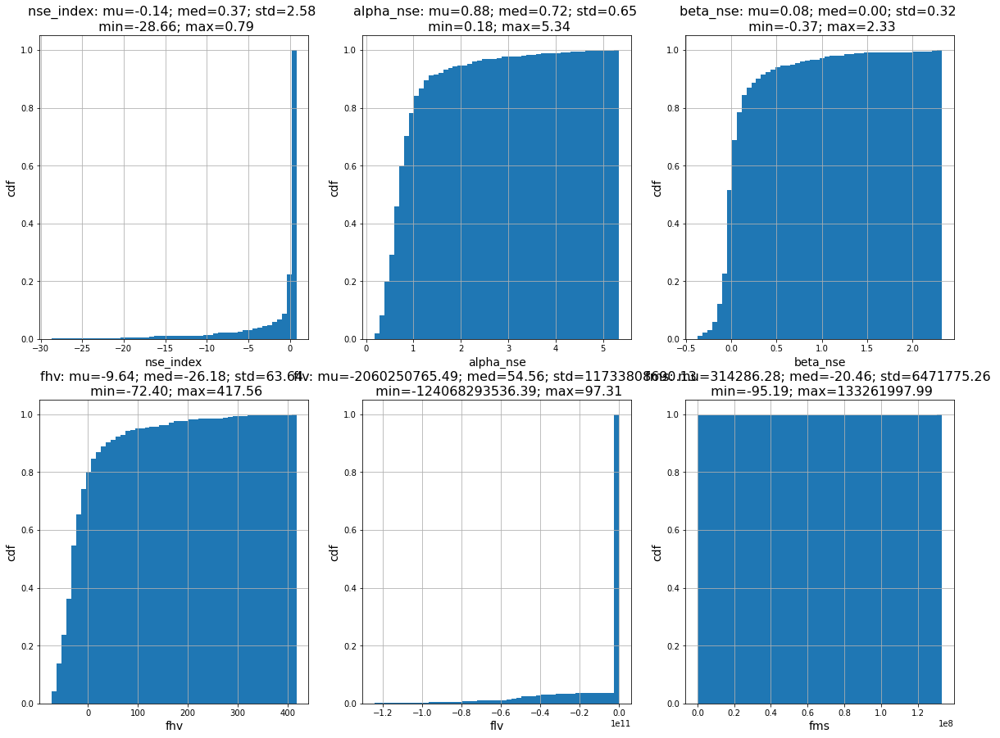

In [67]:
hrus = df_output['HRU'].unique()
nse_array = np.array([])
for hru in hrus:
    df_hru = df_output[df_output['HRU']==hru]
    obs = rev_transform(df_hru['OBS_RUN'].values.astype(np.float))
    mean_obs = np.ones(len(obs))*obs.mean()
    #print(mean_obs)
    mod = rev_transform(df_hru['MOD_RUN_MU'].values.astype(np.float))
    nse_array = np.append(nse_array, NSE.nse(obs,mean_obs,mod))

#print(f"Median NSE = {np.median(nse_array)}")
#print(f"Mean NSE = {nse_array.mean()}")
#print(f"NSE std = {nse_array.std()}")
print(len(nse_array))

list_metrics = ['nse_index','alpha_nse','beta_nse','fhv','flv','fms']

i = 0
fig = plt.figure(figsize=[20,15])
for m in list_metrics:
    i += 1
    plt.subplot(2,3,i)
    plt.hist(df_output_2[m], bins=50, density=True, 
         histtype='stepfilled',
         cumulative=True)
    plt.grid()
    
    plt.ylabel("cdf",fontsize = 14)
    plt.xlabel(m,fontsize=14)
    plt.title("%s: mu=%.2f; med=%.2f; std=%.2f \n min=%.2f; max=%.2f" % (m, df_output_2[m].mean(), df_output_2[m].median(), df_output_2[m].std(), df_output_2[m].min(), df_output_2[m].max()), fontsize=16)
    #plt.show()

In [68]:
df_output.columns

Index(['HRU', 'YR', 'DOY', 'OBS_RUN', 'MOD_RUN_MU', 'MOD_RUN_SIGMA',
       'PRED_LOC', 'PRED_SCALE'],
      dtype='object')

4194
589
3989
3961
3664
196
1656
304
3906
1428


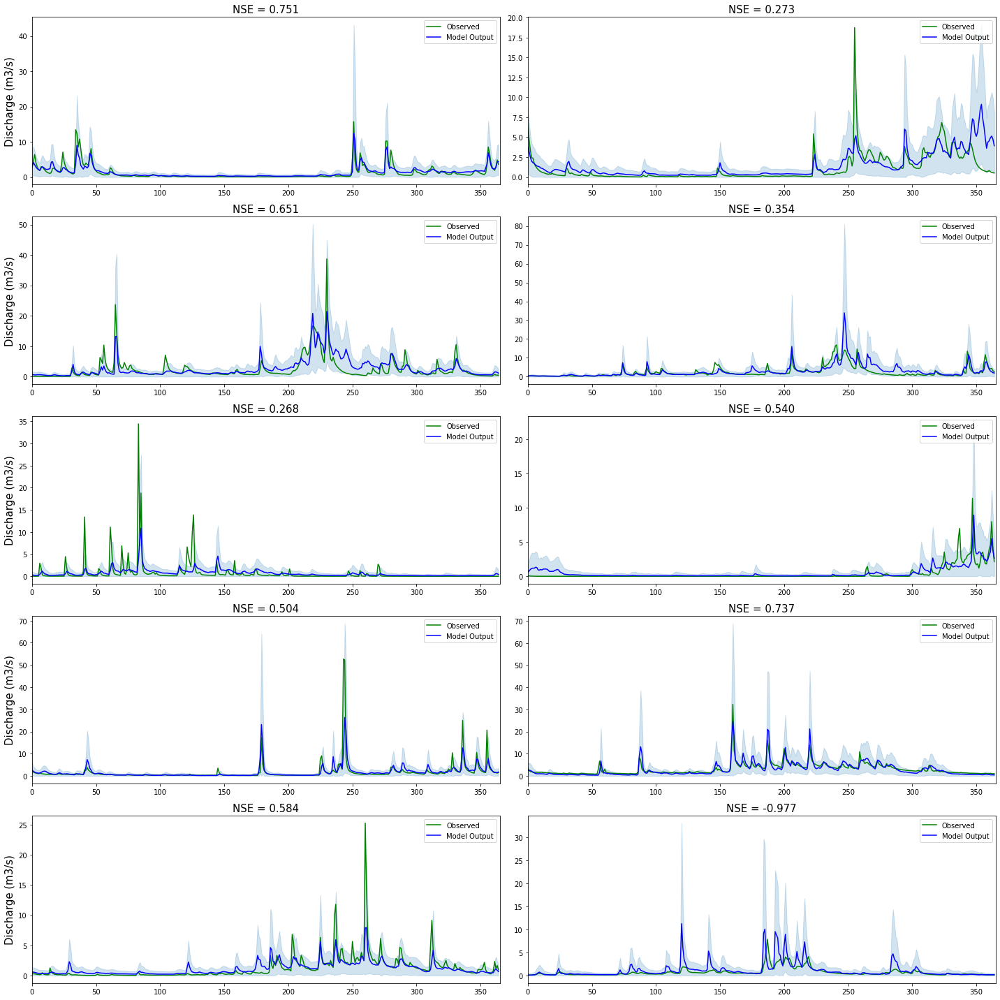

In [152]:
fig = plt.figure(figsize=[20,20])
for j in range(10):
    time_slice = 365
    x = np.arange(time_slice)
    hru_list = df_output['HRU'].unique()
    rand = np.random.randint(len(hru_list))
    hru_rand = hru_list[rand]

    i = np.random.randint(len(df_output['OBS_RUN'][df_output['HRU']==hru_rand])-time_slice)
    print(i)

    #fig = plt.figure(figsize=(24, 5))

    obs = df_output['OBS_RUN'][df_output['HRU']==hru_rand][i:i+time_slice].values.astype(np.float)
    pred_mu = df_output['MOD_RUN_MU'][df_output['HRU']==hru_rand][i:i+time_slice].values.astype(np.float)
    pred_sigma = df_output['MOD_RUN_SIGMA'][df_output['HRU']==hru_rand][i:i+time_slice].values.astype(np.float)
    doy = df_output['DOY'][df_output['HRU']==hru_rand][i:i+time_slice].values.astype(np.float)

    if dist=='gamma':
        pred_loc = df_output['PRED_LOC'][df_output['HRU']==hru_rand][i:i+time_slice].values.astype(np.float)
        pred_scale = df_output['PRED_SCALE'][df_output['HRU']==hru_rand][i:i+time_slice].values.astype(np.float)
    
    plt.subplot(5,2,j+1)
    
    # Plot model predictions.
    plt.plot(x,obs, label='Observed', color='green')
    plt.plot(x,rev_transform(pred_mu), label='Model Output', color='blue')

    show_std = True

    if show_std:
        if dist=='gaussian':
            plt.fill_between(x,
                             rev_transform(pred_mu + 2 * pred_sigma),
                             rev_transform(pred_mu - 2 * pred_sigma),
                             color='tab:blue', alpha=0.2)

        elif dist=='gamma':
            p05 = rev_transform(scipy.stats.gamma.ppf(0.05, pred_loc, 0, 1/pred_scale))
            p95 = rev_transform(scipy.stats.gamma.ppf(0.95, pred_loc, 0, 1/pred_scale))
            p05[p05<0]=0
            #pdb.set_trace()
            plt.fill_between(x,
                            p05,
                            p95,
                            color='tab:blue', alpha=0.2)

    NSE = calc_nse(obs,rev_transform(pred_mu))
    plt.title("NSE = %.3f" % NSE, fontsize = 15)
    
    plt.xlim([0,time_slice])
    if (j+2)%2==0:
        plt.ylabel('Discharge (m3/s)', fontsize=15)
    plt.legend()
    plt.tight_layout()
    #plt.show()
    
SAVE_PATH  = '/home/donal/Documents/mg963/MResProject/figures'
plt.savefig(os.path.join(SAVE_PATH,('timeseries_gamma_PGB_%s.png' % (np.random.randint(100000)))), dpi=500, bbox_inches='tight') # 6

## Test with known datanse_array

In [ ]:
import pickle
path = "test_tasks/generate_test_task_0.pkl"
a_file = open(path, "rb")
task = pickle.load(a_file)
a_file.close()

In [ ]:
import importlib
importlib.reload(convcnp.feature_mask)

In [ ]:
#import convcnp.feature_mask as mask
task = mask.task_mask(task, context_mask, target_mask)

In [ ]:
# Compute average task log-likelihood.
batch_size = task['x_context'].shape[0]
ravg = RunningAverage()
model.eval()
with torch.no_grad():
    y_mean, y_std = model(task['x_context'], task['y_context'], task['x_target'],task['f'],task['m'],embedding=feature_embedding_flag)
    obj = -gaussian_logpdf(task['y_target'], y_mean, y_std, 'batched_mean')
        
    ravg.update(obj.item() / gen_test.batch_size, gen_test.batch_size)
        
    fig = plt.figure(figsize=(24, 25))
    for i in range(5):
        plt.subplot(5, 1, i + 1)
        plot_model_task(model, task, idx=i, legend=i==2)
    plt.show()
    
elapsed = time.time() - start        
print('Model averages a log likelihood of %.3f on unseen tasks -- time: %.3f' % (-ravg.avg, elapsed))